<img src = 'téléchargement.png'>

# Projet 06 du parcours data scientist

## Classifiez automatiquement des biens de consommation 

### Objectifs 

### Plan 

### I.Mise en place 

In [1]:
pip install opencv-contrib-python

Note: you may need to restart the kernel to use updated packages.


In [2]:
!pip install imutils

In [3]:
!pip install gensim

In [4]:
!pip install transformers

In [5]:
!pip install --upgrade tensorflow_hub

In [6]:
!pip install tensorflow_text

In [7]:
!pip install wordcloud

In [142]:
!pip install pyldavis

  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
  Installing backend dependencies: started
  Installing backend dependencies: finished with status 'done'
    Preparing wheel metadata: started
    Preparing wheel metadata: finished with status 'done'
  Using cached sklearn-0.0-py2.py3-none-any.whl
  Created wheel for pyldavis: filename=pyLDAvis-3.3.1-py2.py3-none-any.whl size=136882 sha256=e2b962840a9fab291ac7e9b4ceda9a3427d44e4a7d2c169cd5a1b9271e67c2ac
  Stored in directory: c:\users\archi\appdata\local\pip\cache\wheels\57\a4\86\d10c6c2e0bf149fbc0afb0aa5a6528ac35b30a133a0270c477
Successfully built pyldavis


In [1]:
import pandas as pd
import numpy as np

import missingno as msn

import seaborn as sns

import matplotlib.pyplot as plt

import glob #recherche de chemin

import cv2

from IPython.display import Image

from nltk.tokenize import RegexpTokenizer

from wordcloud import WordCloud

from collections import Counter

from string import punctuation

import re

from nltk.tokenize import word_tokenize

from nltk.stem import WordNetLemmatizer, PorterStemmer

from nltk.tag import pos_tag

from nltk.tokenize import word_tokenize

from sklearn.model_selection import train_test_split

from sklearn import manifold, decomposition
from sklearn import cluster, metrics

import time

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

from sklearn.manifold import TSNE

from sklearn.cluster import KMeans

from sklearn.metrics import adjusted_rand_score
from sklearn.metrics import davies_bouldin_score

from string import punctuation
from nltk.corpus import stopwords

from sklearn import manifold, decomposition

from sklearn import cluster, metrics

from gensim.models import Word2Vec

import tensorflow as tf
import tensorflow.keras
from tensorflow.keras import backend as K

from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras import metrics as kmetrics
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model

# Bert
import os
import transformers
from transformers import AutoTokenizer, TFAutoModel

import tensorflow_hub as hub
import tensorflow_text 


import tensorflow as tens








import nltk

from nltk import word_tokenize  

from nltk.stem import WordNetLemmatizer

from sklearn.naive_bayes import MultinomialNB

from sklearn.metrics import accuracy_score

from sklearn.model_selection import GridSearchCV

from sklearn.svm import SVC

from sklearn.linear_model import LogisticRegression

from sklearn.decomposition import PCA

from sklearn.preprocessing import StandardScaler

from ipywidgets import IntProgress

from ipywidgets import Text

from IPython.display import display

import time

from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN

from sklearn.metrics import silhouette_score

from PIL import Image as Image_PIL

from scipy.ndimage import gaussian_filter

import imageio

import imutils

cv2.ocl.setUseOpenCL(False)

from scipy.stats import moment

%matplotlib inline

import tensorflow as tf
import tensorflow.keras
from tensorflow.keras import backend as K

from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras import metrics as kmetrics
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model
import gensim

from sklearn.preprocessing import OneHotEncoder

#from keras.preprocessing.image import load_img, img_to_array #ne fonctionne pas, remplacé par le code en-dessous
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from keras.applications.vgg16 import preprocess_input

from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import Flatten, Dense, Activation

from keras.models import clone_model

import sys

from keras.applications.vgg16 import preprocess_input
from keras.applications.vgg16 import VGG16

from sklearn.manifold import TSNE

from bokeh.plotting import figure, output_file, show, ColumnDataSource
from bokeh.models.tools import HoverTool
from bokeh.models import CategoricalColorMapper
from bokeh.transform import factor_cmap, factor_mark
from bokeh.palettes import Category20 as palette
from bokeh.transform import linear_cmap
from bokeh.models import  ColumnDataSource,Range1d, LabelSet, Label

from bokeh.io import output_notebook

from bokeh.resources import INLINE

import warnings
warnings.filterwarnings("ignore")

In [2]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\archi\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [3]:
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\archi\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [4]:
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\archi\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

### II.La donnée brute 

In [5]:
df_P6 = pd.read_csv('./datasets/flipkart_com-ecommerce_sample_1050_P6.csv')

In [6]:
df_P6.head(5)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa..."


In [7]:
print(f'Le fichier du projet P6 df_P6 contient {df_P6.shape[0]} lignes et {df_P6.shape[1]} colonnes')

Le fichier du projet P6 df_P6 contient 1050 lignes et 15 colonnes


In [8]:
df_P6.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 15 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   uniq_id                  1050 non-null   object 
 1   crawl_timestamp          1050 non-null   object 
 2   product_url              1050 non-null   object 
 3   product_name             1050 non-null   object 
 4   product_category_tree    1050 non-null   object 
 5   pid                      1050 non-null   object 
 6   retail_price             1049 non-null   float64
 7   discounted_price         1049 non-null   float64
 8   image                    1050 non-null   object 
 9   is_FK_Advantage_product  1050 non-null   bool   
 10  description              1050 non-null   object 
 11  product_rating           1050 non-null   object 
 12  overall_rating           1050 non-null   object 
 13  brand                    712 non-null    object 
 14  product_specifications  

In [9]:
df_P6.dtypes

uniq_id                     object
crawl_timestamp             object
product_url                 object
product_name                object
product_category_tree       object
pid                         object
retail_price               float64
discounted_price           float64
image                       object
is_FK_Advantage_product       bool
description                 object
product_rating              object
overall_rating              object
brand                       object
product_specifications      object
dtype: object

In [10]:
df_P6.isna().sum()

uniq_id                      0
crawl_timestamp              0
product_url                  0
product_name                 0
product_category_tree        0
pid                          0
retail_price                 1
discounted_price             1
image                        0
is_FK_Advantage_product      0
description                  0
product_rating               0
overall_rating               0
brand                      338
product_specifications       1
dtype: int64

In [11]:
df_P6.isna().mean()*100

uniq_id                     0.000000
crawl_timestamp             0.000000
product_url                 0.000000
product_name                0.000000
product_category_tree       0.000000
pid                         0.000000
retail_price                0.095238
discounted_price            0.095238
image                       0.000000
is_FK_Advantage_product     0.000000
description                 0.000000
product_rating              0.000000
overall_rating              0.000000
brand                      32.190476
product_specifications      0.095238
dtype: float64

In [12]:
df_P6.duplicated().sum()

0

In [13]:
df_P6.nunique()

uniq_id                    1050
crawl_timestamp             149
product_url                1050
product_name               1050
product_category_tree       642
pid                        1050
retail_price                354
discounted_price            424
image                      1050
is_FK_Advantage_product       2
description                1050
product_rating               27
overall_rating               27
brand                       490
product_specifications      984
dtype: int64

<AxesSubplot:>

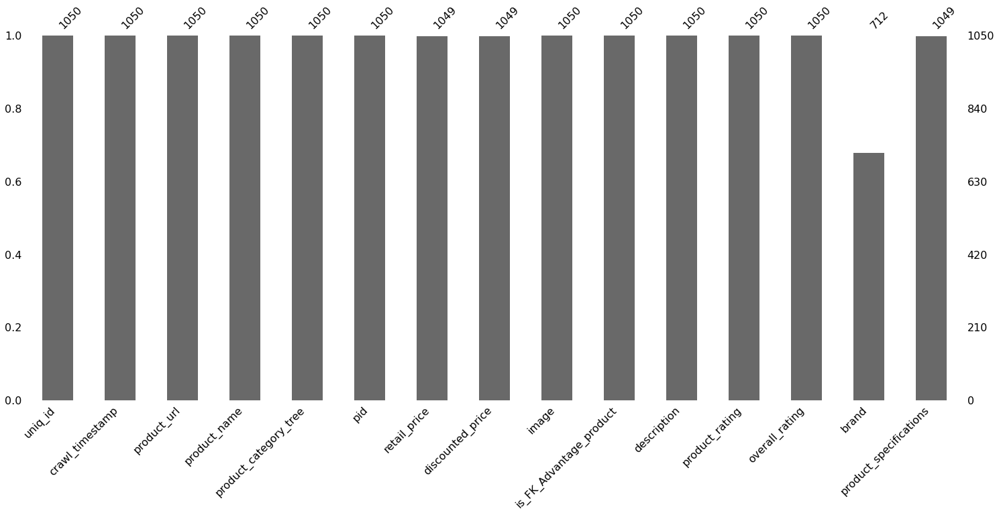

In [14]:
msn.bar(df_P6)

In [15]:
def df_structure(data):
    ''' Cette fonction affiche une synthèse des caractéristiques du dataframe df_P6'''
    
    #Comptage des colonnes numériques et catégorielles
    numeric_columns = len(data.select_dtypes(include = ['float64']).columns)
    categorical_columns= len(data.select_dtypes(include=['object','bool']).columns)

    #Création d'un dictionnaire avec les items de structure de nos données
    dict_structure = {'Nombre de lignes':data.shape[0], 'Nombre de colonnes':data.shape[1], 
                      'Nombre de variables catégorielles':categorical_columns,
                      'Nombre de variables numériques ':numeric_columns,
                      'Pourcentage de données manquantes':int((data.isnull().sum()/len(data)*100).mean()),
                      'Nombre de doublons':int(len(data[data.duplicated()])),
                      'Nombre de valeurs manquantes':data.isna().sum().sum()}

    #Transformation des éléments du dictionnaire en dataframe
    dataframe =pd.DataFrame(list(dict_structure.items()),columns = ['Caractéristiques','Valeurs'])
    return dataframe

In [16]:
df_structure(df_P6)

,Caractéristiques,Valeurs
0,Nombre de lignes,1050
1,Nombre de colonnes,15
2,Nombre de variables catégorielles,13
3,Nombre de variables numériques,2
4,Pourcentage de données manquantes,2
5,Nombre de doublons,0
6,Nombre de valeurs manquantes,341


In [17]:
df_struc_a = df_structure(df_P6)
df_struc_a.to_csv('./datasets/df_struc_a.csv', sep = ',', index = True)

In [18]:
#images_P6 = [cv2.imread(file) for file in glob.glob('./datasets/Images_P6/*.jpg')]
#Prend du temps pour etre éxecuter (environ 30s)

In [19]:
#len(images_P6)

In [20]:
#Meme principe que l'application précédente mais s'execute plus rapidement
images_P6 = [Image(file) for file in glob.glob('./datasets/Images_P6/*.jpg')]

In [21]:
len(images_P6)

1050

### III.Nettoyage catégories 

In [22]:
df_P6["description"][0]

'Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that you

In [23]:
df_P6["product_specifications"][0]

'{"product_specification"=>[{"key"=>"Brand", "value"=>"Elegance"}, {"key"=>"Designed For", "value"=>"Door"}, {"key"=>"Type", "value"=>"Eyelet"}, {"key"=>"Model Name", "value"=>"Abstract Polyester Door Curtain Set Of 2"}, {"key"=>"Model ID", "value"=>"Duster25"}, {"key"=>"Color", "value"=>"Multicolor"}, {"key"=>"Length", "value"=>"213 cm"}, {"key"=>"Number of Contents in Sales Package", "value"=>"Pack of 2"}, {"key"=>"Sales Package", "value"=>"2 Curtains"}, {"key"=>"Material", "value"=>"Polyester"}]}'

In [24]:
df_P6["product_category_tree"][0]

'["Home Furnishing >> Curtains & Accessories >> Curtains >> Elegance Polyester Multicolor Abstract Eyelet Do..."]'

In [25]:
#Vérification du nombre total de sous catégories potentiellement existantes
def cat_nb_lv(text):
    """Donne la nombre de sous catégorie dans l'arbre de catégories"""
    text_data = text.translate({ord('['): None,
                                ord(']'): None,
                                ord('"'): None})
    text_split = text_data.split('>>')
    categories_list = [cat.strip() for cat in text_split]
    
    return len(categories_list)

df_P6['category_level_total_number'] = df_P6['product_category_tree'].apply(cat_nb_lv)
print(f"Nombre minimum de sous catégories: {df_P6['category_level_total_number'].min()}"
      f" ; Nombre maximum de sous catégories: {df_P6['category_level_total_number'].max()}")

Nombre minimum de sous catégories: 2 ; Nombre maximum de sous catégories: 7


In [26]:
print(df_P6.iloc[:3,4])

0    ["Home Furnishing >> Curtains & Accessories >>...
1    ["Baby Care >> Baby Bath & Skin >> Baby Bath T...
2    ["Baby Care >> Baby Bath & Skin >> Baby Bath T...
Name: product_category_tree, dtype: object


In [27]:
#Traitement des catégories
def split_categories(category, level):
    '''Fonction qui affiche les catégories '''
    category = category.split('["')[1].split('"]')[0]
    cat = category.split(' >> ')
    if(len(cat)) < 3:
        cat = [cat[0], cat[1], 'None']
        if(len(cat))<2:
            cat = [cat[0], 'None', 'None']
    return cat[level]

def split_categories_1(category):
    return split_categories(category,0)
def split_categories_2(category):
    return split_categories(category,1)
def split_categories_3(category):
    return split_categories(category,2)

def detail_categories(dataframe):
    dataframe['cat_lvl_1'] = dataframe['product_category_tree'].apply(split_categories_1)
    dataframe['cat_lvl_2'] = dataframe['product_category_tree'].apply(split_categories_2)
    dataframe['cat_lvl_3'] = dataframe['product_category_tree'].apply(split_categories_3)
    return dataframe.drop(['product_category_tree'], axis = 1)

In [28]:
df_P6_c = detail_categories(df_P6)

In [29]:
df_P6_c.head(5)

,uniq_id,crawl_timestamp,product_url,product_name,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,category_level_total_number,cat_lvl_1,cat_lvl_2,cat_lvl_3
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v...",4,Home Furnishing,Curtains & Accessories,Curtains
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa...",5,Baby Care,Baby Bath & Skin,Baby Bath Towels
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",...",5,Baby Care,Baby Bath & Skin,Baby Bath Towels
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v...",5,Home Furnishing,Bed Linen,Bedsheets
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa...",5,Home Furnishing,Bed Linen,Bedsheets


In [30]:
df_P6_c.shape

(1050, 18)

In [31]:
df_P6_c.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 18 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   uniq_id                      1050 non-null   object 
 1   crawl_timestamp              1050 non-null   object 
 2   product_url                  1050 non-null   object 
 3   product_name                 1050 non-null   object 
 4   pid                          1050 non-null   object 
 5   retail_price                 1049 non-null   float64
 6   discounted_price             1049 non-null   float64
 7   image                        1050 non-null   object 
 8   is_FK_Advantage_product      1050 non-null   bool   
 9   description                  1050 non-null   object 
 10  product_rating               1050 non-null   object 
 11  overall_rating               1050 non-null   object 
 12  brand                        712 non-null    object 
 13  product_specificat

In [32]:
df_P6_c.isna().sum()

uniq_id                          0
crawl_timestamp                  0
product_url                      0
product_name                     0
pid                              0
retail_price                     1
discounted_price                 1
image                            0
is_FK_Advantage_product          0
description                      0
product_rating                   0
overall_rating                   0
brand                          338
product_specifications           1
category_level_total_number      0
cat_lvl_1                        0
cat_lvl_2                        0
cat_lvl_3                        0
dtype: int64

In [33]:
df_P6_c.duplicated().sum()

0

In [34]:
df_P6_c.nunique()

uniq_id                        1050
crawl_timestamp                 149
product_url                    1050
product_name                   1050
pid                            1050
retail_price                    354
discounted_price                424
image                          1050
is_FK_Advantage_product           2
description                    1050
product_rating                   27
overall_rating                   27
brand                           490
product_specifications          984
category_level_total_number       6
cat_lvl_1                         7
cat_lvl_2                        62
cat_lvl_3                       242
dtype: int64

<AxesSubplot:>

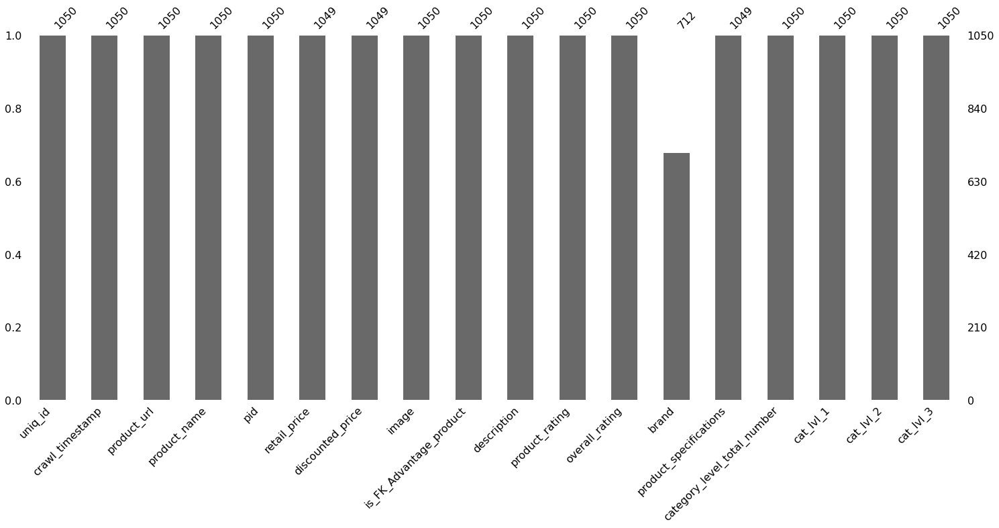

In [35]:
msn.bar(df_P6_c)

In [36]:
df_structure(df_P6_c)

,Caractéristiques,Valeurs
0,Nombre de lignes,1050
1,Nombre de colonnes,18
2,Nombre de variables catégorielles,15
3,Nombre de variables numériques,2
4,Pourcentage de données manquantes,1
5,Nombre de doublons,0
6,Nombre de valeurs manquantes,341


In [37]:
df_struc_b = df_structure(df_P6_c)
df_struc_b.to_csv('./datasets/df_struc_b.csv', sep = ',', index = True)

In [38]:
#Nombre d'objets (items) par sous catégorie (sous catégorie 1 ou catégorie inférieur de niveau 1)
df_P6_c.groupby('cat_lvl_1').count()['uniq_id'].sort_values(ascending = False)

cat_lvl_1
Baby Care                     150
Beauty and Personal Care      150
Computers                     150
Home Decor & Festive Needs    150
Home Furnishing               150
Kitchen & Dining              150
Watches                       150
Name: uniq_id, dtype: int64

In [39]:
#Nombre d'objets (items) par sous catégorie (sous catégorie 2 ou catégorie inférieur de niveau 2)
df_P6_c.groupby('cat_lvl_2').count()['uniq_id'].sort_values(ascending = False)

cat_lvl_2
Wrist Watches                149
Laptop Accessories            87
Infant Wear                   84
Coffee Mugs                   74
Showpieces                    71
                            ... 
Dinnerware & Crockery          1
Men's Grooming                 1
Beauty Accessories             1
Kripa's Home Furnishing        1
Consumables & Disposables      1
Name: uniq_id, Length: 62, dtype: int64

In [40]:
#Nombre d'objets (items) par sous catégorie (sous catégorie 3 ou catégorie inférieur de niveau 3)
df_P6_c.groupby('cat_lvl_3').count()['uniq_id'].sort_values(ascending = False)

cat_lvl_3
Deodorants                   65
Blankets, Quilts & Dohars    57
Baby Girls' Clothes          49
Routers                      49
USB Gadgets                  38
                             ..
Makeup Accessories            1
Malhar Showpieces             1
Mars Combos and Kits          1
Marvel Wrist Watches          1
posterchacha Coffee Mugs      1
Name: uniq_id, Length: 242, dtype: int64

In [41]:
print("Nombre de produits dans la sous-catégorie 1 :{}".format(len(df_P6["cat_lvl_1"].unique())))
print("Nombre de produits dans la sous-catégorie 2 :{}".format(len(df_P6["cat_lvl_2"].unique())))
print("Nombre de produits dans la sous-catégorie 3 :{}".format(len(df_P6["cat_lvl_3"].unique())))

Nombre de produits dans la sous-catégorie 1 :7
Nombre de produits dans la sous-catégorie 2 :62
Nombre de produits dans la sous-catégorie 3 :242


In [42]:
df_P6_c.to_csv('./datasets/data_saved_data_categories.csv',sep = ',', index = True)

In [43]:
#Identification des catégories les moins représentées
occurence_cat = pd.DataFrame(df_P6_c['cat_lvl_2'].value_counts())

In [44]:
occurence_cat.head()

,cat_lvl_2
Wrist Watches,149
Laptop Accessories,87
Infant Wear,84
Coffee Mugs,74
Showpieces,71


In [45]:
#identification des catégories pour lesquelles nous avons le moins d'occurence
cat_to_fill = occurence_cat[occurence_cat['cat_lvl_2'] < 10]

In [46]:
cat_to_fill.head(5)

,cat_lvl_2
Hair Care,9
Feeding & Nursing,8
Bar & Glassware,8
Bath and Spa,7
Health Care,7


In [47]:
cat_to_fill.sample(5)

,cat_lvl_2
Laptops,2
JMD Home Furnishing,1
Feeding & Nursing,8
Women's Hygiene,1
TRUE Home Decor & Festive Needs,1


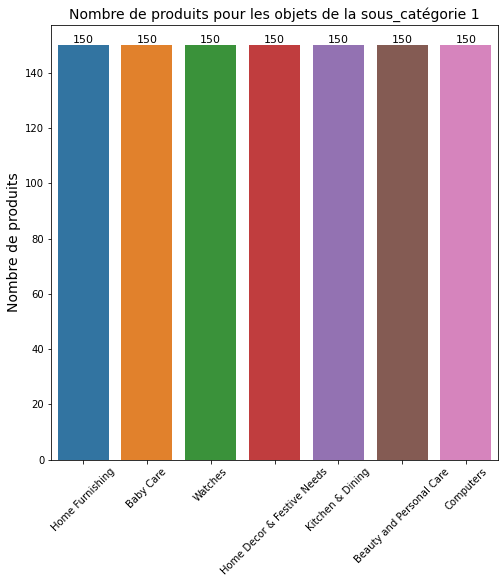

In [48]:
#Comptage du nombre d'objets pour de la sous catégorie 1
plt.figure(figsize = (8, 8))
    
plt.xticks(rotation = 45)

val = df_P6["cat_lvl_1"].value_counts()
val = pd.DataFrame(val)

sns.barplot(x = val.index, y = val["cat_lvl_1"])

plt.ylabel("Nombre de produits", size = 14)
plt.title('Nombre de produits pour les objets de la sous_catégorie 1', size = 14)

for i, v in enumerate(val["cat_lvl_1"].values):
    plt.text(i, v+1, v, color = 'black', ha = 'center', size = 11)

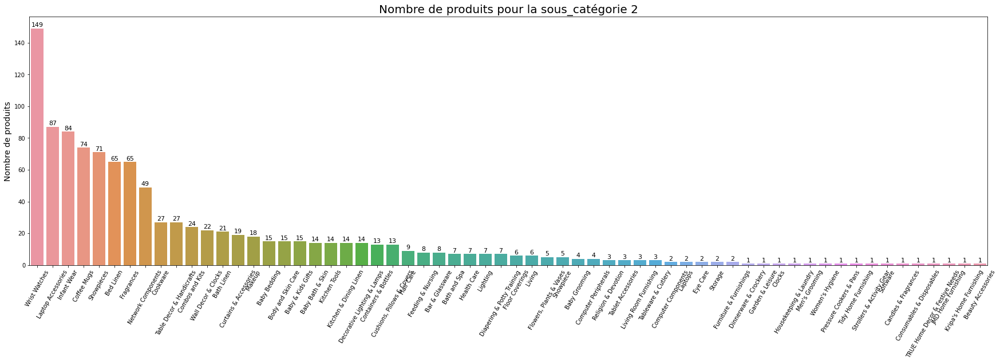

In [49]:
#Comptage de la sous catégorie 2
plt.figure(figsize = (30, 8))
    
plt.xticks(rotation = 60)

val = df_P6["cat_lvl_2"].value_counts()
val = pd.DataFrame(val)

sns.barplot(x = val.index, y = val["cat_lvl_2"])

plt.ylabel("Nombre de produits", size = 14)
plt.title("Nombre de produits pour la sous_catégorie 2", size = 20)

for i, v in enumerate(val["cat_lvl_2"].values):
    plt.text(i, v+1, v, color = 'black', ha = 'center', size = 11)

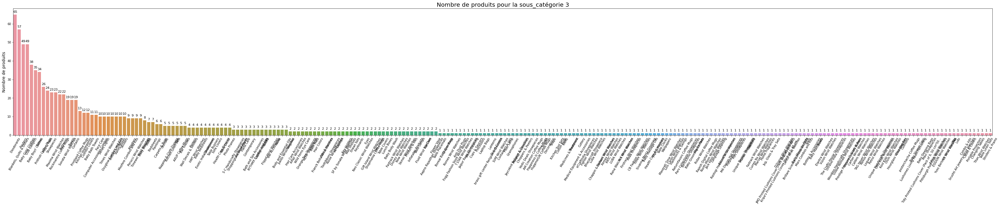

In [50]:
#Comptage de la sous catégorie 3
plt.figure(figsize = (60, 8))
    
plt.xticks(rotation = 60)

val = df_P6["cat_lvl_3"].value_counts()
val = pd.DataFrame(val)

sns.barplot(x = val.index, y = val["cat_lvl_3"])

plt.ylabel("Nombre de produits", size = 14)
plt.title("Nombre de produits pour la sous_catégorie 3", size = 20)

for i, v in enumerate(val["cat_lvl_3"].values):
    plt.text(i, v+1, v, color = 'black', ha = 'center', size = 11)

In [51]:
#Assemblage de l'ensemble des descriptions dans une variable string
all_des = ' '.join([text for text in df_P6["description"]])

#Ce "tokenizer" ne capture que les mots capitalisés
capword_tokenizer = RegexpTokenizer("[A-Z]\w+")
all_des_tokened = capword_tokenizer.tokenize(all_des)

display("Nombre de mots au total dans les descriptions de produits:", len(all_des_tokened))

'Nombre de mots au total dans les descriptions de produits:'

41803

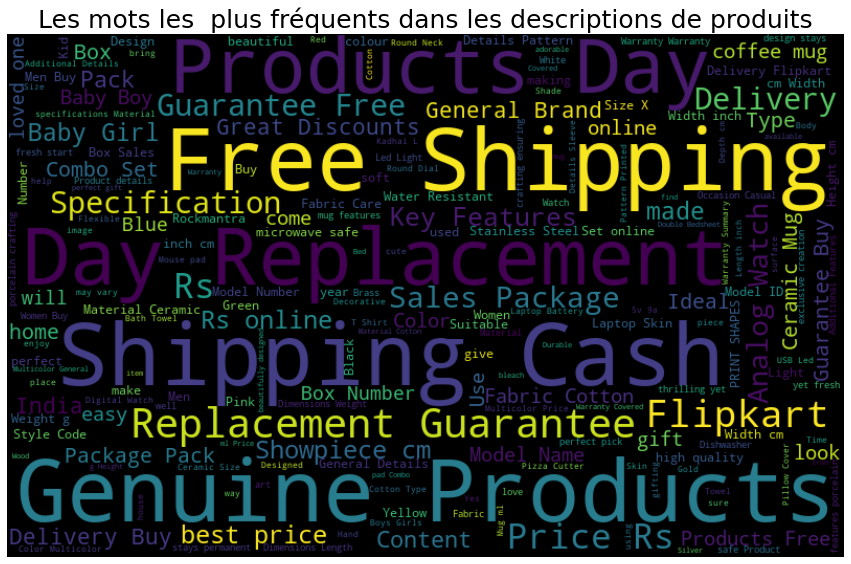

In [52]:
#Les mots les plus fréquents dans les descriptions
wordcloud = WordCloud(width = 800, height = 500, random_state = 21, max_font_size = 110).generate(all_des)

plt.figure(figsize = (15, 12))
plt.imshow(wordcloud, interpolation = "bilinear")
plt.title("Les mots les  plus fréquents dans les descriptions de produits", size = 25)
plt.axis('off')
plt.show()

In [53]:
df_P6["cat_lvl_2"] = df_P6["cat_lvl_2"].str.strip()
des = df_P6[df_P6["cat_lvl_2"] == "Wrist Watches"]

#Nous récupèrons toutes les descriptions de la catégorie et nous formons une chaîne de caractères
des_text = ' '.join(text for text in des["description"])

#Nous faisons une tokenisation de cette chaine avec le tokenizer construit précédemment et nous ne gardons que les mots capitalisés
des_text_tokenized = capword_tokenizer.tokenize(des_text)

# On recrée une chaîne "propre"
des_text_tokenized = ' '.join(des_text_tokenized)

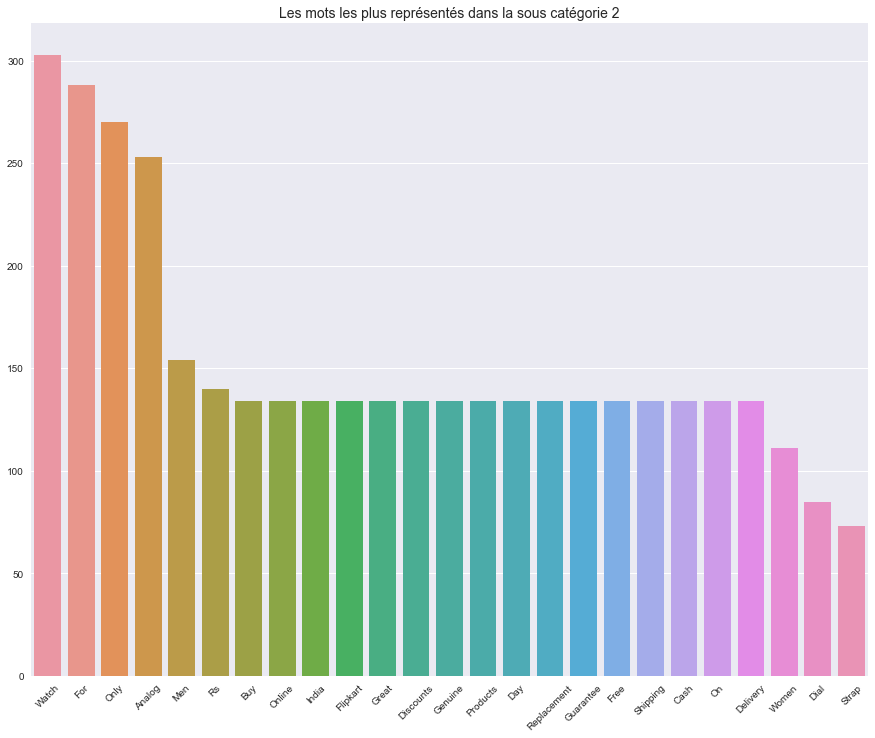

In [54]:
des_list = des_text_tokenized.split()
des_counts = Counter(des_list)
des_common_words = [word[0] for word in des_counts.most_common(25)]
des_common_counts = [word[1] for word in des_counts.most_common(25)]

plt.style.use('seaborn')
plt.figure(figsize = (15, 12))
plt.xticks(rotation = 45)
sns.barplot(x = des_common_words, y = des_common_counts)
plt.title("Les mots les plus représentés dans la sous catégorie 2", size = 14)
plt.show()

### IV.Préparation des données

In [55]:
train, test = train_test_split(df_P6_c.sample(100, random_state = 42), test_size = 0.25, random_state = 42)
train, test = train_test_split(df_P6_c, test_size = 0.25, random_state = 42)

In [56]:
train.to_csv('./datasets/data_saved_train.csv')
test.to_csv('./datasets/data_saved_test.csv')

In [57]:
train.head(5)

,uniq_id,crawl_timestamp,product_url,product_name,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,category_level_total_number,cat_lvl_1,cat_lvl_2,cat_lvl_3
165,785b4383b12106dd172306d427d8f7b2,2015-12-01 12:40:44 +0000,http://www.flipkart.com/rockmantra-cute-two-ca...,Rockmantra Cute Two Cats Ceramic Mug,MUGEAGGKFBTYPN4Z,499.0,349.0,785b4383b12106dd172306d427d8f7b2.jpg,False,Rockmantra Cute Two Cats Ceramic Mug (5.5 l)\r...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Type"", ""va...",3,Kitchen & Dining,Coffee Mugs,Rockmantra Coffee Mugs
248,45d0af2c709de47268c80c35a117de44,2015-12-01 12:40:44 +0000,http://www.flipkart.com/malhar-niko-male-doll-...,Malhar Niko Male Doll Showpiece - 25 cm,SHIEY382SR75SXEY,6395.0,5436.0,45d0af2c709de47268c80c35a117de44.jpg,True,Buy Malhar Niko Male Doll Showpiece - 25 cm ...,No rating available,No rating available,Malhar,"{""product_specification""=>[{""key""=>""Brand"", ""v...",3,Home Decor & Festive Needs,Showpieces,Malhar Showpieces
310,64b463dc0b75ae40a848498c657041e6,2015-12-01 06:13:00 +0000,http://www.flipkart.com/linksys-smart-wi-fi-ro...,Linksys Smart Wi-Fi Router,RTRDZTF9DBT4CW8U,14999.0,13500.0,64b463dc0b75ae40a848498c657041e6.jpg,True,Buy Linksys Smart Wi-Fi Router only for Rs. 0....,No rating available,No rating available,Linksys,"{""product_specification""=>[{""key""=>""Encryption...",4,Computers,Network Components,Routers
685,6b5cdfe68595fbcab0e05dc625d3d66a,2015-12-31 09:19:31 +0000,http://www.flipkart.com/richfeel-sunshield-spf...,Richfeel Sunshield - SPF 30 PA++,SNRE4F2GBWVF6UKR,299.0,224.0,6b5cdfe68595fbcab0e05dc625d3d66a.jpg,False,Flipkart.com: Buy Richfeel Sunshield - SPF 30 ...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Quantity"",...",5,Beauty and Personal Care,Body and Skin Care,Face Care
843,e86daf9ebcdfc5c5dd088cdb7f8f8db6,2015-12-29 05:07:38 +0000,http://www.flipkart.com/epresent-mfan-1-fan-us...,Epresent Mfan 1 Fan USB USB Fan,USGEB3HTYWCYT2HY,269.0,219.0,e86daf9ebcdfc5c5dd088cdb7f8f8db6.jpg,False,Buy Epresent Mfan 1 Fan USB USB Fan for Rs.219...,No rating available,No rating available,Epresent,"{""product_specification""=>[{""key""=>""Brand"", ""v...",4,Computers,Laptop Accessories,USB Gadgets


In [58]:
test.head(5)

,uniq_id,crawl_timestamp,product_url,product_name,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,category_level_total_number,cat_lvl_1,cat_lvl_2,cat_lvl_3
352,833a87b0af3b84fe246d2ebf271af177,2015-12-01 06:13:00 +0000,http://www.flipkart.com/zyxel-pla-4205/p/itmdy...,Zyxel PLA-4205,RTRDYZYDXGHXXJNZ,10999.0,8100.0,833a87b0af3b84fe246d2ebf271af177.jpg,False,Buy Zyxel PLA-4205 only for Rs. 8100 from Flip...,No rating available,No rating available,Zyxel,"{""product_specification""=>[{""key""=>""In The Box...",4,Computers,Network Components,Routers
689,55195de3873fffaa9e37b041533d7305,2015-12-31 09:19:31 +0000,http://www.flipkart.com/philips-9-5-w-led-b22-...,Philips 9.5 W LED B22 3000K A55 IND Bulb,BLBEF3HEKYURWHKG,699.0,419.0,55195de3873fffaa9e37b041533d7305.jpg,False,Buy Philips 9.5 W LED B22 3000K A55 IND Bulb f...,No rating available,No rating available,Philips,"{""product_specification""=>[{""key""=>""Brand"", ""v...",4,Kitchen & Dining,Lighting,Bulbs
485,44b963eb856b4831dfdd21b666593c95,2016-01-07 05:50:25 +0000,http://www.flipkart.com/lapguard-lenovo-ideapa...,Lapguard Lenovo IdeaPad V470 6 Cell Laptop Bat...,ACCDVPGKY3GBDB5P,3999.0,1799.0,44b963eb856b4831dfdd21b666593c95.jpg,False,Lapguard Lenovo IdeaPad V470 6 Cell Laptop Bat...,2,2,Lapguard,"{""product_specification""=>[{""key""=>""In The Box...",4,Computers,Laptop Accessories,Batteries
388,98ad5b99ad96695568d8f143b11ab740,2015-12-01 06:13:00 +0000,http://www.flipkart.com/anna-andre-paris-set-d...,Anna Andre Paris Set of Dark Fire & Numero 1 D...,CAGEYUXVZSFVZRHE,355.0,310.0,98ad5b99ad96695568d8f143b11ab740.jpg,False,Flipkart.com: Buy Anna Andre Paris Set of Dark...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Number of ...",5,Beauty and Personal Care,Fragrances,Deodorants
31,29b1ca231e10d5269516b80bf9d0dffc,2015-12-04 07:25:36 +0000,http://www.flipkart.com/lenco-bdblue-tango-ana...,"Lenco Bdblue Tango Analog Watch - For Men, Boys",WATEB2FZUMQU4W7R,1499.0,599.0,29b1ca231e10d5269516b80bf9d0dffc.jpg,False,"Lenco Bdblue Tango Analog Watch - For Men, Bo...",No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Chronograp...",3,Watches,Wrist Watches,Lenco Wrist Watches


In [59]:
pd.read_csv('./datasets/flipkart_com-ecommerce_sample_1050_P6.csv').iloc[165]

uniq_id                                     785b4383b12106dd172306d427d8f7b2
crawl_timestamp                                    2015-12-01 12:40:44 +0000
product_url                http://www.flipkart.com/rockmantra-cute-two-ca...
product_name                            Rockmantra Cute Two Cats Ceramic Mug
product_category_tree      ["Kitchen & Dining >> Coffee Mugs >> Rockmantr...
pid                                                         MUGEAGGKFBTYPN4Z
retail_price                                                           499.0
discounted_price                                                       349.0
image                                   785b4383b12106dd172306d427d8f7b2.jpg
is_FK_Advantage_product                                                False
description                Rockmantra Cute Two Cats Ceramic Mug (5.5 l)\r...
product_rating                                           No rating available
overall_rating                                           No rating available

### V.Données textuelles 

### V.1.Préprocessing 

In [60]:
#Texte sans ponctuations et déscriptions
lower_list = []
for row in range(df_P6_c['description'].size):
    text = df_P6_c['description'][row]
    lowers = text.lower()
    nopunc_table = str.maketrans('', '', punctuation)
    text_nopunc = lowers.translate(nopunc_table)
    lower_list.append(text_nopunc)
df_P6_c['lower_description'] = lower_list

In [61]:
#Texte sans ponctuations et déscriptions
lower_list = []
for row in range(df_P6_c['product_name'].size):
    text = df_P6_c['product_name'][row]
    lowers = text.lower()
    nopunc_table = str.maketrans('', '', punctuation)
    text_nopunc = lowers.translate(nopunc_table)
    lower_list.append(text_nopunc)
df_P6_c['lower_product_name'] = lower_list

In [62]:
#Fonction de préprocessing
def preprocess(text):
    """Fonction de préprocessing"""
    import re
    from nltk.tokenize import word_tokenize
    from nltk.stem import WordNetLemmatizer, PorterStemmer
    
    #Eliminer tous les charactères spéciaux
    document = re.sub(r'\W', ' ', str(text))

    #Normalisation des tabs et elimination de nouvelles lignes
    no_tabs = str(document).replace('\t', ' ').replace('\n', '');

    #Eliminer tous les charactères sauf A-Z et le point.
    alphas_only = re.sub("[^a-zA-Z]", " ", no_tabs);

    #Normaliser l'espace à 1
    multi_spaces = re.sub(" +", " ", alphas_only);
    
    #Bande et espace de tete
    no_spaces = multi_spaces.strip();

    #Normaliser tous les charactères et passage aux lettres miniscules
    clean_text = no_spaces.lower();

    #Tokenization
    tokens = word_tokenize(clean_text)
    
    #Lematization
    wl = WordNetLemmatizer()
    lemed = [wl.lemmatize(word) for word in tokens]
    #lemed = [word for word in tokens]
    
    #Eliminer les mots avec moins de trois charactères
    lemed_1 = [word for word in lemed if len(word)>2]
    
    #Eliminer les stopwords
    from sklearn.feature_extraction import text
    
    new_words = ['pack', 'package', 'flipkart', 'com',
                 'shipping', 'delivery', 'specification',
                 'day', 'free', 'cash', 'discount', 'price',
                 'replacement', 'feature', 'sale', 'guarantee']
    my_stop_words = text.ENGLISH_STOP_WORDS.union(new_words)
    filtered_sentence = [w for w in lemed_1 if w not in my_stop_words]

    return filtered_sentence

In [63]:
#Création de colonnes de préprocessing
#Premier filtrage des mots
df_P6_c['description_preprocess_1'] = df_P6_c['description'].apply(preprocess)
df_P6_c['product_name_preprocess_1'] = df_P6_c['product_name'].apply(preprocess)

#Dexième filtrage des mots (postag)
df_P6_c['description_preprocess_2'] = df_P6_c['description_preprocess_1'].apply(lambda x: [word for word,tag in pos_tag(x)
                                                                                               if ((tag=='NN')|(tag=='JJ'))])
df_P6_c['product_name_preprocess_2'] = df_P6_c['product_name_preprocess_1'].apply(lambda x: [word for word,tag in pos_tag(x)
                                                                                               if ((tag=='NN')|(tag=='JJ'))])
#Remise en place des list mots en string sans postag
df_P6_c['description_preprocess_3'] = df_P6_c['description_preprocess_1'].apply(' '.join)
df_P6_c['product_name_preprocess_3'] = df_P6_c['product_name_preprocess_1'].apply(' '.join)

#Remise en place des list mots en string avec postag
df_P6_c['description_preprocess_4'] = df_P6_c['description_preprocess_2'].apply(' '.join)
df_P6_c['product_name_preprocess_4'] = df_P6_c['product_name_preprocess_2'].apply(' '.join)

In [64]:
X = df_P6_c['description'].apply(lambda x: len(x))
y = [i for i, j in enumerate(X) if j == min(X)]
y

[877, 890]

In [65]:
x = 890
print(f"{df_P6_c['description'][x]} ------- {df_P6_c['description_preprocess_4'][x]}")

Buy IWS Cotton Bath Towel at Rs. 299 at Flipkart.com. Only Genuine Products. Free Shipping. Cash On Delivery! ------- cotton bath towel genuine product


In [66]:
#Fonction ajout de n fois produc_name
def add_n_name(n = 3, dfname = df_P6_c['product_name_preprocess_4'], df = df_P6_c['description_preprocess_4']):
    """Fonction d'ajout de product_name n fois'"""
    dfnameb = dfname + ' '
    df_final = n*dfnameb + df
    
    return df_final

### V.2.Traitement

In [67]:
train[['description']].sample(5)

,description
1047,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...
819,Buy Raymond Abstract Single Blanket Purple at ...
93,Buy Exotic India Relaxing Ganesha Showpiece -...
844,Buy Task Logistics Audio Receiver H-366 USB Bl...
757,SVM Navratri Special 7 Analog Watch - For Gir...


### V.2.1.Bag of words simple(BoW)

In [68]:
l_cat = list(set(df_P6_c['cat_lvl_2']))
print("catégories : ", l_cat)
y_cat_num = [(1-l_cat.index(df_P6_c.iloc[i]['cat_lvl_2'])) for i in range(len(df_P6_c))]

catégories :  ['Beauty Accessories', 'Showpieces', "Men's Grooming", 'Baby Bedding', 'Tablet Accessories', 'Containers & Bottles', 'Living', 'Clocks', 'Infant Wear', 'Feeding & Nursing', 'Computer Peripherals', 'Baby Bath & Skin', 'Floor Coverings', 'Living Room Furnishing', 'Dinnerware & Crockery', 'Combos and Kits', 'Cushions, Pillows & Covers', 'Body and Skin Care', 'Curtains & Accessories', 'Housekeeping & Laundry', 'Lighting', 'Laptop Accessories', 'Kitchen & Dining Linen', 'Baby & Kids Gifts', 'Flowers, Plants & Vases', 'Tableware & Cutlery', 'Computer Components', 'Storage', 'Makeup', 'Garden & Leisure', 'Decorative Lighting & Lamps', 'Diapering & Potty Training', 'Laptops', "Kripa's Home Furnishing", 'Candles & Fragrances', 'Software', 'Strollers & Activity Gear', 'Eye Care', 'Wrist Watches', 'Bath and Spa', 'Table Decor & Handicrafts', 'Hair Care', 'Religion & Devotion', 'JMD Home Furnishing', 'Pressure Cookers & Pans', 'Consumables & Disposables', 'Kitchen Tools', 'Furniture 

In [69]:
#Calcul Tsne, détermination des clusters et calcul ARI entre vrais catégorie et nombre de groupes (clusters)
def ARI_fct(features) :
    time1 = time.time()
    num_labels=len(l_cat)
    tsne = manifold.TSNE(n_components=2, perplexity=30, n_iter=2000, 
                                 init='random', learning_rate=200, random_state=42)
    X_tsne = tsne.fit_transform(features)
    
    # Détermination des clusters à partir des données après Tsne 
    cls = cluster.KMeans(n_clusters=num_labels, n_init=100, random_state=42)
    cls.fit(X_tsne)
    ARI = np.round(metrics.adjusted_rand_score(y_cat_num, cls.labels_),4)
    time2 = np.round(time.time() - time1,0)
    print("ARI : ", ARI, "time : ", time2)
    
    return ARI, X_tsne, cls.labels_


# visualisation du Tsne selon les vraies catégories et selon les groupes (clusters)
def TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI) :
    fig = plt.figure(figsize=(15,6))
    
    ax = fig.add_subplot(121)
    scatter = ax.scatter(X_tsne[:,0],X_tsne[:,1], c=y_cat_num, cmap='Set1')
    ax.legend(handles=scatter.legend_elements()[0], labels=l_cat, loc="best", title="Categorie")
    plt.title('Représentation par catégories réelles')
    
    ax = fig.add_subplot(122)
    scatter = ax.scatter(X_tsne[:,0],X_tsne[:,1], c=labels, cmap='Set1')
    ax.legend(handles=scatter.legend_elements()[0], labels=set(labels), loc="best", title="Clusters")
    plt.title('Représentation par groupes (clusters)')
    
    plt.show()
    print("ARI : ", ARI)

In [70]:
#Préparation des sentences
#Création du bag of words (CountVectorizer)
cvect = CountVectorizer(stop_words = 'english', max_df = 0.95, min_df = 1)

feat = 'cat_lvl_2'
cv_fit = cvect.fit(df_P6_c[feat])

cv_transform = cvect.transform(df_P6_c[feat])  

In [71]:
#Exécution des modèles
print("CountVectorizer : ")
print("-----------------")
ARI, X_tsne, labels = ARI_fct(cv_transform)

CountVectorizer : 
-----------------
ARI :  0.537 time :  24.0


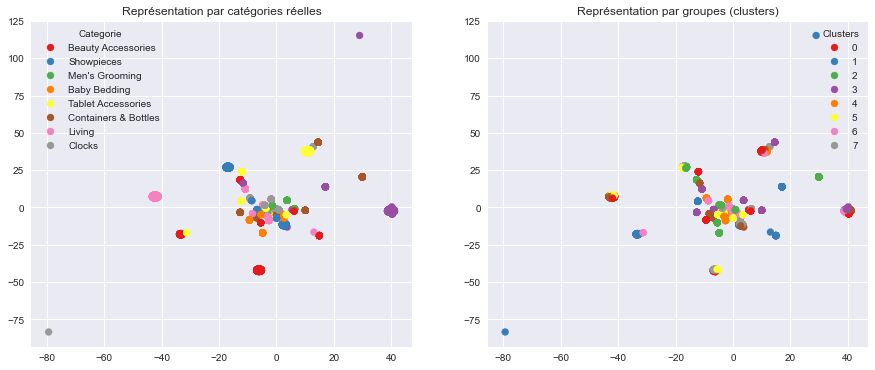

ARI :  0.537


In [72]:
#Graphiques
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

###  V.2.2.TF-IDF

In [73]:
#Préparation des sentences
#Création du bag of words (TF-IDF)
ctf = TfidfVectorizer(stop_words = 'english', max_df = 0.95, min_df = 1)

feat = 'cat_lvl_2'
ctf_fit = ctf.fit(df_P6_c[feat])

ctf_transform = ctf.transform(df_P6_c[feat])

In [74]:
print("Tf-idf : ")
print("--------")
ARI, X_tsne, labels = ARI_fct(ctf_transform)

Tf-idf : 
--------
ARI :  0.5075 time :  24.0


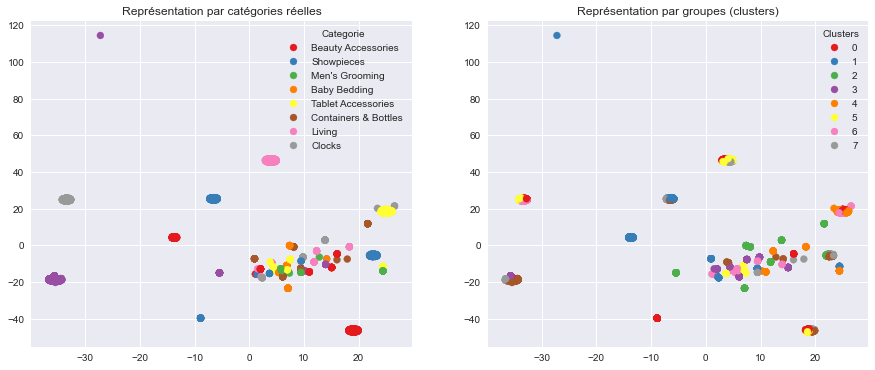

ARI :  0.5075


In [75]:
#Graphiques
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

In [76]:
#Max_df = [0.95, 0.9, 0.8]
#Min_df = [2, 4, 5]
#ARI_score_1 = []
#DB_score_1 = []
#final_param_1 = []
#for n in range(11):
#    df=add_n_name(n=n)
#    for max_df in Max_df:
#        for min_df in Min_df:
            # TFIDF
#            from sklearn.feature_extraction.text import TfidfVectorizer

#            tfidf = TfidfVectorizer(tokenizer=preprocess,
#                                    max_df=max_df,
#                                    min_df=min_df,
#                                    ngram_range=(1, 2),
#                                    stop_words={'english'})
#            values = tfidf.fit_transform(df)

            #Réduction de dimension par t-SNE
#           tsne = TSNE(n_components=2, perplexity=20,
#                        random_state=5)
#            tsne_results = tsne.fit_transform(values) 

            #KMeans sur les 7 catégories
#            from sklearn.cluster import KMeans
#            from statistics import mean
                
#            kmodel = KMeans(n_clusters=7, random_state=5)
#            kmodel.fit(tsne_results)
#            data_km = df_P6_c.copy()
#            data_km['kmeans_labels'] = kmodel.labels_
            
            #Score ARI
#            from sklearn.metrics import adjusted_rand_score
            
#            ARI = adjusted_rand_score(df_P6_c['cat_lvl_2'], data_km['kmeans_labels'])
            #Score DB
#            from sklearn.metrics import davies_bouldin_score
            
#            db_score = davies_bouldin_score(tsne_results, data_km['kmeans_labels'])
            
            #Enregistrement paramètres et score
#            ARI_score_1.append(ARI)
#            DB_score_1.append(db_score)
#            final_param_1.append((n, min_df, max_df))

In [77]:
#Meilleurs score ARI et paramètres
#print(f"Meilleur ARI = {max(ARI_score_1)} --- Meilleur DB_score = {min(DB_score_1)}")

In [78]:
#Détermination des meilleurs paramètres pour max ARI
#i1 = [i for i, j in enumerate(ARI_score_1) if j == max(ARI_score_1)]
#for i in i1:
#    print(f"(n, min_df, max_df) = {final_param_1[i]}")

In [79]:
# Détermination des meilleurs paramètres pour min DB
#i1 = [i for i, j in enumerate(DB_score_1) if j == min(DB_score_1)]
#for i in i1:
#    print(f"(n, min_df, max_df) = {final_param_1[i]}")

In [80]:
# Evolution de ARI score et DB score en fonction des paramètres
#plt.figure(figsize = (15,15))
#plt.plot(ARI_score_1)
#plt.plot(DB_score_1)
#plt.show()

In [81]:
#TFIDF
#tfidf = TfidfVectorizer(tokenizer=preprocess,
#                        ngram_range=(1, 2),
#                        max_df=0.95,
#                        min_df=4,
#                        stop_words={'english'})
#values_bow = tfidf.fit_transform(add_n_name(n=3))

In [82]:
#Réduction de dimension par t-SNE
#tsne = TSNE(n_components=2, perplexity=20, random_state=5)
#tsne_results_bow = tsne.fit_transform(values_bow) 

In [84]:
#K-Means sur 7 catégories
#kmodel = KMeans(n_clusters = 7, random_state = 5)
#kmodel.fit(tsne_results_bow)
#data_km = df_P6_c.copy()
#data_km['kmeans_labels'] = kmodel.labels_

In [85]:
# Score ARI
#ARI = adjusted_rand_score(df_P6_c['cat_lvl_2'], data_km['kmeans_labels'])
#db_score = davies_bouldin_score(tsne_results_bow, data_km['kmeans_labels'])
#
#print(f"ARI = {ARI} ------ DBScore = {db_score}")

In [86]:
#Plot des échantillons dans t-SNE plot
#data_km['tsne_1'] = tsne_results_bow[:, 0]
#data_km['tsne_2'] = tsne_results_bow[:, 1]
#plt.figure(figsize=(15, 7))
#plt.subplot(1, 2, 1)
#plot = sns.scatterplot(x="tsne_1",
#                       y="tsne_2",
#                       hue='cat_lvl_2',
#                       palette='tab10',
#                       data=data_km,
#                       legend="full")
#plt.xlim([-100, 60])
#plt.subplot(1, 2, 2)
#plot = sns.scatterplot(x="tsne_1",
#                       y="tsne_2",
#                       hue='kmeans_labels',
#                       palette='tab10',
#                       data=data_km,
#                       legend="full")
#plt.xlim([-100, 60])
#plt.savefig("tfidf_tsne.png", bbox_inches="tight")
#plt.show()

In [88]:
#stopwords_en = set(["a","a's","able","about","above","according","accordingly","across","actually","after","afterwards","again","against","ain't","all","allow","allows","almost","alone","along","already","also","although","always","am","among","amongst","an","and","another","any","anybody","anyhow","anyone","anything","anyway","anyways","anywhere","apart","appear","appreciate","appropriate","are","aren't","around","as","aside","ask","asking","associated","at","available","away","awfully","b","be","became","because","become","becomes","becoming","been","before","beforehand","behind","being","believe","below","beside","besides","best","better","between","beyond","both","brief","but","by","c","c'mon","c's","came","can","can't","cannot","cant","cause","causes","certain","certainly","changes","clearly","co","com","come","comes","concerning","consequently","consider","considering","contain","containing","contains","corresponding","could","couldn't","course","currently","d","definitely","described","despite","did","didn't","different","do","does","doesn't","doing","don't","done","down","downwards","during","e","each","edu","eg","eight","either","else","elsewhere","enough","entirely","especially","et","etc","even","ever","every","everybody","everyone","everything","everywhere","ex","exactly","example","except","f","far","few","fifth","first","five","followed","following","follows","for","former","formerly","forth","four","from","further","furthermore","g","get","gets","getting","given","gives","go","goes","going","gone","got","gotten","greetings","h","had","hadn't","happens","hardly","has","hasn't","have","haven't","having","he","he's","hello","help","hence","her","here","here's","hereafter","hereby","herein","hereupon","hers","herself","hi","him","himself","his","hither","hopefully","how","howbeit","however","i","i'd","i'll","i'm","i've","ie","if","ignored","immediate","in","inasmuch","inc","indeed","indicate","indicated","indicates","inner","insofar","instead","into","inward","is","isn't","it","it'd","it'll","it's","its","itself","j","just","k","keep","keeps","kept","know","known","knows","l","last","lately","later","latter","latterly","least","less","lest","let","let's","like","liked","likely","little","look","looking","looks","ltd","m","mainly","many","may","maybe","me","mean","meanwhile","merely","might","more","moreover","most","mostly","much","must","my","myself","n","name","namely","nd","near","nearly","necessary","need","needs","neither","never","nevertheless","new","next","nine","no","nobody","non","none","noone","nor","normally","not","nothing","novel","now","nowhere","o","obviously","of","off","often","oh","ok","okay","old","on","once","one","ones","only","onto","or","other","others","otherwise","ought","our","ours","ourselves","out","outside","over","overall","own","p","particular","particularly","per","perhaps","placed","please","plus","possible","presumably","probably","provides","q","que","quite","qv","r","rather","rd","re","really","reasonably","regarding","regardless","regards","relatively","respectively","right","s","said","same","saw","say","saying","says","second","secondly","see","seeing","seem","seemed","seeming","seems","seen","self","selves","sensible","sent","serious","seriously","seven","several","shall","she","should","shouldn't","since","six","so","some","somebody","somehow","someone","something","sometime","sometimes","somewhat","somewhere","soon","sorry","specified","specify","specifying","still","sub","such","sup","sure","t","t's","take","taken","tell","tends","th","than","thank","thanks","thanx","that","that's","thats","the","their","theirs","them","themselves","then","thence","there","there's","thereafter","thereby","therefore","therein","theres","thereupon","these","they","they'd","they'll","they're","they've","think","third","this","thorough","thoroughly","those","though","three","through","throughout","thru","thus","to","together","too","took","toward","towards","tried","tries","truly","try","trying","twice","two","u","un","under","unfortunately","unless","unlikely","until","unto","up","upon","us","use","used","useful","uses","using","usually","uucp","v","value","various","very","via","viz","vs","w","want","wants","was","wasn't","way","we","we'd","we'll","we're","we've","welcome","well","went","were","weren't","what","what's","whatever","when","whence","whenever","where","where's","whereafter","whereas","whereby","wherein","whereupon","wherever","whether","which","while","whither","who","who's","whoever","whole","whom","whose","why","will","willing","wish","with","within","without","won't","wonder","would","wouldn't","x","y","yes","yet","you","you'd","you'll","you're","you've","your","yours","yourself","yourselves","z","zero"])
#stopwords_nltk = set(stopwords.words('english'))
#stopwords_punct = set(punctuation)
#stopwords_combined = set.union(stopwords_en, stopwords_nltk, stopwords_punct)

In [89]:
#print('ponctuation : ',list(stopwords_punct)[0:4])
#print('stopwords : ',list(stopwords_nltk)[0:4])

In [90]:
#class LemmaTokenizer:
#     def __init__(self):
#         self.wnl = WordNetLemmatizer()
#     def __call__(self, doc):
#         return [self.wnl.lemmatize(t) for t in word_tokenize(doc)]

#tfidf = TfidfVectorizer(encoding = 'utf-8',
#                       lowercase = True,
#                       tokenizer = LemmaTokenizer(),
#                       stop_words = stopwords_combined)

In [91]:
#tfidf.fit_transform(train['description'])

In [92]:
#tfidf.get_feature_names()

In [93]:
#matrix_cat = tfidf.transform(train['description'])

In [94]:
#matrix_cat.todense()[0,:].tolist()

In [95]:
#train['description'].iloc[0]

In [96]:
#def affiche_liste(liste):
#    return liste

#description_example = train['description'].iloc[4]
#print('======== PRE TRAITEMENT ========')
#print(affiche_liste(description_example),'\n')
#lowercase
#description_example = description_example.lower()
#print('======== LOWERCASE ========')
#print(affiche_liste(description_example),'\n')

#tokenizer
#description_example = word_tokenize(description_example)
#print('======== TOKENIZER ========')
#print(affiche_liste(description_example),'\n')


#stopwords
#description_example = [w for w in description_example if not w in stopwords_combined] 
#print('======== STOPWORDS ========')
#print(affiche_liste(description_example),'\n')

#lemmatizer
#lemm = WordNetLemmatizer()
#description_example = [lemm.lemmatize(el) for el in description_example]
#print('======== LEMMATISATION ========')
#print(affiche_liste(description_example),'\n')

#transformation = []
#for i, el  in enumerate(matrix_cat.todense()[4,:].tolist()[0]):
#    if el !=0:
#        transformation.append((tfidf.get_feature_names()[i], el))
#pd.DataFrame(transformation, columns=['mot', 'tfidf']).sort_values(by='tfidf', ascending=False).head(10)

### V.2.3.Word2Vec 

In [97]:
w2v_size = 300
w2v_window = 5
w2v_min_count = 1
w2v_epochs = 100
maxlen = 24 #s'adapter à la longueur de la phrase
#sentences = df_P6_c['description'].to_list()
sentences = df_P6_c['cat_lvl_2'].to_list()
sentences = [gensim.utils.simple_preprocess(text) for text in sentences]

In [98]:
#Création et entraînement du modèle Word2Vec
print("Build & train Word2Vec model ...")
w2v_model = gensim.models.Word2Vec(min_count = w2v_min_count, window = w2v_window, vector_size = w2v_size, seed = 42, workers = 1)

w2v_model.build_vocab(sentences)
w2v_model.train(sentences, total_examples = w2v_model.corpus_count, epochs = w2v_epochs)
model_vectors = w2v_model.wv
w2v_words = model_vectors.index_to_key
print("Vocabulary size: %i" % len(w2v_words))
print("Word2Vec trained")

Build & train Word2Vec model ...
Vocabulary size: 103
Word2Vec trained


In [99]:
#Préparation des phrases ou sentences (tokenization)
print("Fit Tokenizer ...")
tokenizer = Tokenizer()
tokenizer.fit_on_texts(sentences)
x_sentences = pad_sequences(tokenizer.texts_to_sequences(sentences), maxlen = maxlen, padding = 'post') 
                                                   
num_words = len(tokenizer.word_index) + 1
print("Number of unique words: %i" % num_words)

Fit Tokenizer ...
Number of unique words: 104


In [100]:
#Création de la matrice d'embedding
print("Create Embedding matrix ...")
w2v_size = 300
word_index = tokenizer.word_index
vocab_size = len(word_index) + 1
embedding_matrix = np.zeros((vocab_size, w2v_size))
i = 0
j = 0
    
for word, idx in word_index.items():
    i += 1
    if word in w2v_words:
        j +=1
        embedding_vector = model_vectors[word]
        if embedding_vector is not None:
            embedding_matrix[idx] = model_vectors[word]
            
word_rate = np.round(j/i, 4)
print("Word embedding rate : ", word_rate)
print("Embedding matrix: %s" % str(embedding_matrix.shape))

Create Embedding matrix ...
Word embedding rate :  1.0
Embedding matrix: (104, 300)


In [101]:
#Création du modèle d'embedding
input = Input(shape = (len(x_sentences), maxlen), dtype = 'float64')
word_input = Input(shape = (maxlen,),dtype = 'float64')  
word_embedding = Embedding(input_dim = vocab_size,
                         output_dim = w2v_size,
                         weights = [embedding_matrix],
                         input_length = maxlen)(word_input)
word_vec = GlobalAveragePooling1D()(word_embedding)  
embed_model = Model([word_input], word_vec)

embed_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 24)]              0         
                                                                 
 embedding (Embedding)       (None, 24, 300)           31200     
                                                                 
 global_average_pooling1d (G  (None, 300)              0         
 lobalAveragePooling1D)                                          
                                                                 
Total params: 31,200
Trainable params: 31,200
Non-trainable params: 0
_________________________________________________________________


In [102]:
#Exécution du modèle
embeddings = embed_model.predict(x_sentences)
embeddings.shape

33/33 [==============================] - 0s 1ms/step


(1050, 300)

In [103]:
l_cat = list(set(df_P6_c['cat_lvl_2']))

In [104]:
print("catégories : ", l_cat)
y_cat_num = [(1-l_cat.index(df_P6_c.iloc[i]['cat_lvl_2'])) for i in range(len(df_P6_c))]

catégories :  ['Beauty Accessories', 'Showpieces', "Men's Grooming", 'Baby Bedding', 'Tablet Accessories', 'Containers & Bottles', 'Living', 'Clocks', 'Infant Wear', 'Feeding & Nursing', 'Computer Peripherals', 'Baby Bath & Skin', 'Floor Coverings', 'Living Room Furnishing', 'Dinnerware & Crockery', 'Combos and Kits', 'Cushions, Pillows & Covers', 'Body and Skin Care', 'Curtains & Accessories', 'Housekeeping & Laundry', 'Lighting', 'Laptop Accessories', 'Kitchen & Dining Linen', 'Baby & Kids Gifts', 'Flowers, Plants & Vases', 'Tableware & Cutlery', 'Computer Components', 'Storage', 'Makeup', 'Garden & Leisure', 'Decorative Lighting & Lamps', 'Diapering & Potty Training', 'Laptops', "Kripa's Home Furnishing", 'Candles & Fragrances', 'Software', 'Strollers & Activity Gear', 'Eye Care', 'Wrist Watches', 'Bath and Spa', 'Table Decor & Handicrafts', 'Hair Care', 'Religion & Devotion', 'JMD Home Furnishing', 'Pressure Cookers & Pans', 'Consumables & Disposables', 'Kitchen Tools', 'Furniture 

In [105]:
#Calcul Tsne, détermination des clusters et calcul ARI entre vrais catégorie et nombre de groupes (clusters)
def ARI_fct(features) :
    time1 = time.time()
    num_labels = len(l_cat)
    tsne = manifold.TSNE(n_components = 2, perplexity = 30, n_iter = 2000, 
                                 init = 'random', learning_rate = 200, random_state = 42)
    X_tsne = tsne.fit_transform(features)
    
    # Détermination des clusters à partir des données après Tsne 
    cls = cluster.KMeans(n_clusters = num_labels, n_init = 100, random_state = 42)
    cls.fit(X_tsne)
    ARI = np.round(metrics.adjusted_rand_score(y_cat_num, cls.labels_), 4)
    time2 = np.round(time.time() - time1, 0)
    print("ARI : ", ARI, "time : ", time2)
    
    return ARI, X_tsne, cls.labels_

In [106]:
ARI, X_tsne, labels = ARI_fct(embeddings)

ARI :  0.431 time :  23.0


In [107]:
#Visualisation du Tsne selon les vraies catégories et selon les groupes (clusters)
def TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI) :
    fig = plt.figure(figsize = (15,6))
    
    ax = fig.add_subplot(121)
    scatter = ax.scatter(X_tsne[:,0], X_tsne[:,1], c = y_cat_num, cmap = 'Set1')
    ax.legend(handles = scatter.legend_elements()[0], labels = l_cat, loc = "best", title = "Categorie")
    plt.title('Représentation par catégories réelles')
    
    ax = fig.add_subplot(122)
    scatter = ax.scatter(X_tsne[:,0],X_tsne[:,1], c = labels, cmap = 'Set1')
    ax.legend(handles = scatter.legend_elements()[0], labels = set(labels), loc = "best", title = "Clusters")
    plt.title('Représentation des catégories par clusters')
    
    plt.show()
    print("ARI : ", ARI)

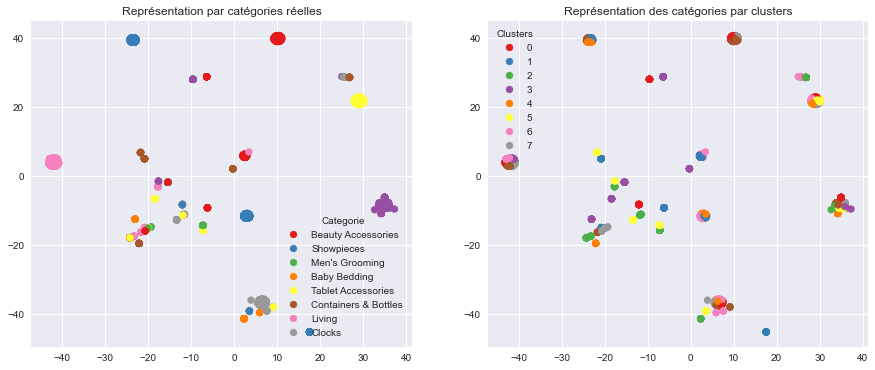

ARI :  0.431


In [108]:
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

In [109]:
#def sent_vectorizer(sent, model):
#    """Vectorisation des listes de mots"""
#    sent_vec =[]
#    numw = 0
#    for w in sent:
#        try:
#            if numw == 0:
#                sent_vec = model.wv[w]
#            else:
#                sent_vec = np.add(sent_vec, model.wv[w])
#            numw+=1
#        except:
#            pass
         
#    return np.asarray(sent_vec) / numw

In [110]:
#Size = [50, 100, 500]
#Window = [10, 20, 30]
#Min_count = [2, 5, 10]

#ARI_score_2 = []
#DB_score_2 = []
#final_param_2 = []
#for n in [2, 5, 10]:
#    df=add_n_name(n=n)
#    df1=df.apply(word_tokenize)
#    for size in Size:
#        for window in Window:
#            for min_count in Min_count:
#                from gensim.models import Word2Vec
#               from gensim.models.fasttext import FastText
#                w2v = gensim.models.Word2Vec(df1,
#                               sg=1,
#                               seed=1,
#                               vector_size=size,
#                               window=window,
#                               min_count=min_count,
#                               batch_words=5000,
#                               sample=1e-3,
#                               workers=1)
#                X=[]
#                for sentence in df1:
#                    X.append(sent_vectorizer(sentence, w2v))

#                tsne = TSNE(n_components=2, perplexity=20,
#                           random_state=5)
#                tsne_results = tsne.fit_transform(X)

                #KMeans sur les 7 catégories
#                from sklearn.cluster import KMeans
#                from statistics import mean

#                kmodel = KMeans(n_clusters=7, random_state=5)
#                kmodel.fit(tsne_results)
#                data_km = df_P6_c.copy()
#                data_km['kmeans_labels'] = kmodel.labels_
                
                #Score ARI
#                from sklearn.metrics import adjusted_rand_score
#                ARI = adjusted_rand_score(df_P6_c['cat_lvl_2'],
#                                          data_km['kmeans_labels'])
                
                #Score DB
#                from sklearn.metrics import davies_bouldin_score
            
#                db_score = davies_bouldin_score(tsne_results, data_km['kmeans_labels'])
            
                #Enregistrement paramètres et score
#                ARI_score_2.append(ARI)
#                DB_score_2.append(db_score)
#                final_param_2.append((n, size, window, min_count))

In [111]:
# Meilleurs score ARI et paramètres
#print(f"Meilleur ARI = {max(ARI_score_2)} --- Meilleur DB_score = {min(DB_score_2)}")

In [112]:
#ARI_score_2[14]

In [113]:
#final_param_2[14]

In [114]:
#Détermination des meilleurs paramètres pour max ARI
#i2 = [i for i, j in enumerate(ARI_score_2) if j == max(ARI_score_2)]
#for i in i2:
#    print(f"(n, size, window, min_count) = {final_param_2[i]}")

In [115]:
#Détermination des meilleurs paramètres pour min DB
#i2db = [i for i, j in enumerate(DB_score_2) if j == min(DB_score_2)]
#for i in i2db:
#    print(f"(n, size, window, min_count) = {final_param_2[i]}")

In [116]:
#df = add_n_name(n=2)
#df1=df.apply(word_tokenize)
#w2v = gensim.models.Word2Vec(df1,
#               sg=1,
#               seed=1,
#               vector_size=100,
#               window=20,
#               batch_words=5000,
#               min_count=5,
#               sample=1e-3,
#               workers=1)

In [117]:
#X_w2v=[]
#for sentence in df1:
#    X_w2v.append(sent_vectorizer(sentence, w2v)) 

In [118]:
#len(X_w2v)

In [119]:
#Réduction de dimension par t-SNE
#tsne = TSNE(n_components = 2, perplexity = 20, random_state = 5)#
#tsne_results_w2v = tsne.fit_transform(X_w2v)

In [120]:
#KMeans sur les 7 catégories
#kmodel = KMeans(n_clusters = 7, random_state = 5)
#kmodel.fit(tsne_results_w2v)
#data_km = df_P6_c.copy()
#data_km['kmeans_labels'] = kmodel.labels_

In [121]:
#Score ARI
#ARI = adjusted_rand_score(df_P6_c['cat_lvl_2'], data_km['kmeans_labels'])
#db_score = davies_bouldin_score(tsne_results_w2v, data_km['kmeans_labels'])

#print(f"ARI = {ARI} ------ DBScore = {db_score}")

In [122]:
#Plot des échantillons dans t-SNE plot
#data_km['tsne_1'] = tsne_results_w2v[:, 0]
#data_km['tsne_2'] = tsne_results_w2v[:, 1]
#plt.figure(figsize=(15, 7))
#plt.subplot(1, 2, 1)
#plot = sns.scatterplot(x="tsne_1",
#                       y="tsne_2",
#                       hue='cat_lvl_2',
#                       palette='tab10',
#                       data=data_km,
#                       legend="full")
#plt.xlim([-110, 60])
#plt.subplot(1, 2, 2)
#plot = sns.scatterplot(x="tsne_1",
#                       y="tsne_2",
#                       hue='kmeans_labels',
#                       palette='tab10',
#                       data=data_km,
#                       legend="full")
#plt.xlim([-110, 60])
#plt.savefig("w2v_tsne.png", bbox_inches="tight")
#plt.show()

### V.2.4.BERT 

In [123]:
os.environ["TF_KERAS"]='1'

In [124]:
print(tf.__version__)
print(tensorflow.__version__)
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
print(tf.test.is_built_with_cuda())

2.9.1
2.9.1
Num GPUs Available:  0
True


In [125]:
#Fonction de préparation des sentences
def bert_inp_fct(sentences, bert_tokenizer, max_length) :
    input_ids=[]
    token_type_ids = []
    attention_mask=[]
    bert_inp_tot = []

    for sent in sentences:
        bert_inp = bert_tokenizer.encode_plus(sent,
                                              add_special_tokens = True,
                                              max_length = max_length,
                                              padding='max_length',
                                              return_attention_mask = True, 
                                              return_token_type_ids=True,
                                              truncation=True,
                                              return_tensors="tf")
    
        input_ids.append(bert_inp['input_ids'][0])
        token_type_ids.append(bert_inp['token_type_ids'][0])
        attention_mask.append(bert_inp['attention_mask'][0])
        bert_inp_tot.append((bert_inp['input_ids'][0], 
                             bert_inp['token_type_ids'][0], 
                             bert_inp['attention_mask'][0]))

    input_ids = np.asarray(input_ids)
    token_type_ids = np.asarray(token_type_ids)
    attention_mask = np.array(attention_mask)
    
    return input_ids, token_type_ids, attention_mask, bert_inp_tot
    

#Fonction de création des features
def feature_BERT_fct(model, model_type, sentences, max_length, b_size, mode='HF') :
    batch_size = b_size
    batch_size_pred = b_size
    bert_tokenizer = AutoTokenizer.from_pretrained(model_type)
    time1 = time.time()

    for step in range(len(sentences)//batch_size) :
        idx = step*batch_size
        input_ids, token_type_ids, attention_mask, bert_inp_tot = bert_inp_fct(sentences[idx:idx+batch_size], 
                                                                      bert_tokenizer, max_length)
        
        if mode=='HF' :    # Bert HuggingFace
            outputs = model.predict([input_ids, attention_mask, token_type_ids], batch_size=batch_size_pred)
            last_hidden_states = outputs.last_hidden_state

        if mode=='TFhub' : # Bert Tensorflow Hub
            text_preprocessed = {"input_word_ids" : input_ids, 
                                 "input_mask" : attention_mask, 
                                 "input_type_ids" : token_type_ids}
            outputs = model(text_preprocessed)
            last_hidden_states = outputs['sequence_output']
             
        if step ==0 :
            last_hidden_states_tot = last_hidden_states
            last_hidden_states_tot_0 = last_hidden_states
        else :
            last_hidden_states_tot = np.concatenate((last_hidden_states_tot,last_hidden_states))
    
    features_bert = np.array(last_hidden_states_tot).mean(axis=1)
    
    time2 = np.round(time.time() - time1,0)
    print("temps traitement : ", time2)
     
    return features_bert, last_hidden_states_tot

### V.2.4.1.BERT HuggingFace

In [126]:
#Bert-base-uncased
max_length = 64
batch_size = 10
model_type = 'bert-base-uncased'
model = TFAutoModel.from_pretrained(model_type)
sentences = df_P6_c['cat_lvl_2'].to_list()

Some layers from the model checkpoint at bert-base-uncased were not used when initializing TFBertModel: ['mlm___cls', 'nsp___cls']
- This IS expected if you are initializing TFBertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
All the layers of TFBertModel were initialized from the model checkpoint at bert-base-uncased.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertModel for predictions without further training.


In [127]:
#Création des features

features_bert, last_hidden_states_tot = feature_BERT_fct(model, model_type, sentences, max_length, batch_size, mode = 'HF')

1/1 [==============================] - 1s 866ms/step
temps traitement :  108.0


In [128]:
ARI, X_tsne, labels = ARI_fct(features_bert)

ARI :  0.484 time :  23.0


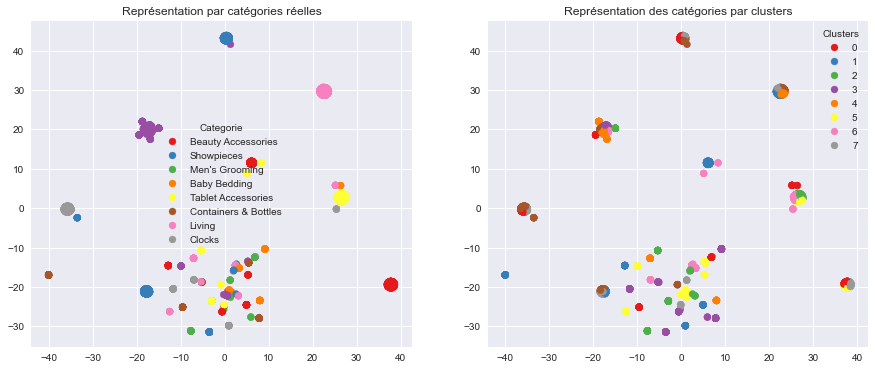

ARI :  0.484


In [129]:
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

### V.2.4.2.BERT hub Tensorflow 

In [130]:
model_url = 'https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4'
bert_layer = hub.KerasLayer(model_url, trainable = True)

In [131]:
sentences = df_P6_c['cat_lvl_2'].to_list()

In [132]:
max_length = 64
batch_size = 10
model_type = 'bert-base-uncased'
model = bert_layer

features_bert, last_hidden_states_tot = feature_BERT_fct(model, model_type, sentences, max_length, batch_size, mode = 'TFhub')

temps traitement :  101.0


In [133]:
ARI, X_tsne, labels = ARI_fct(features_bert)

ARI :  0.5969 time :  24.0


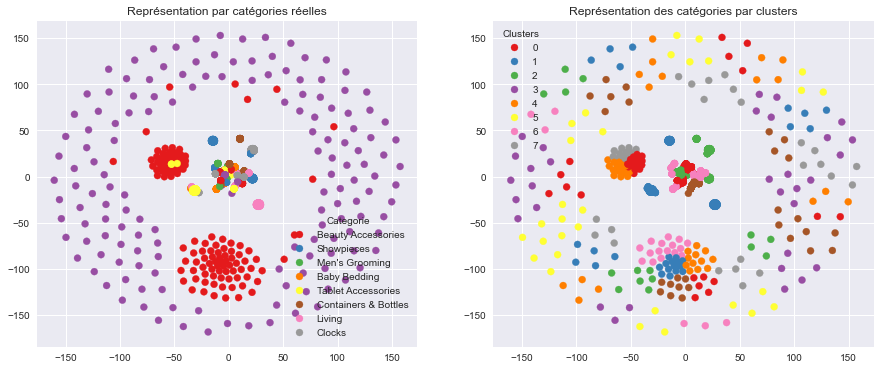

ARI :  0.5969


In [134]:
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

### V.2.5.Universal Sentence Encoder (USE)

In [135]:
print(tf.__version__)
print(tensorflow.__version__)
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
print(tf.test.is_built_with_cuda())

2.9.1
2.9.1
Num GPUs Available:  0
True


In [136]:
embed = hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")

In [137]:
def feature_USE_fct(sentences, b_size) :
    batch_size = b_size
    time1 = time.time()

    for step in range(len(sentences)//batch_size) :
        idx = step*batch_size
        feat = embed(sentences[idx:idx+batch_size])

        if step ==0 :
            features = feat
        else :
            features = np.concatenate((features,feat))

    time2 = np.round(time.time() - time1,0)
    return features

In [138]:
batch_size = 10
sentences = df_P6_c['cat_lvl_2'].to_list()

In [139]:
features_USE = feature_USE_fct(sentences, batch_size)

In [140]:
ARI, X_tsne, labels = ARI_fct(features_USE)

ARI :  0.5096 time :  23.0


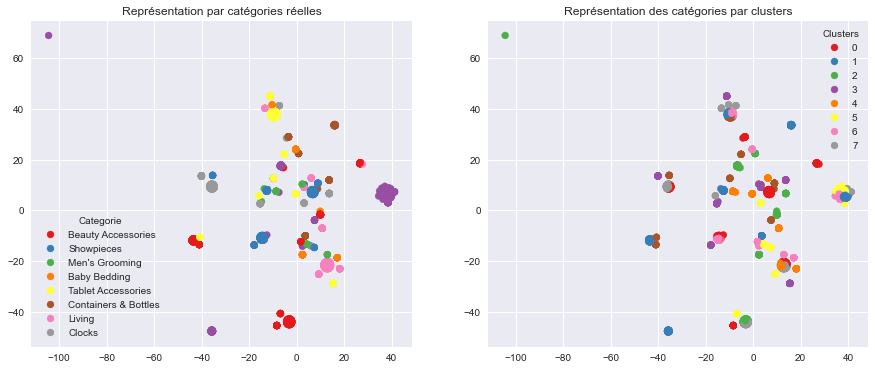

ARI :  0.5096


In [141]:
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

In [142]:
#encoder = hub.load('https://tfhub.dev/google/universal-sentence-encoder/4')

In [145]:
#ARI_score_4 = []
#DB_score_4 = []
#final_params_4 = []
#for n in range(11):
#    df = add_n_name(n=n)
#    tf_tensor = encoder(df.values)
#    df_use = pd.DataFrame(tens.make_ndarray(tens.make_tensor_proto(tf_tensor)),
#                         index=df.index,
#                         columns=['dim'+str(i) for i in range(512)])

    #Réduction de dimension par t-SNE
#    from sklearn.manifold import TSNE

#    tsne = TSNE(n_components=2, perplexity=20,
#                random_state=5)
#    tsne_results = tsne.fit_transform(df_use) 

    #KMeans sur les 7 catégories
#    from sklearn.cluster import KMeans

#    kmodel = KMeans(n_clusters=7, random_state=5)
#    kmodel.fit(tsne_results)
#    data_kmuse = df_P6_c.copy()
#    data_kmuse['kmeans_labels'] = kmodel.labels_

    #Score ARI
#       from sklearn.metrics import adjusted_rand_score
    
#    ARI = adjusted_rand_score(df_P6_c['cat_lvl_2'],
#                              data_kmuse['kmeans_labels'])
    
     #Score DB
#    from sklearn.metrics import davies_bouldin_score
        
#    db_score = davies_bouldin_score(tsne_results, data_kmuse['kmeans_labels'])
    
#    ARI_score_4.append(ARI)
#    DB_score_4.append(db_score)
#    final_params_4.append(n)

In [144]:
# Meilleurs score ARI et paramètres
#print(f"Meilleur ARI = {max(ARI_score_4)} --- Meilleur DB_score = {min(DB_score_4)}")

In [143]:
# Détermination des meilleurs paramètres pour max ARI
#i4 = [i for i, j in enumerate(ARI_score_4) if j == max(ARI_score_4)]
#for i in i4:
#    print(f"n = {final_params_4[i]}")

In [146]:
# Détermination des meilleurs paramètres pour min DB
#i4db = [i for i, j in enumerate(DB_score_4) if j == min(DB_score_4)]
#for i in i4db:
#    print(f"n = {final_params_4[i]}")

In [147]:
#df = add_n_name(n=3)
#tf_tensor = encoder(df.values)
#df_use = pd.DataFrame(tens.make_ndarray(tens.make_tensor_proto(tf_tensor)),
#                      index=df.index,
#                      columns=['dim'+str(i) for i in range(512)])

In [148]:
#Réduction de dimension par t-SNE
#from sklearn.manifold import TSNE

#tsne = TSNE(n_components=2, perplexity=20,
#            random_state=5)
#tsne_results_use = tsne.fit_transform(df_use) 

In [149]:
#KMeans sur les 7 catégories
#from sklearn.cluster import KMeans

#kmodel = KMeans(n_clusters=7, random_state=5)
#kmodel.fit(tsne_results_use)
#data_kmuse = df_P6_c.copy()
#data_kmuse['kmeans_labels'] = kmodel.labels_

In [150]:
#Score ARI
#from sklearn.metrics import adjusted_rand_score
#from sklearn.metrics import davies_bouldin_score

#ARI = adjusted_rand_score(df_P6_c['cat_lvl_2'],
#                          data_kmuse['kmeans_labels'])
#db_score = davies_bouldin_score(tsne_results_use, data_kmuse['kmeans_labels'])

#print(f"ARI = {ARI} ------ DBScore = {db_score}")

In [152]:
#Plot des échantillons dans t-SNE plot
#data_kmuse['tsne_1'] = tsne_results_use[:, 0]
#data_kmuse['tsne_2'] = tsne_results_use[:, 1]
#plt.figure(figsize=(15, 7))
#plt.subplot(1, 2, 1)
#plot = sns.scatterplot(x="tsne_1",
#                       y="tsne_2",
#                       hue='cat_lvl_2',
#                       palette='tab10',
#                       data=data_kmuse,
#                       legend="full")
#plt.ylim([-80, 80])
#plt.xlim([-110, 50])
#plt.subplot(1, 2, 2)
#plot = sns.scatterplot(x="tsne_1",
#                       y="tsne_2",
#                       hue='kmeans_labels',
#                       palette='tab10',
#                       data=data_kmuse,
#                       legend="full")
#plt.ylim([-80, 80])
#plt.xlim([-110, 50])
#plt.savefig("use_tsne.png", bbox_inches="tight")
#plt.show()

### V.3.Réduction de dimension (LDA et NMF) 

### V.3.1.LDA

In [153]:
Max_df = [0.9, 0.8, 0.5, 0.4]
Min_df = [5, 10, 20]
N = [0, 2, 5, 10]
n_grams = [(1,1), (1,2)]
Max_features = [10, 100, 1000]
n_topics=7

ARI_score_3=[]
DB_score_3 = []
Likehood = []
Perplexity = []
final_params_3=[]

for n in N:
    df=add_n_name(n=n)
    for min_df in Min_df:
        for max_df in Max_df:
            for ngram in n_grams:
                for max_features in Max_features:
                # Comptage
                    from sklearn.feature_extraction.text import CountVectorizer

                    cnt_vectorizer = CountVectorizer(max_df=max_df, min_df=min_df,
                                                     max_features=max_features,
                                                     ngram_range=ngram,
                                                     token_pattern='[a-zA-Z0-9]{3,}',
                                                     stop_words='english')
                    cnt = cnt_vectorizer.fit_transform(df)

                    # LDA fit
                    from sklearn.decomposition import LatentDirichletAllocation

                    lda = LatentDirichletAllocation(n_components=n_topics,
                                                    learning_method='online',
                                                    random_state=5)
                    lda_results = lda.fit_transform(cnt)
                    lda_score = lda.score(cnt)
                    lda_perplexity = lda.perplexity(cnt)

                    # KMeans sur les 7 catégories
                    from sklearn.cluster import KMeans

                    kmodel = KMeans(n_clusters=7, random_state=5)
                    kmodel.fit(lda_results)
                    data_kmlda = df_P6_c.copy()
                    data_kmlda['kmeans_labels'] = kmodel.labels_

                    # Score ARI
                    ARI = adjusted_rand_score(df_P6_c['cat_lvl_2'],
                                              data_kmlda['kmeans_labels'])
                    
                    # Score DB
                    from sklearn.metrics import davies_bouldin_score
            
                    db_score = davies_bouldin_score(lda_results, data_kmlda['kmeans_labels'])
                    
                     
                    ARI_score_3.append(ARI)
                    DB_score_3.append(db_score)
                    Likehood.append(lda_score)
                    Perplexity.append(lda_perplexity)
                    final_params_3.append((n, min_df, max_df, ngram, max_features))

In [154]:
#Meilleurs score ARI et paramètres
print(f"Meilleur ARI = {max(ARI_score_3)} --- Meilleur DB_score = {min(DB_score_3)}")

Meilleur ARI = 0.4275950830039358 --- Meilleur DB_score = 0.2512837509483869


In [155]:
#Meilleurs score Ressemblance et perplexity
print(f"Meilleur Loglikehood = {max(Likehood)} --- Meilleur Perplexity = {min(Perplexity)}")

Meilleur Loglikehood = -5962.183016005916 --- Meilleur Perplexity = 2.6786060121096273


In [156]:
#Détermination des meilleurs paramètres pour Loglikehood
il = [i for i, j in enumerate(Likehood) if j == max(Likehood)]
for i in il:
    print(f"(n, min_df, max_df, ngram, max_features) = {final_params_3[i]}")

(n, min_df, max_df, ngram, max_features) = (2, 5, 0.5, (1, 2), 10)
(n, min_df, max_df, ngram, max_features) = (2, 5, 0.4, (1, 2), 10)
(n, min_df, max_df, ngram, max_features) = (2, 10, 0.5, (1, 2), 10)
(n, min_df, max_df, ngram, max_features) = (2, 10, 0.4, (1, 2), 10)
(n, min_df, max_df, ngram, max_features) = (2, 20, 0.5, (1, 2), 10)
(n, min_df, max_df, ngram, max_features) = (2, 20, 0.4, (1, 2), 10)


In [157]:
#Détermination des meilleurs paramètres pour Perplexity
ip = [i for i, j in enumerate(Perplexity) if j == min(Perplexity)]
for i in ip:
    print(f"(n, min_df, max_df, ngram, max_features) = {final_params_3[i]}")

(n, min_df, max_df, ngram, max_features) = (10, 5, 0.5, (1, 1), 10)
(n, min_df, max_df, ngram, max_features) = (10, 5, 0.4, (1, 1), 10)
(n, min_df, max_df, ngram, max_features) = (10, 10, 0.5, (1, 1), 10)
(n, min_df, max_df, ngram, max_features) = (10, 10, 0.4, (1, 1), 10)
(n, min_df, max_df, ngram, max_features) = (10, 20, 0.5, (1, 1), 10)
(n, min_df, max_df, ngram, max_features) = (10, 20, 0.4, (1, 1), 10)


In [158]:
#Détermination des meilleurs paramètres pour max ARI
i3 = [i for i, j in enumerate(ARI_score_3) if j == max(ARI_score_3)]
for i in i3:
    print(f"(n, min_df, max_df, ngram, max_features) = {final_params_3[i]}")

(n, min_df, max_df, ngram, max_features) = (5, 5, 0.5, (1, 1), 100)
(n, min_df, max_df, ngram, max_features) = (5, 5, 0.4, (1, 1), 100)
(n, min_df, max_df, ngram, max_features) = (5, 10, 0.5, (1, 1), 100)
(n, min_df, max_df, ngram, max_features) = (5, 10, 0.4, (1, 1), 100)


In [159]:
#Détermination des meilleurs paramètres pour min DB
i3db = [i for i, j in enumerate(DB_score_3) if j == min(DB_score_3)]
for i in i3db:
    print(f"(n, min_df, max_df, ngram, max_features) = {final_params_3[i]}")

(n, min_df, max_df, ngram, max_features) = (5, 5, 0.5, (1, 2), 10)
(n, min_df, max_df, ngram, max_features) = (5, 5, 0.4, (1, 2), 10)
(n, min_df, max_df, ngram, max_features) = (5, 10, 0.5, (1, 2), 10)
(n, min_df, max_df, ngram, max_features) = (5, 10, 0.4, (1, 2), 10)
(n, min_df, max_df, ngram, max_features) = (5, 20, 0.5, (1, 2), 10)
(n, min_df, max_df, ngram, max_features) = (5, 20, 0.4, (1, 2), 10)


In [160]:
#Fonction de visualisation des topics

def display_topics(model, feature_names, no_top_words):
    for topic_idx, topic in enumerate(model.components_):
        print("Topic {}:".format(topic_idx))
        print("/".join([feature_names[i] for i in topic.argsort()[:-no_top_words - 1:-1]]))

no_top_words = 10

In [161]:
#Comptage
df = add_n_name(n=10)
from sklearn.feature_extraction.text import CountVectorizer

cnt_vectorizer = CountVectorizer(max_df=0.5, min_df=5,
                                 max_features=1000,
                                 ngram_range=(1, 2),
                                 token_pattern='[a-zA-Z0-9]{3,}',
                                 stop_words='english')
cnt = cnt_vectorizer.fit_transform(df)

In [162]:
#LDA fit
from sklearn.decomposition import LatentDirichletAllocation

n_topics = 7
lda = LatentDirichletAllocation(n_components=n_topics,
                                learning_method='online',
                                random_state=5)
lda_results = lda.fit_transform(cnt)
lda_score = lda.score(cnt)
lda_perplexity = lda.perplexity(cnt)

display(f"Log likehood: {lda_score}, Perplexity: {lda_perplexity}")      

'Log likehood: -451354.0429759039, Perplexity: 165.84877313599057'

In [163]:
#KMeans sur les 7 catégories
from sklearn.cluster import KMeans

kmodel = KMeans(n_clusters=7, random_state=5)
kmodel.fit(lda_results)
data_kmlda = df_P6_c.copy()
data_kmlda['kmeans_labels'] = kmodel.labels_

In [164]:
#Réduction de dimension par t-SNE
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, perplexity=20,
           random_state=5)
tsne_results_lda = tsne.fit_transform(lda_results) 

In [165]:
#Score ARI
from sklearn.metrics import adjusted_rand_score
from sklearn.metrics import davies_bouldin_score

ARI = adjusted_rand_score(df_P6_c['cat_lvl_2'],
                          data_kmlda['kmeans_labels'])
db_score = davies_bouldin_score(lda_results, data_kmlda['kmeans_labels'])

print(f"ARI = {ARI} ------ DBScore = {db_score}")

ARI = 0.42019630418660664 ------ DBScore = 0.47624772652602954


In [166]:
display_topics(lda, cnt_vectorizer.get_feature_names(), 10)

Topic 0:
polyester/curtain/eyelet/single/comfort/design/aroma/aroma comfort/abstract/door
Topic 1:
mug/showpiece/ceramic/ceramic mug/gift/prithish/rockmantra/mug prithish/kadhai/mug rockmantra
Topic 2:
usb/laptop/light/battery/cell/adapter/laptop battery/usb light/cell laptop/warranty
Topic 3:
analog/watch/sticker/analog watch/woman/watch woman/vinyl/vinyl sticker/large/medium
Topic 4:
showpiece/cream/color/hair/bottle/box/flexible/design/massage/vitamin
Topic 5:
baby/girl/cotton/baby girl/towel/dress/boy/baby boy/shirt/bath
Topic 6:
combo/set/combo set/skin/laptop/print/shape/laptop skin/print shape/mouse


In [167]:
#Visualisatuin LDA results
import pyLDAvis
import pyLDAvis.sklearn
#pyLDAvis.enable_notebook()
#import pyLDAvis.gensim_models
lda_vis = pyLDAvis.sklearn.prepare(lda, cnt, cnt_vectorizer) 
pyLDAvis.display(lda_vis)

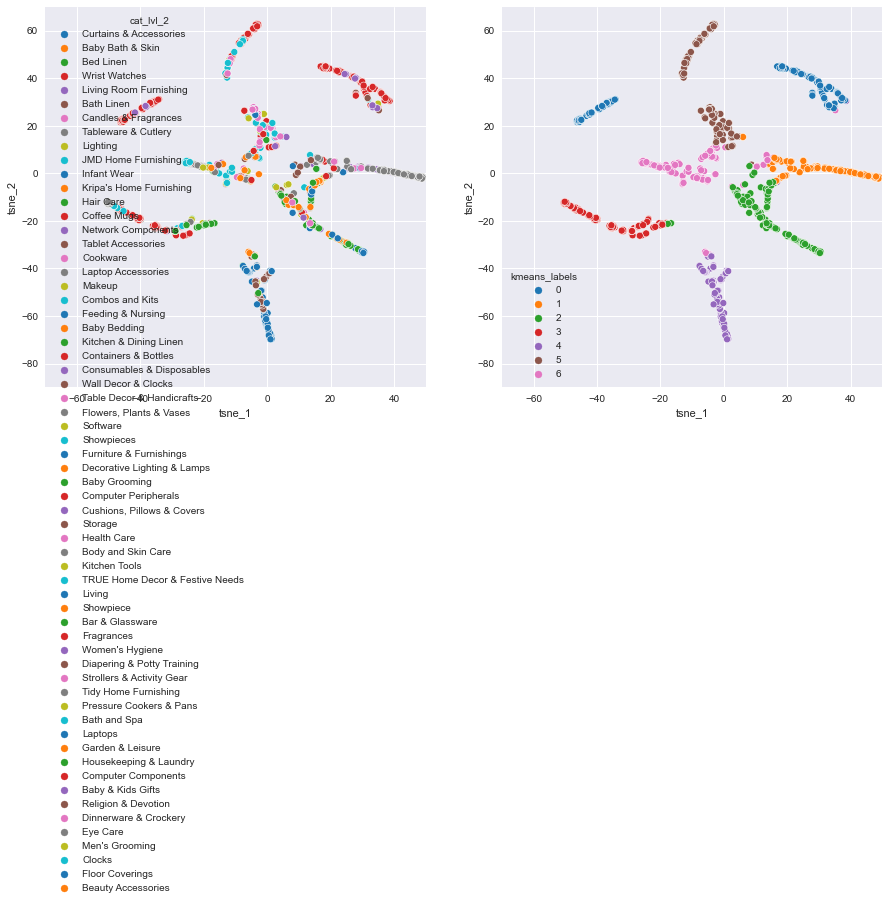

In [168]:
#Plot des samples dans t-SNE plot
data_kmlda['tsne_1'] = tsne_results_lda[:, 0]
data_kmlda['tsne_2'] = tsne_results_lda[:, 1]
plt.figure(figsize=(15, 7))
plt.subplot(1, 2, 1)
plot = sns.scatterplot(x="tsne_1",
                       y="tsne_2",
                       hue='cat_lvl_2',
                       palette='tab10',
                       data=data_kmlda,
                       legend="full")
plt.xlim([-70, 50])
plt.ylim([-90, 70])
plt.subplot(1, 2, 2)
plot = sns.scatterplot(x="tsne_1",
                       y="tsne_2",
                       hue='kmeans_labels',
                       palette='tab10',
                       data=data_kmlda,
                       legend="full")
plt.xlim([-70, 50])
plt.ylim([-90, 70])
plt.savefig("tsne_lda.png", bbox_inches="tight")
plt.show()

In [169]:
lda = LatentDirichletAllocation(n_components = df_P6_c['cat_lvl_2'].nunique(), random_state = 2)

In [171]:
#lda.fit(tf)

In [172]:
#tf_feature_names = tf_vectorizer.get_feature_names()
#print_top_words(lda, tf_feature_names, n_top_words = 10)

In [173]:
#lda.transform(tf_vectorizer.transform(test['description']))

In [174]:
#lda.transform(tf_vectorizer.transform(train['description']))[1,:]

In [175]:
#lda.transform(tf_vectorizer.transform(train['description'])).shape

In [176]:
#Topic le plus représenté par catégorie d'article

#val_best_topic = {}
#best_topic = {}
#matrix = lda.transform(tf_vectorizer.transform(train['description']))
#for i in range(0,matrix.shape[0]):
#    val_best_topic[i] = 0
#    for j in range(0, matrix.shape[1]):
#        if matrix[i,j] > val_best_topic[i]:
#            val_best_topic[i] = matrix[i,j]
#            best_topic[i]= j

In [177]:
#train_lda = train.copy()
#train_lda['topic_lda'] = list(best_topic.values())

In [178]:
#Catégories du jeu de données en fonction des topics identifiés

#train_lda[['cat_lvl_1','cat_lvl_2','topic_lda']].groupby(['topic_lda','cat_lvl_2']).count().sort_values(by = ['topic_lda', 'cat_lvl_1'], ascending = [True, False])

In [179]:
#Topic identifiés en fonction des catégories du jeu de données

#train_lda[['cat_lvl_1','cat_lvl_2','topic_lda']].groupby(['cat_lvl_2','topic_lda']).count().sort_values(by = ['cat_lvl_2', 'cat_lvl_1'], ascending = [True, False])

In [180]:
#del train_lda

### V.2.2.NMF 

In [181]:
from sklearn.decomposition import NMF, LatentDirichletAllocation

In [182]:
df_P6_c['cat_lvl_2'].nunique()

62

In [184]:
#nmf = NMF(n_components = df_P6_c['cat_lvl_2'].nunique(),
#         random_state=1,
#         alpha=0.1,
#         l1_ratio=0.5).fit(matrix_cat)

In [185]:
#nmf.get_params()

In [186]:
#def print_top_words(model, feature_names, n_top_words):
#    for topic_idx, topic in enumerate(model.components_):
#        message = "Topic #%d: " % topic_idx
#        message += " ".join([feature_names[i]
#                             for i in topic.argsort()[:-n_top_words - 1:-1]])
#        print(message)
#    print()

In [188]:
#tfidf_feature_names = tfidf.get_feature_names()
#print_top_words(nmf, tfidf_feature_names, n_top_words = 10)

### VI.Classifieurs non supervisés sur données textuelles 

###  VI.1.ACP

In [98]:
X = pd.concat([train, test])

In [99]:
X = tf_vectorizer.transform(X['description']).todense()

In [100]:
ss_nlp = StandardScaler()
X = ss_nlp.fit_transform(X)
pca = PCA()
pca.fit(X)

C:\Users\archi\anaconda3\lib\site-packages\sklearn\utils\validation.py:727: FutureWarning: np.matrix usage is deprecated in 1.0 and will raise a TypeError in 1.2. Please convert to a numpy array with np.asarray. For more information see: https://numpy.org/doc/stable/reference/generated/numpy.matrix.html
  warnings.warn(
C:\Users\archi\anaconda3\lib\site-packages\sklearn\utils\validation.py:727: FutureWarning: np.matrix usage is deprecated in 1.0 and will raise a TypeError in 1.2. Please convert to a numpy array with np.asarray. For more information see: https://numpy.org/doc/stable/reference/generated/numpy.matrix.html
  warnings.warn(


PCA()

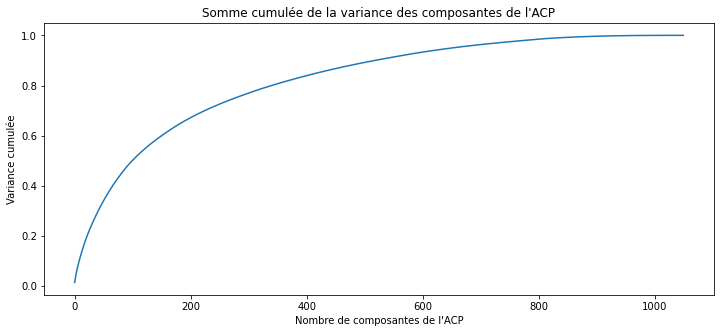

In [101]:
plt.figure(figsize=(12,5))
plt.title("Somme cumulée de la variance des composantes de l'ACP")
plt.xlabel("Nombre de composantes de l'ACP")
plt.ylabel('Variance cumulée')
plt.plot(list(range(X.shape[0])), np.cumsum(pca.explained_variance_ratio_))

In [102]:
sum_pca = np.cumsum(pca.explained_variance_ratio_)
for counter, value in enumerate(sum_pca):
    if value > 0.80:
        X_reduce = pca.transform(X)[:,:counter]
        break

In [103]:
print("Le nombre d'indicateurs (features) est de : {}, la variance est de : {}".format(counter+1,np.cumsum(pca.explained_variance_ratio_)[counter]))

Le nombre d'indicateurs (features) est de : 341, la variance est de : 0.8005382182865871


In [104]:
X_reduce.shape

(1050, 340)

In [105]:
#Nous sauvegardons le fichier
np.save('data_saved_X_reduce_NLP.csv', X_reduce)

In [106]:
dict_kmeans_nlp = {}

inertia_nlp = {}

max_clusters_nlp = 100


f = IntProgress(min = 1, max = max_clusters_nlp) #initiation
chaine = str(1) + '/' +  str(max_clusters_nlp)
g = Text(value=chaine)
display(f) #affichage
display(g)

for k in range(1,max_clusters_nlp):
    kmeans_nlp = KMeans(n_clusters = k, verbose = 0, random_state = 0).fit(X_reduce)
    inertia_nlp[k] = kmeans_nlp.inertia_
    dict_kmeans_nlp[k] = kmeans_nlp
    f.value = k #incrémentation
    g.value = str(k) + '/' + str(max_clusters_nlp)

IntProgress(value=1, min=1)

Text(value='1/100')

C:\Users\archi\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1332: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
C:\Users\archi\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1332: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
C:\Users\archi\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1332: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
C:\Users\archi\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1332: UserWarning: KMeans is known to have a memory leak on Window

C:\Users\archi\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:title={'center':'Kmeans: Comparaison de la somme des inerties en fonction du nombre de groupes (clusters)'}>

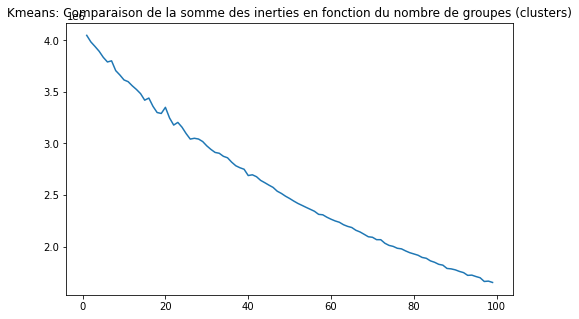

In [107]:
plt.figure(figsize=(8,5))
plt.title('Kmeans: Comparaison de la somme des inerties en fonction du nombre de groupes (clusters)')
sns.lineplot(list(inertia_nlp.keys()), list(inertia_nlp.values()))

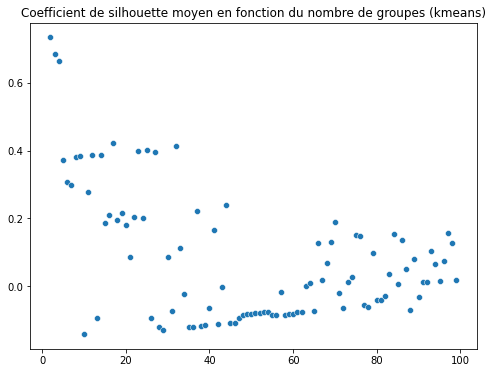

In [108]:
silhouettes_kmeans_nlp = {}
for i in range(2, max_clusters_nlp):
    silhouettes_kmeans_nlp[i] = silhouette_score(X = X_reduce, labels = list(dict_kmeans_nlp[i].labels_))

plt.figure(figsize = (8,6))
plt.title('Coefficient de silhouette moyen en fonction du nombre de groupes (kmeans)')
sns.scatterplot(x = list(silhouettes_kmeans_nlp.keys()), y = list(silhouettes_kmeans_nlp.values()))
plt.show()

In [109]:
for key, value in silhouettes_kmeans_nlp.items():
    if value == max(silhouettes_kmeans_nlp.values()):
        print('le coefficient de silhouette est maximal pour {} groupes (score = {})'.format(key, value))
        nb_clusters_optimal = key

le coefficient de silhouette est maximal pour 2 groupes (score = 0.7340870196872068)


In [110]:
if nb_clusters_optimal < 5: nb_clusters_optimal = 10

In [111]:
dict_kmeans_nlp[nb_clusters_optimal]

KMeans(n_clusters=10, random_state=0)

In [112]:
train_nlp = pd.concat([train, test]).copy()
train_nlp['label_kmeans'] = dict_kmeans_nlp[nb_clusters_optimal].labels_

In [113]:
groups_cat_kmeans_nlp = train_nlp[['cat_lvl_2', 'label_kmeans']].groupby('label_kmeans')
val_presence = []
for i in range(1,nb_clusters_optimal):
    val_presence.append(groups_cat_kmeans_nlp.get_group(i).groupby('cat_lvl_2').count().sort_values(by = 'label_kmeans', ascending=False).iloc[0].tolist()[0]/groups_cat_kmeans_nlp.get_group(i).groupby('cat_lvl_2').count().sum().values.tolist()[0]*100)

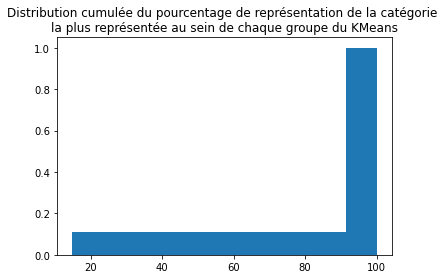

In [114]:
plt.title('Distribution cumulée du pourcentage de représentation de la catégorie \nla plus représentée au sein de chaque groupe du KMeans')
plt.hist(val_presence, cumulative = True, density = True, bins = nb_clusters_optimal)
plt.show()

### VII.Données visuelles  

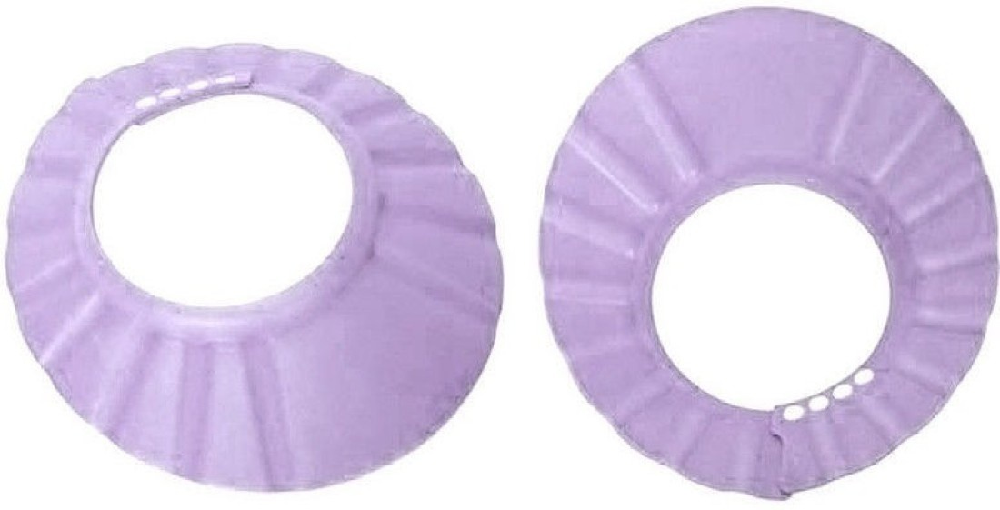

In [115]:
Image('./datasets/Images_P6/'+ str(df_P6.sample(1)['image'].values.tolist()[0]), width = 100 )

In [116]:
#Visualisation d'un echantillon de données
img_echantillon = df_P6.sample(50, random_state = 10)

In [117]:
img_echantillon

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,cat_lvl_1,cat_lvl_2,cat_lvl_3
775,93618b8a998782d4d847ee5cba5c7de2,2015-12-12 11:46:53 +0000,http://www.flipkart.com/carter-s-self-design-s...,Carter'S Self Design Single Blanket Multicolor,"[""Baby Care >> Baby Bedding >> Baby Blankets >...",BLAE7ZARKHFBHYE8,1599.0,980.0,93618b8a998782d4d847ee5cba5c7de2.jpg,False,Buy Carter'S Self Design Single Blanket Multic...,No rating available,No rating available,Carter'S,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Baby Care,Baby Bedding,Baby Blankets
806,9c06a95a82c3bd6635b9fe6e92b15902,2015-12-12 11:46:53 +0000,http://www.flipkart.com/mxofere-combo-papaya-m...,Mxofere Combo Papaya Mixfruit Almond Honey Ora...,"[""Beauty and Personal Care >> Combos and Kits ...",CBKEBVA8H7KPU6HK,285.0,285.0,9c06a95a82c3bd6635b9fe6e92b15902.jpg,False,Buy Mxofere Combo Papaya Mixfruit Almond Honey...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Organic Ty...",Beauty and Personal Care,Combos and Kits,Mxofere Combos and Kits
694,0ae859a69c7608d8197c3ba8c37bc6ec,2015-12-31 09:19:31 +0000,http://www.flipkart.com/tallenge-christmas-col...,Tallenge Christmas Collection - Echoes Of Wint...,"[""Home Decor & Festive Needs >> Wall Decor & C...",PTGEDZBHZHGW2H4H,2499.0,1799.0,0ae859a69c7608d8197c3ba8c37bc6ec.jpg,False,Tallenge Christmas Collection - Echoes Of Wint...,No rating available,No rating available,Tallenge,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Decor & Festive Needs,Wall Decor & Clocks,Paintings
370,b42a9b597a3a3dc8f428e2e2323e9aff,2015-12-01 06:13:00 +0000,http://www.flipkart.com/anna-andre-paris-flora...,Anna Andre Paris Floralina & Red Horizon Combo...,"[""Beauty and Personal Care >> Fragrances >> De...",CAGDTN27DEWJYUHK,355.0,249.0,b42a9b597a3a3dc8f428e2e2323e9aff.jpg,False,Flipkart.com: Buy Anna Andre Paris Floralina &...,4,4,NaN,"{""product_specification""=>[{""key""=>""Number of ...",Beauty and Personal Care,Fragrances,Deodorants
547,987e13b445c34bfedb9796d2bb78d593,2016-01-07 05:50:25 +0000,http://www.flipkart.com/maxima-01727lpln-mac-g...,Maxima 01727LPLN Mac Gold Analog Watch - For ...,"[""Watches >> Wrist Watches >> Maxima Wrist Wat...",WATDZ5HGF7WGCFGH,650.0,650.0,987e13b445c34bfedb9796d2bb78d593.jpg,True,Maxima 01727LPLN Mac Gold Analog Watch - For ...,5,5,NaN,"{""product_specification""=>[{""key""=>""Mechanism""...",Watches,Wrist Watches,Maxima Wrist Watches
244,0c4718ae90f2889b7021a99ee1cc106c,2015-12-01 12:40:44 +0000,http://www.flipkart.com/bergner-kadhai-na-l/p/...,Bergner Kadhai NA L,"[""Kitchen & Dining >> Cookware >> Pots & Pans ...",PTPECA2QYCZH8MBV,1499.0,1499.0,0c4718ae90f2889b7021a99ee1cc106c.jpg,False,"Bergner Kadhai NA L (Aluminium, Non-stick)\r\n...",No rating available,No rating available,Bergner,"{""product_specification""=>[{""key""=>""Pan Type"",...",Kitchen & Dining,Cookware,Pots & Pans
369,53c4f1e5cb1767f1a6ba05d32dfaf107,2015-12-01 06:13:00 +0000,http://www.flipkart.com/tenda-3g300m/p/itmdngv...,Tenda 3G300M,"[""Computers >> Network Components >> Routers >...",RTRDNGVMRQ63YU54,3000.0,1718.0,53c4f1e5cb1767f1a6ba05d32dfaf107.jpg,False,Buy Tenda 3G300M only for Rs. 3000 from Flipka...,4,4,Tenda,"{""product_specification""=>[{""key""=>""Wireless S...",Computers,Network Components,Routers
757,44a6d9f64668b004c3254f3904142064,2015-12-12 11:46:53 +0000,http://www.flipkart.com/svm-navratri-special-7...,SVM Navratri Special 7 Analog Watch - For Gir...,"[""Watches >> Wrist Watches >> SVM Wrist Watches""]",WATEB3ZEPX4XYBHG,2499.0,244.0,44a6d9f64668b004c3254f3904142064.jpg,False,SVM Navratri Special 7 Analog Watch - For Gir...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Chronograp...",Watches,Wrist Watches,SVM Wrist Watches
419,e365b55f806e5d0abe0094a9f2590e33,

In [118]:
img_echantillon['image'] = img_echantillon['image'].apply(lambda x: './datasets/Images_P6/' + str(x))

In [119]:
img_echantillon['image'].head(5)

775    ./datasets/Images_P6/93618b8a998782d4d847ee5cb...
806    ./datasets/Images_P6/9c06a95a82c3bd6635b9fe6e9...
694    ./datasets/Images_P6/0ae859a69c7608d8197c3ba8c...
370    ./datasets/Images_P6/b42a9b597a3a3dc8f428e2e23...
547    ./datasets/Images_P6/987e13b445c34bfedb9796d2b...
Name: image, dtype: object

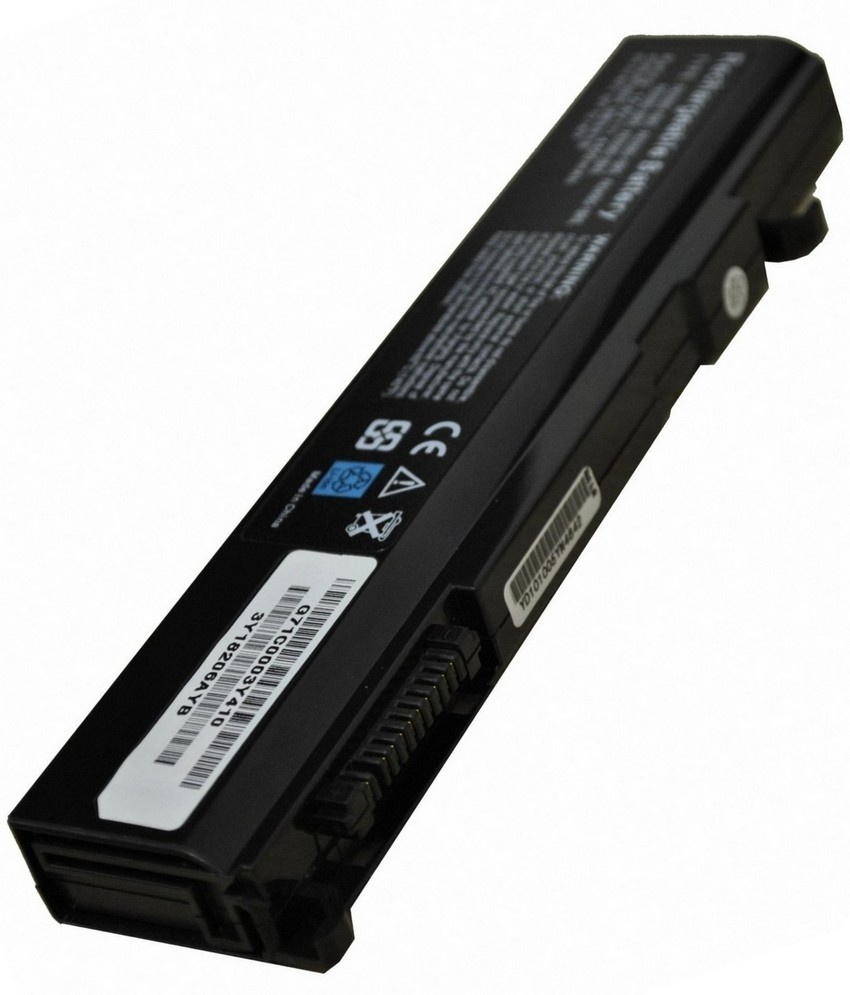

In [120]:
Image(img_echantillon.iloc[25]['image'], width = 150)

In [121]:
img_echantillon.iloc[25]

uniq_id                                     964648862f322b2cc153239af04b22ef
crawl_timestamp                                    2016-01-07 05:50:25 +0000
product_url                http://www.flipkart.com/arb-toshiba-dynabook-s...
product_name               ARB Toshiba Dynabook SS MX/395LS Compatible Bl...
product_category_tree      ["Computers >> Laptop Accessories >> Batteries...
pid                                                         ACCDY6GVZYHGRRPP
retail_price                                                          3499.0
discounted_price                                                      1599.0
image                      ./datasets/Images_P6/964648862f322b2cc153239af...
is_FK_Advantage_product                                                False
description                Buy ARB Toshiba Dynabook SS MX/395LS Compatibl...
product_rating                                           No rating available
overall_rating                                           No rating available

### VII.1.Essai de convolution

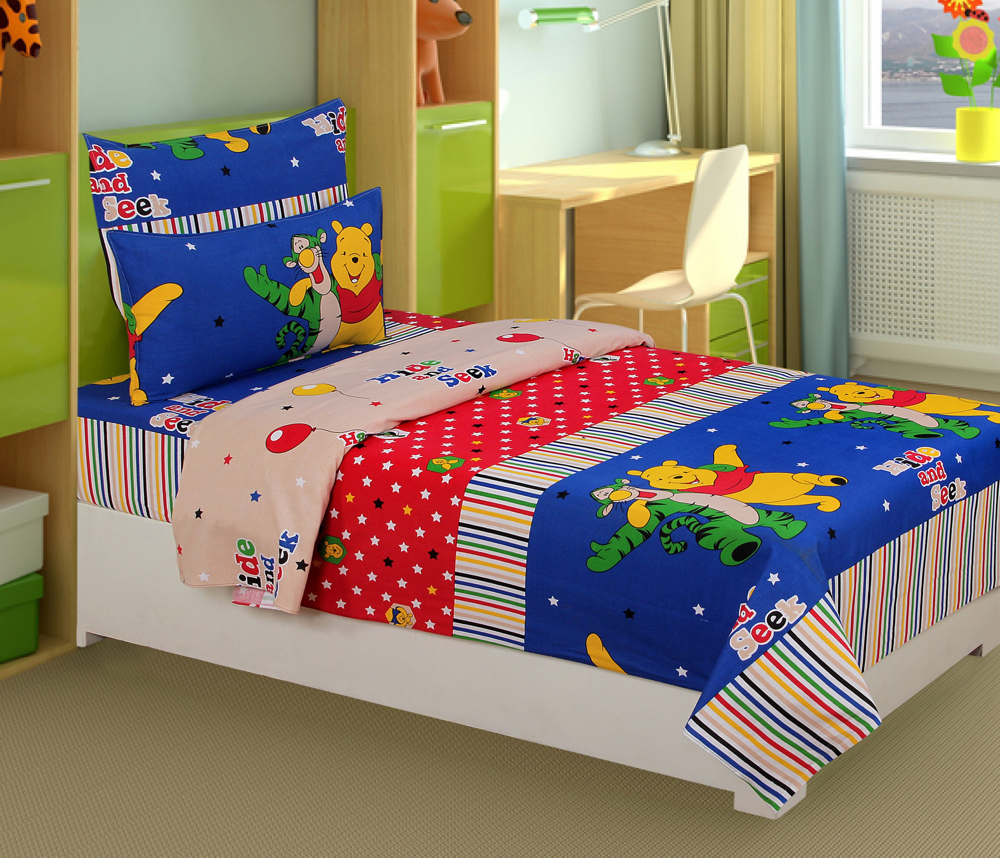

In [122]:
display(Image('./datasets/Images_P6/3e2b2a04696f7d83a7835e9894d79df7.jpg', width = 400))

In [123]:
img_conv = Image_PIL.open('./datasets/Images_P6/3e2b2a04696f7d83a7835e9894d79df7.jpg')

In [124]:
img_conv = np.array(img_conv)

In [125]:
img_conv = cv2.resize(img_conv, (400, 400))

In [126]:
def filtre_moyenneur(img, voisinage = 1):
    '''Remplace chaque pixel par l'intensité moyenne de son voisinage'''
    etendue = 1+2*voisinage
    img2 = np.copy(img)
    
    for i in range(0, img.shape[0]):
        for j in range(0, img.shape[1]):
            if (i<voisinage)|(i>img.shape[0] - voisinage-1):
                img2[i,j] = int(255/2)
            if (j<voisinage)|(j>img.shape[0] - voisinage-1):
                img2[i,j] = int(255/2)
            
            
    for i in range(voisinage,img.shape[0]-voisinage):
        for j in range(voisinage,img.shape[1]-voisinage):
            mean = 0
            for mean_x in range(i-voisinage, i+voisinage+1):
                for mean_y in range(j-voisinage, j+voisinage+1):
                    mean += img[mean_x, mean_y]
            img2[i,j] = mean/(etendue**2)
    
    
    return img2  

In [127]:
img_conv_traitee_1 = filtre_moyenneur(cv2.cvtColor(np.array(img_conv), cv2.COLOR_BGR2GRAY), voisinage = 1)
img_conv_traitee_2 = filtre_moyenneur(cv2.cvtColor(np.array(img_conv), cv2.COLOR_BGR2GRAY), voisinage = 2)
img_conv_traitee_3 = filtre_moyenneur(cv2.cvtColor(np.array(img_conv), cv2.COLOR_BGR2GRAY), voisinage = 3)
img_conv_traitee_4 = filtre_moyenneur(cv2.cvtColor(np.array(img_conv), cv2.COLOR_BGR2GRAY), voisinage = 4)

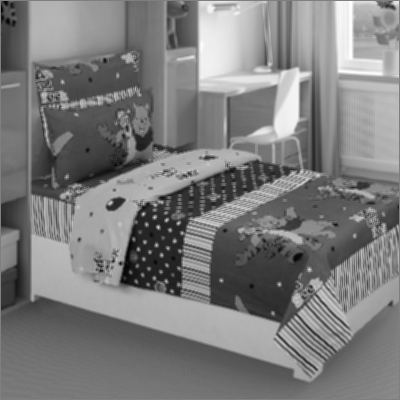

In [128]:
Image_PIL.fromarray(img_conv_traitee_1)

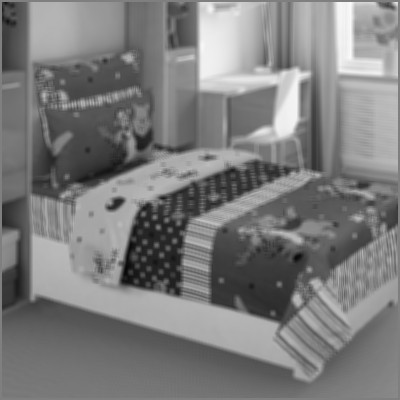

In [129]:
Image_PIL.fromarray(img_conv_traitee_2)

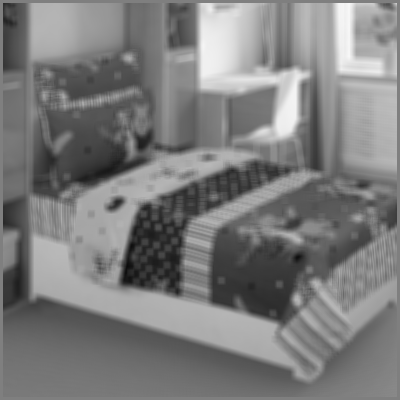

In [130]:
Image_PIL.fromarray(img_conv_traitee_3)

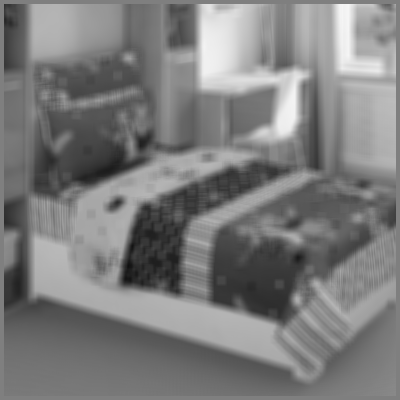

In [131]:
Image_PIL.fromarray(img_conv_traitee_4)

### VII.2.Prétraitement

### VII.2.1.Réduction de bruit

In [132]:
im = np.array(Image_PIL.open(img_echantillon.iloc[12]['image']))

In [133]:
im = gaussian_filter(im, sigma = 3)

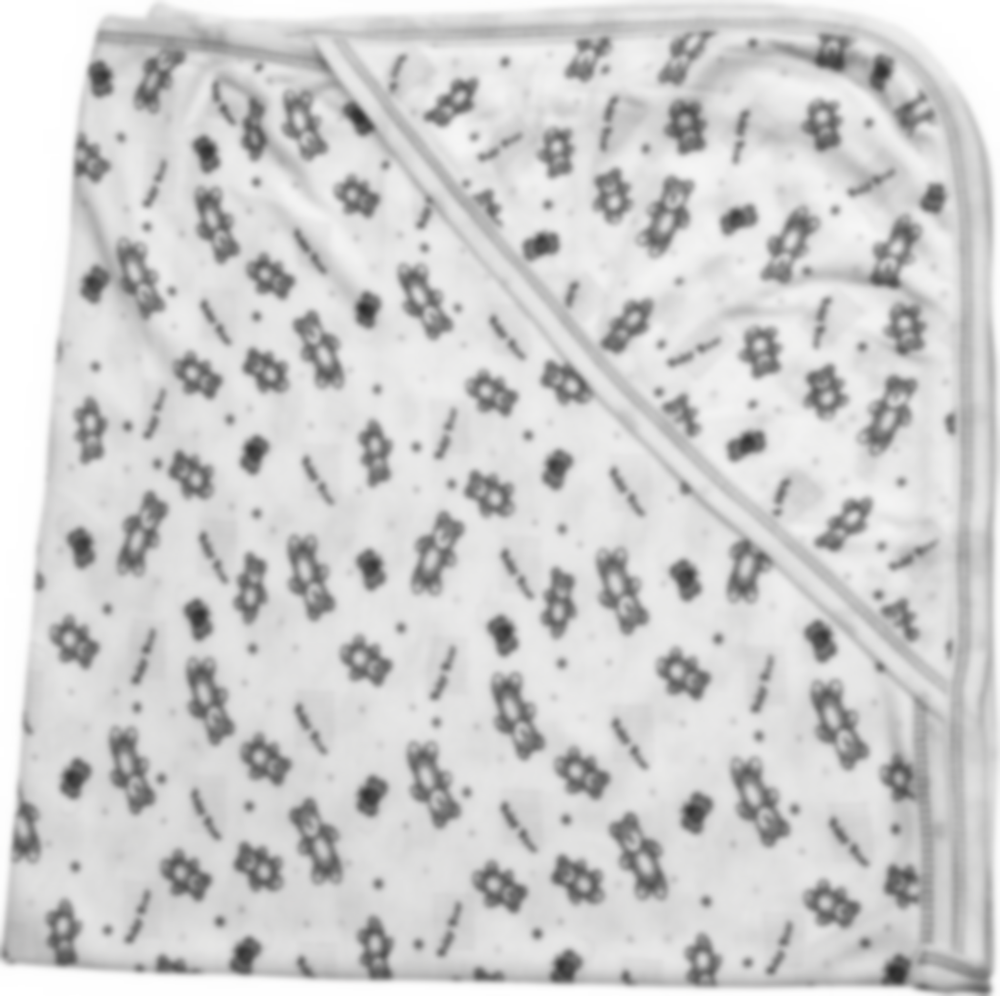

In [134]:
Image_PIL.fromarray(im)

In [135]:
hist, bins = np.histogram(im.flatten(), 256, [0, 256])
cdf = hist.cumsum()
cdf_normalized = cdf * hist.max() / cdf.max()

<Figure size 432x288 with 0 Axes>

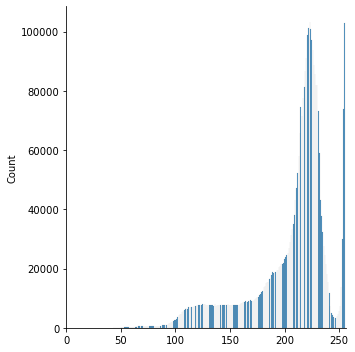

In [136]:
plt.figure(figsize = (6, 4))
sns.displot(im.flatten(), 256, [0,256])
plt.xlim([0, 256])
plt.show()

In [137]:
cdf_m = np.ma.masked_equal(cdf,0)
cdf_m = (cdf_m - cdf_m.min())*255/(cdf_m.max()-cdf_m.min())
cdf = np.ma.filled(cdf_m,0).astype('uint8')

In [138]:
im2 = cdf[im]

<Figure size 432x288 with 0 Axes>

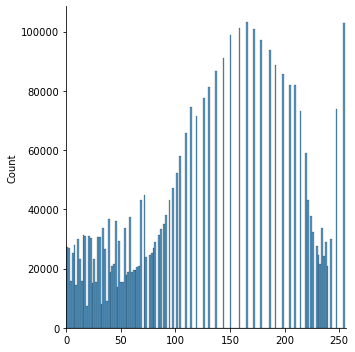

In [139]:
plt.figure(figsize = (6, 4))
sns.displot(im2.flatten(), 256, [0,256])
plt.xlim([0, 256])
plt.show()

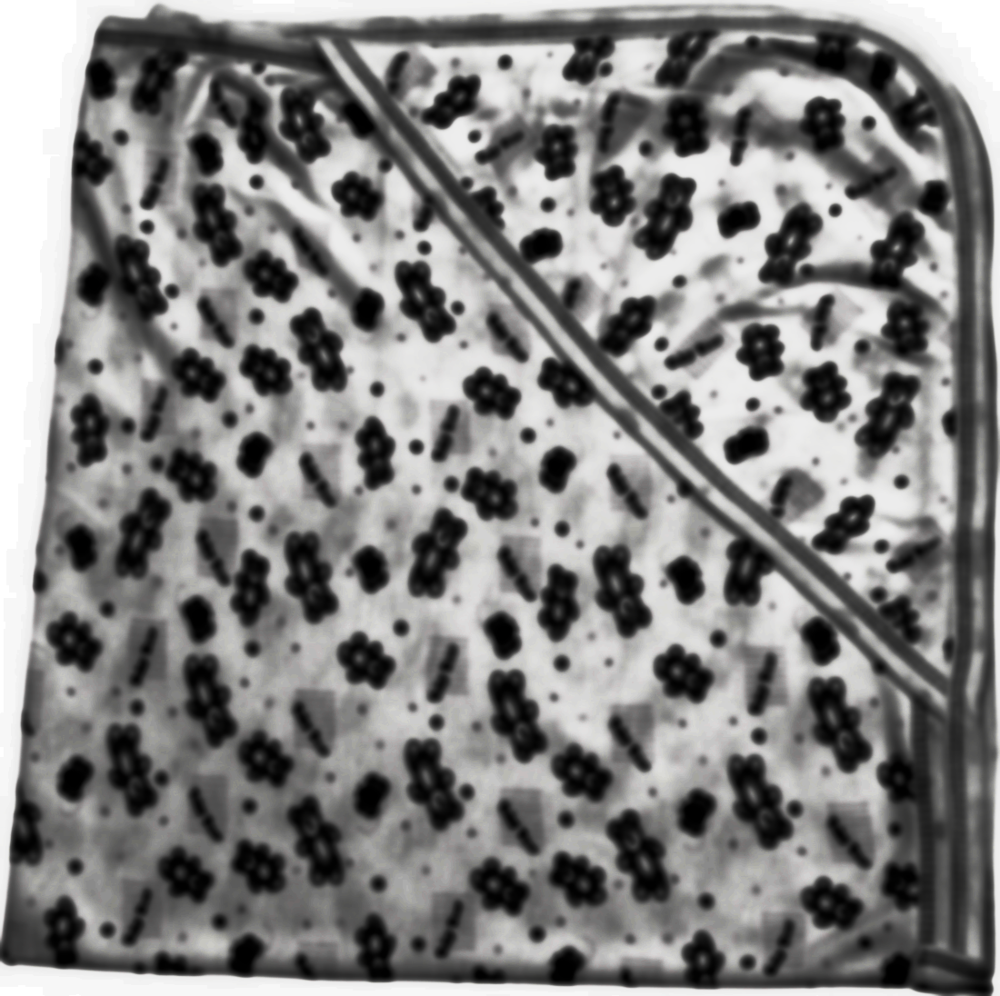

In [140]:
Image_PIL.fromarray(im2)

In [141]:
img3 = cv2.imread(img_echantillon.iloc[12]['image'],0)
equ = cv2.equalizeHist(img3)
res = np.hstack((img3,equ)) #sauvegarde image
cv2.imwrite('res.png',res)

True

In [142]:
img3.shape

(1096, 1100)

In [143]:
#Taille originelle des images
min_x = 100000
max_x = 0
min_y = 100000
max_y = 0
for image in img_echantillon['image'].tolist():
    shape = np.array(Image_PIL.open(image)).shape
    if shape[0] < min_x:
        min_x = shape[0]
    elif shape[0] > max_x:
        max_x = shape[0]
    if shape[1] < min_y:
        min_y = shape[1]
    elif shape[1] > max_y:
        max_y = shape[1]

In [144]:
print('min_x {},\nmax_x {},\nmin_y {},\nmax_y {}'.format(min_x, max_x, min_y, max_y))

min_x 286,
max_x 4098,
min_y 302,
max_y 2800


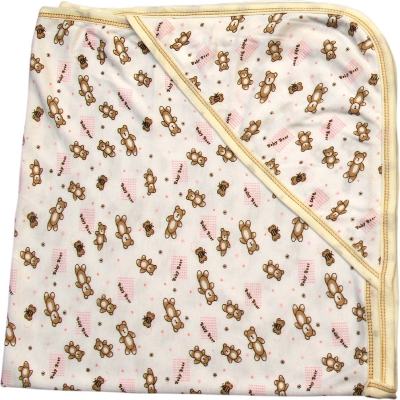

In [145]:
#Puis redimensionnement
resize_img = cv2.resize(np.array(Image_PIL.open(img_echantillon.iloc[12]['image'])), dsize = (128, 128)) #dsize = (400, 400))
Image_PIL.fromarray(resize_img)

In [146]:
def redim(array_im, width, height):
    '''Redimensionner l'image correspondant à array_im dans la largeur et la hauteur qui est définie'''
    min_x = 100000
    max_x = 0
    min_y = 100000
    max_y = 0
    shape = array_im.shape
    if shape[0] < min_x:
        min_x = shape[0]
    elif shape[0] > max_x:
        max_x = shape[0]
    if shape[1] < min_y:
        min_y = shape[1]
    elif shape[1] > max_y:
        max_y = shape[1]
    im = cv2.resize(array_im, dsize = (width, height))
    del shape
    return im

In [147]:
def preprocess(image, path = False):
    '''prétraitement des images:
    * filtre gaussian
    * égalisation de l'histogramme
    * redimensionnement
    prend un entrée le chemin vers l'image et en sortie la matrice np.array de l'image traitée
    '''
    #Ouverture du fichier
    if path == False: #si on a fourni un array en entree :
        im = image
    else: #si on a fourni un chemin vers le fichier en entree:
        im = np.array(Image_PIL.open(image))
    
    #Greyscale
    im = cv2.cvtColor(im,cv2.COLOR_BGR2GRAY)
    
    #Flou gaussien
    im = gaussian_filter(im, sigma=2)
    
    #Egalisation
    im = cv2.equalizeHist(im)
    
    return redim (im, 128, 128) #(im, 400, 400)

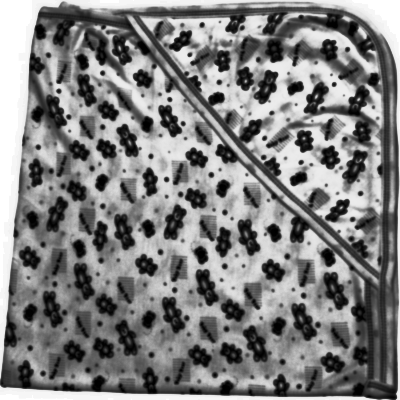

In [148]:
Image_PIL.fromarray(preprocess(img_echantillon.iloc[12]['image'], path = True))

### VII.2.2.Extraction des caractéristiques (SIFT/ORB/SURF) 

In [149]:
i = np.random.randint(img_echantillon.shape[0]-1)
img_sift = preprocess(img_echantillon.iloc[12]['image'], path = True)

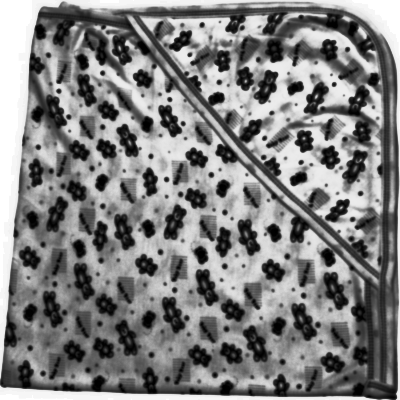

In [150]:
Image_PIL.fromarray(img_sift)

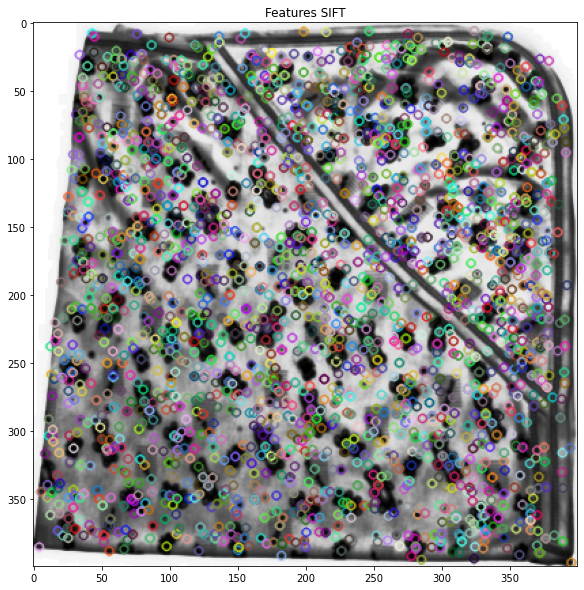

In [151]:
sift = cv2.SIFT_create()
kp = sift.detect(img_sift, None)
img=cv2.drawKeypoints(img_sift, kp,img_sift)

plt.figure(figsize = (10, 10))
plt.title('Features SIFT')
plt.imshow(img)

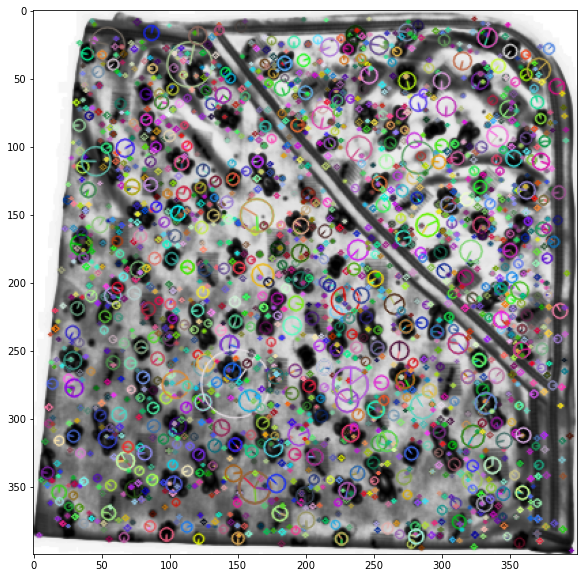

In [152]:
img = cv2.drawKeypoints(img_sift,kp,img_sift,flags = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
plt.figure(figsize = (10, 10))
plt.imshow(img)

In [153]:
img_orb = preprocess(img_echantillon.iloc[i]['image'], path = True)

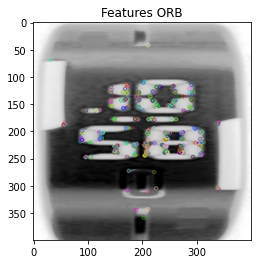

In [154]:
orb = cv2.ORB_create()

#Trouver les points clés et les descripteurs
kp, des = orb.detectAndCompute(img_orb, mask = None)

#Dessiner l'emplacement des points clés (taille et orientation)
image_orb = cv2.drawKeypoints(img_orb, kp, outImage = True, flags = 2)
plt.title('Features ORB')
plt.imshow(image_orb)
plt.show()

In [155]:
len(kp)

481

In [156]:
des.shape

(481, 32)

In [ ]:
img_surf = preprocess(img_echantillon.iloc[12]['image'], path=True)
surf = cv2.xfeatures2d.SURF_create()
kp = surf.detect(img_surf,None)
image_surf = cv2.drawKeypoints(img_surf, kp, outImage = True, flags = 2)
plt.figure(figsize = (10, 10))
plt.title('Features SURF')
plt.imshow(image_surf)

In [ ]:
kp_surf, des_surf = sift.detectAndCompute(img_surf, None)

In [ ]:
des_surf[0].shape

In [157]:
def get_files(path_list):
    '''Renvoie la liste des matrices d'images à partir d'une liste de chemins'''
    liste_image = []
    compteur = 0
    for image_path in path_list:
        #im = cv2imread(image_path, 0)
        im = np.array(Image_PIL.open(image_path))
        liste_image.append(im)
        compteur +=1
    return liste_image

In [158]:
def create_features():
    '''Initialiser un algorithme SIFT'''
    return cv2.SIFT_create()

In [159]:
def features(sift, image):
    '''Renvoie les keypoints et descripteurs d'une image à partir du détecteur sift'''
    keypoints,descriptors = sift.detectAndCompute(image,None)
    return [keypoints, descriptors]

In [160]:
def pipeline_feature(image):
    '''traitement complet d'une image : 
    *initialise l'algorithme, 
    *prétraite l'image, 
    *recherche les features
    *retourne les features'''
    sift = create_features()
    image = preprocess(image, path = False)
    #gr = grey(image)
    keypoints, descriptors = features(sift, image)
    return keypoints, descriptors

In [ ]:
#Vérifions que tout fonctionne
image_essai = get_files(img_echantillon['image'])[1]

In [ ]:
plt.imshow(image_essai)

In [161]:
j = 0

echantillon = get_files(img_echantillon['image'].tolist())
max_count = len(echantillon)
f = IntProgress(min = 0, max = max_count) #initialisation
chaine = str(0) + '/' + str(max_count)
g = Text(value=chaine)
display(f) #affichage
display(g)
liste_keypoints = []
liste_descripteurs = []


for array_image in echantillon:
    j+=1
    kea,des = pipeline_feature(array_image)
    liste_keypoints.append(kea)
    liste_descripteurs.append(des)
    f.value = j #visualisation de l'avancemant de l'acrémentation
    g.value = str(j) + '/' + str(max_count)

IntProgress(value=0, max=50)

Text(value='0/50')

In [162]:
liste_descripteurs[0]

array([[ 36.,   0.,   0., ...,   0.,   0.,   0.],
       [ 62.,  12.,   0., ...,   0.,   0.,   4.],
       [  9., 146.,  54., ...,   0.,   0.,  10.],
       ...,
       [  0.,   8.,  19., ...,   0.,   0.,   7.],
       [  0.,   0.,  25., ...,   0.,  11., 153.],
       [  8.,  51.,   3., ...,   0.,   0.,   0.]], dtype=float32)

In [ ]:
liste_descripteurs[0].shape

In [163]:
liste_descripteurs[0].reshape(1, -1)

array([[36.,  0.,  0., ...,  0.,  0.,  0.]], dtype=float32)

In [164]:
print('Nombre de liste de points-clés : ', len(liste_keypoints))
print("Nombre de points-clés pour l'élément 0 : ", len(liste_keypoints[0]))
print("Nombre de points-clés pour l'élément 2 : ", len(liste_keypoints[2]))

Nombre de liste de points-clés :  50
Nombre de points-clés pour l'élément 0 :  1346
Nombre de points-clés pour l'élément 2 :  171


In [165]:
print('Dimension descripteurs élément 0 : ', liste_descripteurs[0].shape)
print('Dimension descripteurs élément 1 : ', liste_descripteurs[1].shape)

Dimension descripteurs élément 0 :  (1346, 128)
Dimension descripteurs élément 1 :  (387, 128)


In [166]:
for el, ech in zip(liste_descripteurs, echantillon):
    print(el.shape, ' - ', ech.shape)

(1346, 128)  -  (2224, 2208, 3)
(387, 128)  -  (496, 1238, 3)
(171, 128)  -  (1100, 1000, 3)
(348, 128)  -  (1100, 612, 3)
(152, 128)  -  (1360, 472, 3)
(418, 128)  -  (1488, 2800, 3)
(234, 128)  -  (1211, 739, 3)
(1930, 128)  -  (4098, 1514, 3)
(90, 128)  -  (773, 756, 3)
(470, 128)  -  (1200, 900, 3)
(1095, 128)  -  (1950, 1938, 3)
(507, 128)  -  (1100, 409, 3)
(2426, 128)  -  (1096, 1100, 3)
(390, 128)  -  (1000, 668, 3)
(1107, 128)  -  (921, 1100, 3)
(1403, 128)  -  (1100, 1074, 3)
(572, 128)  -  (2000, 1640, 3)
(826, 128)  -  (1223, 1067, 3)
(165, 128)  -  (993, 1100, 3)
(1547, 128)  -  (3558, 2356, 3)
(150, 128)  -  (995, 417, 3)
(357, 128)  -  (1100, 1031, 3)
(606, 128)  -  (1000, 880, 3)
(200, 128)  -  (1440, 1068, 3)
(777, 128)  -  (890, 592, 3)
(768, 128)  -  (995, 850, 3)
(1367, 128)  -  (1312, 852, 3)
(200, 128)  -  (286, 416, 3)
(921, 128)  -  (1100, 815, 3)
(251, 128)  -  (1100, 1000, 3)
(409, 128)  -  (1100, 1068, 3)
(87, 128)  -  (1000, 302, 3)
(669, 128)  -  (2012, 129

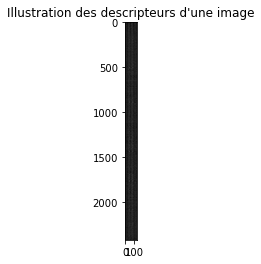

In [167]:
plt.title("Illustration des descripteurs d'une image")
plt.imshow(liste_descripteurs[12], cmap = 'gray')

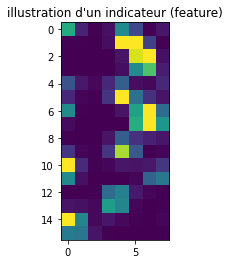

In [168]:
plt.figure(figsize = (4, 4))
plt.title("illustration d'un indicateur (feature)")
plt.imshow(liste_descripteurs[0][12].reshape(16, 8))

In [169]:
def extraction_features(data_visu):
    '''Extraction des indicateurs (features) à partir des données'''
    
    #Chargement des images
    data_visu['image'] = data_visu['image'].apply(lambda x: "./datasets/Images_P6/" + str(x))
    liste_images = get_files(data_visu['image'].tolist())
    max_count = len(liste_images)
    
    #Affichage du compteur
    f = IntProgress(min=0, max=max_count) #initiation
    chaine = str(0)+'/'+str(max_count)
    g = Text(value=chaine)
    display(f) #affichage
    display(g)
    liste_features = []
    liste_descripteurs = []
    liste_descripteurs_formates = []

    #Boucle d'extraction des indicateurs (features) de chaque image
    j = 0
    for array_image in liste_images:
        j += 1
        fea, des = pipeline_feature(array_image)
        liste_features.append(fea)
        liste_descripteurs.append(des)
        f.value = j #affichage de l'avancement de l'incrémentation
        g.value = str(j)+'/'+str(max_count)
    
    #Harmonisation du nombre d'indicateurs (features) par image : détermination dimension maximum
    nb_features_max = 0
    for descripteur in liste_descripteurs:
        if descripteur.shape[0] > nb_features_max:
            nb_features_max = descripteur.shape[0]
    
    #Transformer les array des descripteurs en vecteurs (PM : un descripteur = 128 pixels de large)
    liste_descripteurs_flatten = []
    for descripteur in liste_descripteurs:
        liste_descripteurs_flatten.append(descripteur.reshape(1,-1))   
    
    #Harmonisation du nombre d'indicateurs (features) par image : ajout de pixels noirs
    k = 0
    for descripteur in liste_descripteurs_flatten:
        if descripteur.shape[1] <= nb_features_max*128:
            liste_descripteurs_formates.append(
                np.hstack([descripteur.reshape(1,-1), 
                           np.zeros(nb_features_max*128 - descripteur.shape[1]).reshape(1,-1)]))        
        else:
            liste_descripteurs_formates.append(descripteur)
            
    #Assemblage_features
    array_descripteurs = np.vstack(liste_descripteurs_formates)
    
    del liste_descripteurs_formates, descripteur, liste_images, max_count
    
    
    return liste_features, liste_descripteurs, array_descripteurs

In [170]:
data_visuelle = pd.concat([train, test]).copy()

features_total, descripteurs_total, descripteurs_array = extraction_features(data_visuelle)

C:\Users\archi\anaconda3\lib\site-packages\PIL\Image.py:2918: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


IntProgress(value=0, max=1050)

Text(value='0/1050')

In [171]:
descripteurs_array.shape

(1050, 618496)

In [172]:
descripteurs_array[0,:]

array([51., 20.,  0., ...,  0.,  0.,  0.])

(1050, 618496)


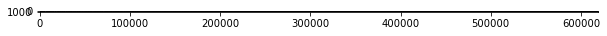

In [173]:
print(descripteurs_array.shape)
plt.figure(figsize = (10, 10))
plt.imshow(descripteurs_array, cmap = 'gray')

In [174]:
descripteurs_total[0].shape

(195, 128)

In [175]:
np.var(descripteurs_total[0])

1582.4186

In [176]:
liste_min = [np.min(descripteur) for descripteur in descripteurs_total]
liste_max = [np.max(descripteur) for descripteur in descripteurs_total]
liste_mean = [np.mean(descripteur) for descripteur in descripteurs_total]
liste_var = [np.var(descripteur) for descripteur in descripteurs_total]
liste_order_3 = [np.mean(moment(descripteur, moment = 3, axis = 1)) for descripteur in descripteurs_total]
liste_order_4 = [np.mean(moment(descripteur, moment = 4, axis = 1)) for descripteur in descripteurs_total]

In [177]:
array_features_descripteurs = np.vstack([liste_min, liste_max, liste_mean, liste_var, liste_order_3, liste_order_4])

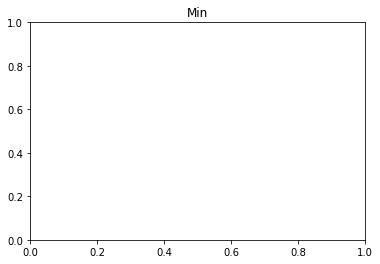

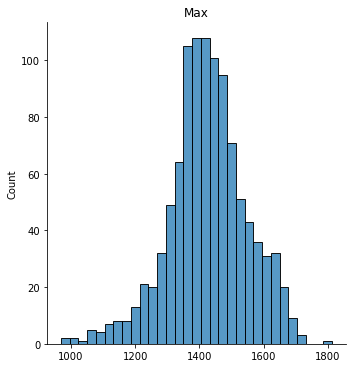

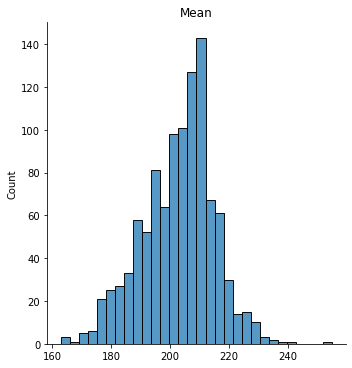

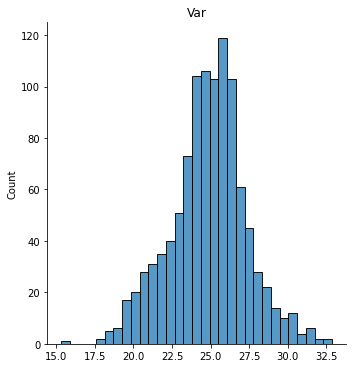

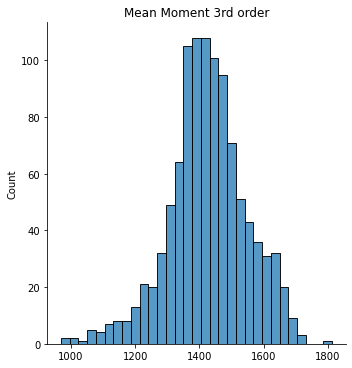

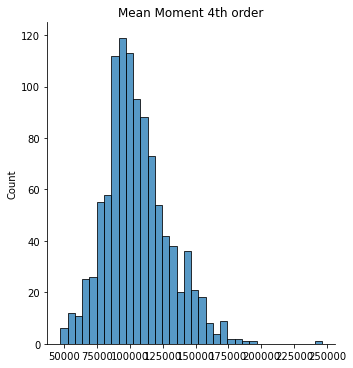

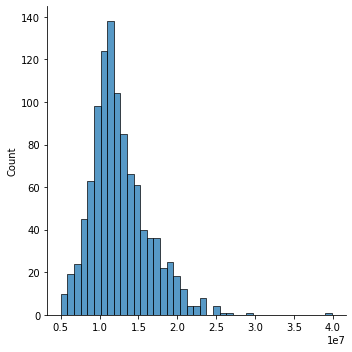

In [178]:
plt.figure()
plt.title('Min')
sns.displot(liste_var)


plt.title('Max')
sns.displot(liste_max)


plt.title('Mean')
sns.displot(liste_mean)


plt.title('Var')
sns.displot(liste_var)


plt.title('Mean Moment 3rd order')
sns.displot(liste_order_3)

plt.title('Mean Moment 4th order')
sns.displot(liste_order_4)

In [179]:
#Sauvegarde des nouvelles données
np.save('./datasets/data_saved_array_descripteurs.csv', descripteurs_array)
np.save('./datasets/data_saved_array_features_descripteurs', array_features_descripteurs)

### VII.3.Classifieur non supervisé 

### VII.3.1.ACP 

In [180]:
pca_descripteurs = PCA()
features_ss = StandardScaler()
pca_descripteurs.fit(features_ss.fit_transform(np.transpose(descripteurs_array.T)))

PCA()

In [181]:
pca_descripteurs.n_components_

1050

In [182]:
np.cumsum(pca_descripteurs.explained_variance_ratio_)

array([0.20445115, 0.30029065, 0.35907424, ..., 1.        , 1.        ,
       1.        ])

In [183]:
list(range(descripteurs_array.shape[0]))

[0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 71,
 72,
 73,
 74,
 75,
 76,
 77,
 78,
 79,
 80,
 81,
 82,
 83,
 84,
 85,
 86,
 87,
 88,
 89,
 90,
 91,
 92,
 93,
 94,
 95,
 96,
 97,
 98,
 99,
 100,
 101,
 102,
 103,
 104,
 105,
 106,
 107,
 108,
 109,
 110,
 111,
 112,
 113,
 114,
 115,
 116,
 117,
 118,
 119,
 120,
 121,
 122,
 123,
 124,
 125,
 126,
 127,
 128,
 129,
 130,
 131,
 132,
 133,
 134,
 135,
 136,
 137,
 138,
 139,
 140,
 141,
 142,
 143,
 144,
 145,
 146,
 147,
 148,
 149,
 150,
 151,
 152,
 153,
 154,
 155,
 156,
 157,
 158,
 159,
 160,
 161,
 162,
 163,
 164,
 165,
 166,
 167,
 168,
 169,
 170,
 171,
 172,
 173,
 174,
 175,
 176,
 177,
 178,
 179,
 180,
 181,
 182,
 183,
 184,


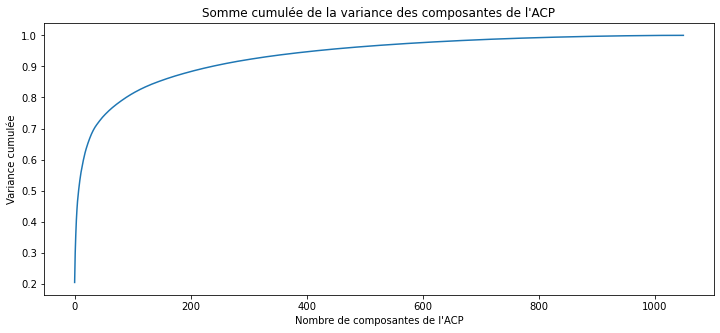

In [184]:
plt.figure(figsize = (12, 5))
plt.title("Somme cumulée de la variance des composantes de l'ACP")
plt.xlabel("Nombre de composantes de l'ACP")
plt.ylabel('Variance cumulée')
plt.plot(list(range(descripteurs_array.shape[0])), np.cumsum(pca_descripteurs.explained_variance_ratio_))

In [ ]:
np.cumsum(pca_descripteurs.explained_variance_ratio_)[650]

In [185]:
np.cumsum(pca_descripteurs.explained_variance_ratio_)[:650]

array([0.20445115, 0.30029065, 0.35907424, 0.40573218, 0.43933389,
       0.46595194, 0.4858245 , 0.50318581, 0.51904977, 0.53363855,
       0.5474733 , 0.55895331, 0.56916294, 0.579085  , 0.58874483,
       0.59789109, 0.60652207, 0.61457776, 0.62220841, 0.62922798,
       0.63562498, 0.64176181, 0.64750465, 0.6530713 , 0.6585369 ,
       0.663691  , 0.66859853, 0.67339974, 0.67799698, 0.68232779,
       0.68642088, 0.69033619, 0.69400765, 0.69745262, 0.70079579,
       0.70392619, 0.70681775, 0.7095882 , 0.71220691, 0.71481398,
       0.71733639, 0.71982907, 0.72228008, 0.72471438, 0.72709689,
       0.72944191, 0.73174723, 0.73404566, 0.73626567, 0.7383638 ,
       0.74041713, 0.74242467, 0.74438059, 0.7462979 , 0.74819683,
       0.75007028, 0.75190894, 0.75373455, 0.75550961, 0.75727527,
       0.75900706, 0.76069147, 0.76236873, 0.76402412, 0.76566153,
       0.76725937, 0.76881948, 0.77036054, 0.77188106, 0.77338659,
       0.77488607, 0.77636584, 0.77781589, 0.7792482 , 0.78067

In [186]:
array_descripteurs_reduit = pca_descripteurs.transform(descripteurs_array[:650,:])

In [187]:
array_descripteurs_reduit.shape

(650, 1050)

In [188]:
np.save('./datasets/data_saved_array_descripteurs_reduit.csv', array_descripteurs_reduit)

In [189]:
dict_kmeans = {}
inertia = {}
max_clusters = 80

f = IntProgress(min = 0, max = max_clusters) #initialisation
chaine = str(0) + '/' + str(max_count)
g = Text(value = chaine)
display(f) #affichage
display(g)

for k in range(1, max_clusters + 1):
    kmeans = KMeans(n_clusters = k,
                   verbose = 0,
                   random_state = 0).fit(array_descripteurs_reduit)
    inertia[k] = kmeans.inertia_
    dict_kmeans[k] = kmeans
    f.value = k #affichage de l'avancement de l'incrémentation
    g.value =str(k+1) + '/' + str(max_clusters)

IntProgress(value=0, max=80)

Text(value='0/50')

C:\Users\archi\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1332: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(
C:\Users\archi\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1332: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(
C:\Users\archi\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1332: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(
C:\Users\archi\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1332: UserWarning: KMeans is known to have a memory leak on Window

C:\Users\archi\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:title={'center':'K-means: Comparaison de la somme des inerties en fonction du nombre de groupes (clusters)'}>

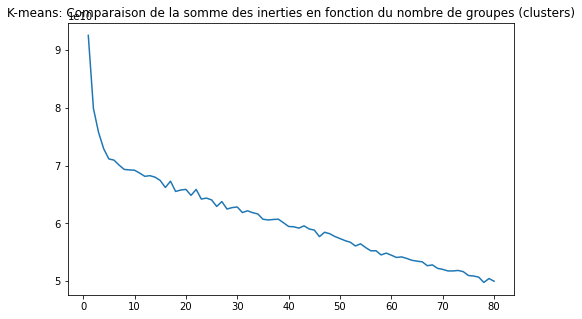

In [190]:
plt.figure(figsize = (8, 5))
plt.title('K-means: Comparaison de la somme des inerties en fonction du nombre de groupes (clusters)')
sns.lineplot(list(inertia.keys()), list(inertia.values()))

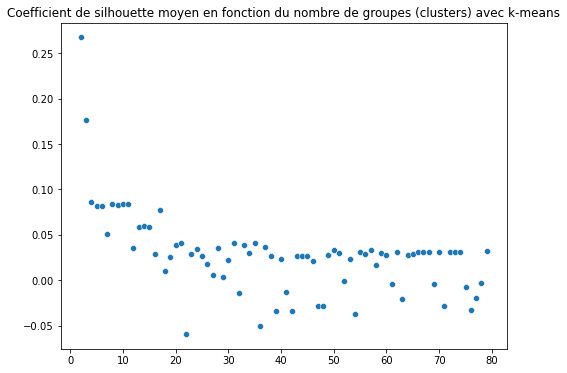

In [191]:
silhouettes_kmeans = {}
for i in range(2,max_clusters):
    silhouettes_kmeans[i] = silhouette_score(X = array_descripteurs_reduit, labels = list(dict_kmeans[i].labels_))

plt.figure(figsize = (8, 6)),
plt.title('Coefficient de silhouette moyen en fonction du nombre de groupes (clusters) avec k-means')
sns.scatterplot(x = list(silhouettes_kmeans.keys()),
               y = list(silhouettes_kmeans.values()))
plt.show()

In [192]:
for key, value in silhouettes_kmeans.items():
    if value == max(silhouettes_kmeans.values()):
        print('Le coefficient de silhouette est maximal pour {} groupes (score = {})'.format(key, value))
        nb_clusters = key

Le coefficient de silhouette est maximal pour 2 groupes (score = 0.2672249653482949)


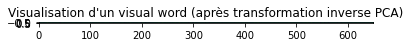

In [193]:
plt.title("Visualisation d'un visual word (après transformation inverse PCA)")
plt.imshow(np.dot(dict_kmeans[25].cluster_centers_[4], pca_descripteurs.components_[:, :650]).reshape(1,-1))

In [ ]:
plt.title("Visualisation d'un visual word (après transformation inverse PCA)")
plt.imshow(np.dot(dict_kmeans[25].cluster_centers_[4], pca_descripteurs.components_[:, :650]).reshape(26, 25))

### VIII.CNN Données visuelles 

In [194]:
def get_files(path_list):
    '''Renvoie la liste des matrices d'images à partir d'une liste de chemins'''
    liste_image = []
    compteur = 0
    for image_path in path_list:
        im = np.array(Image_PIL.open(image_path))
        liste_image.append(im)
        compteur += 1
    
    del compteur
    del im
    
    return liste_image

In [195]:
def redim(array_im, width, height):
    '''Redimensionne l'image correspondant à array_im dans la largeur et la hauteur définie'''
    min_x = 100000
    max_x = 0
    min_y = 100000
    max_y = 0
    shape = array_im.shape
    if shape[0] < min_x:
        min_x = shape[0]
    elif shape[0] > max_x:
        max_x = shape[0]
    if shape[1] < min_y:
        min_y = shape[1]
    elif shape[1] > max_y:
        max_y = shape[1]
    im = cv2.resize(array_im, dsize=(width,height))
    
    del shape
    
    return im

In [196]:
train['image'] = train['image'].apply(lambda x: "./datasets/Images_P6/" + str(x))
test['image'] = test['image'].apply(lambda x: "./datasets/Images_P6/" + str(x))

In [197]:
train_cnn = get_files(train.copy()['image'].tolist())
test_cnn = get_files(test.copy()['image'].tolist())

C:\Users\archi\anaconda3\lib\site-packages\PIL\Image.py:2918: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


In [198]:
len(train_cnn)

787

In [199]:
len(test_cnn)

263

In [200]:
train_cnn[0]

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]

In [201]:
redim(train_cnn[0], 128, 128).shape

(128, 128, 3)

In [202]:
redim(train_cnn[0], 128, 128).reshape(1,-1,3).shape

(1, 16384, 3)

In [203]:
train_array_cnn = np.vstack([redim(img, 128, 128).reshape(1,128,128,3) for img in train_cnn])
test_array_cnn = np.vstack([redim(img, 128, 128).reshape(1,128,128,3) for img in test_cnn])

In [204]:
train_array_cnn.shape

(787, 128, 128, 3)

In [205]:
ohe = OneHotEncoder(handle_unknown = 'ignore')
array_cats = ohe.fit_transform(np.array(train['cat_lvl_2']).reshape(-1,1))

In [206]:
array_cats.todense().shape

(787, 57)

In [207]:
array_cats.shape

(787, 57)

In [208]:
train_array_cats = ohe.transform(train[['cat_lvl_2']]).todense()
test_array_cats = ohe.transform(test[['cat_lvl_2']]).todense()

C:\Users\archi\anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but OneHotEncoder was fitted without feature names
  warnings.warn(
C:\Users\archi\anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but OneHotEncoder was fitted without feature names
  warnings.warn(


In [209]:
ohe.categories_

[array(['Baby & Kids Gifts', 'Baby Bath & Skin', 'Baby Bedding',
        'Baby Grooming', 'Bar & Glassware', 'Bath Linen', 'Bath and Spa',
        'Bed Linen', 'Body and Skin Care', 'Candles & Fragrances',
        'Clocks', 'Coffee Mugs', 'Combos and Kits', 'Computer Components',
        'Computer Peripherals', 'Containers & Bottles', 'Cookware',
        'Curtains & Accessories', 'Cushions, Pillows & Covers',
        'Decorative Lighting & Lamps', 'Diapering & Potty Training',
        'Dinnerware & Crockery', 'Eye Care', 'Feeding & Nursing',
        'Floor Coverings', 'Flowers, Plants & Vases', 'Fragrances',
        'Furniture & Furnishings', 'Garden & Leisure', 'Hair Care',
        'Health Care', 'Housekeeping & Laundry', 'Infant Wear',
        'Kitchen & Dining Linen', 'Kitchen Tools',
        "Kripa's Home Furnishing", 'Laptop Accessories', 'Laptops',
        'Lighting', 'Living', 'Living Room Furnishing', 'Makeup',
        'Network Components', 'Pressure Cookers & Pans',
        'R

### VIII.1.Construction du réseau 

In [210]:
model = Sequential()
model.add(Conv2D(32, kernel_size = (3, 3), padding = 'same', activation = 'relu', input_shape = (128, 128, 3)))
model.add(MaxPooling2D(pool_size = (2, 2)))
model.add(Conv2D(32, kernel_size = (3, 3), padding = 'same', activation = 'relu'))
model.add(MaxPooling2D(pool_size = (2, 2)))
model.add(Flatten())
model.add(Dense(ohe.categories_[0].shape[0], activation = 'softmax'))
model.compile(loss = 'mean_squared_error', optimizer = 'sgd')

In [211]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 64, 64, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 32)        9248      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 32, 32, 32)       0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 32768)             0         
                                                                 
 dense (Dense)               (None, 57)                1

### VIII.2.Entrainement 

In [212]:
train_array_cnn.shape

(787, 128, 128, 3)

In [213]:
model_info = model.fit(train_array_cnn, train_array_cats, epochs = 3, batch_size = 40, verbose = 2)

Epoch 1/3
20/20 - 6s - loss: 0.0349 - 6s/epoch - 313ms/step
Epoch 2/3
20/20 - 6s - loss: 0.0350 - 6s/epoch - 313ms/step
Epoch 3/3
20/20 - 6s - loss: 0.0344 - 6s/epoch - 299ms/step


In [214]:
for couche in model.get_weights():
    print(couche.shape)

(3, 3, 3, 32)
(32,)
(3, 3, 32, 32)
(32,)
(32768, 57)
(57,)


In [215]:
predictions_test = model.predict(test_array_cnn)

9/9 [==============================] - 1s 57ms/step


In [216]:
accuracy_score(np.argmax(predictions_test, axis=1).reshape(-1,1), np.argmax(test_array_cats, axis=1).reshape(-1,1))

0.049429657794676805

In [217]:
np.argmax(test_array_cats, axis = 1).reshape(1, -1)

matrix([[42, 38, 36, 26, 56, 32, 46, 14,  7,  7, 56,  1, 11,  6, 51, 36,
         32, 36,  5, 17, 16, 36, 32, 36, 56, 12, 19,  0, 26, 11, 11, 42,
         36, 56, 50,  7, 56, 46, 46, 42, 18, 41, 38, 17, 41, 34, 16, 48,
          0,  7, 11, 46, 15, 39, 42, 32, 29, 34, 51, 39,  5,  0, 56, 16,
         56,  5,  0, 19,  7, 56, 32, 36, 42, 36, 56, 42,  7, 46, 36,  7,
         33,  5, 42, 34, 42, 56, 24, 19, 46, 50, 40,  7, 11, 46, 56, 36,
         32, 56, 46, 32,  0, 56, 54, 40, 36, 56,  6, 15,  7, 36, 34,  7,
          7, 32,  1, 23, 36, 56, 56, 36, 42, 36, 54,  5, 11, 19, 12, 46,
         23,  1, 16, 41,  0, 46,  3, 11, 50, 12, 11, 36, 11,  2, 46, 33,
         17, 56, 56, 26, 50,  0, 56, 26, 56, 54, 42,  5, 56,  8, 54, 56,
         56, 56,  1, 36, 46, 56, 56, 42, 56, 36, 56, 26, 17, 56, 32, 56,
         46, 46,  7, 46, 32, 11, 17, 54, 32, 26, 27, 56, 36, 18, 26, 56,
         15, 17, 11, 14, 26, 16, 42, 42, 26, 32, 33, 42, 26, 54, 56, 32,
         20, 46, 56, 50, 36, 36, 17, 12, 32,  7, 46

In [218]:
np.argmax(predictions_test, axis = 1)

array([26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26,
       26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26,
       26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26,
       26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26,
       26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26,
       26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26,
       26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26,
       26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26,
       26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26,
       26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26,
       26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26,
       26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26,
       26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26,
       26, 26, 26, 26, 26

In [219]:
ohe.categories_[0][25]

'Flowers, Plants & Vases'

### VIII.3.Classification non supervisée 

In [220]:
unsupervised_model = clone_model(model)
unsupervised_model.layers.pop()
unsupervised_model.layers.pop()
unsupervised_model.compile(loss = 'mean_squared_error', optimizer = 'sgd')

In [221]:
unsupervised_array = unsupervised_model.predict(train_array_cnn)

25/25 [==============================] - 2s 68ms/step


In [222]:
unsupervised_array.shape

(787, 57)

In [227]:
dict_kmeans = {}
inertia = {}
max_clusters = 50

f = IntProgress(min = 0, max = max_clusters) #initialisation
chaine = str(0) + '/' + str(max_clusters)
g = Text(value = chaine)
display(f) #affichage
display(g)

for k in range(1, max_clusters + 1):
    kmeans = KMeans(n_clusters = k,
                   verbose = 0,
                   random_state = 0).fit(unsupervised_array)
    inertia[k] = kmeans.inertia_
    dict_kmeans[k] = kmeans
    f.value = k #affichage de l'avancement de l'incrémentation
    g.value = str(k+1) + '/' + str(max_clusters)

IntProgress(value=0, max=50)

Text(value='0/50')

C:\Users\archi\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1332: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(
C:\Users\archi\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1332: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(
C:\Users\archi\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1332: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(
C:\Users\archi\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1332: UserWarning: KMeans is known to have a memory leak on Window

C:\Users\archi\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:title={'center':'K-means: Comparaison de la somme des inerties en fonction du nombre de groupes (clusters)'}>

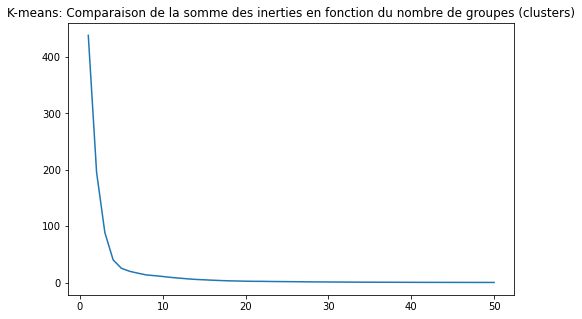

In [228]:
plt.figure(figsize=(8,5))
plt.title('K-means: Comparaison de la somme des inerties en fonction du nombre de groupes (clusters)')
sns.lineplot(list(inertia.keys()), list(inertia.values()))

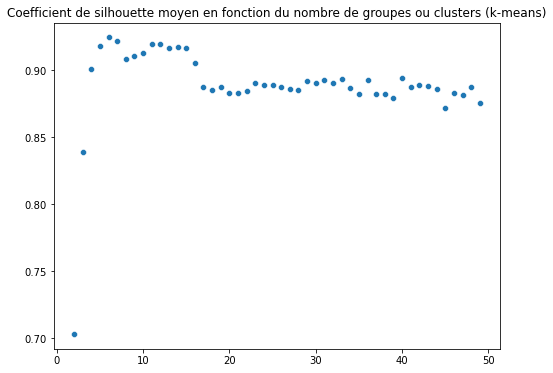

In [229]:
silhouettes_kmeans = {}
for i in range(2,max_clusters):
    silhouettes_kmeans[i] = silhouette_score(X = unsupervised_array, labels = list(dict_kmeans[i].labels_))

plt.figure(figsize = (8, 6))
plt.title('Coefficient de silhouette moyen en fonction du nombre de groupes ou clusters (k-means)')
sns.scatterplot(x = list(silhouettes_kmeans.keys()), y = list(silhouettes_kmeans.values()))
plt.show()

In [230]:
for key, value in silhouettes_kmeans.items():
    if value == max(silhouettes_kmeans.values()):
        print('Le coefficient de silhouette est maximal pour {} groupes ou en anglais clusters (score = {})'.format(key, value))
        nb_clusters_optimal = key

Le coefficient de silhouette est maximal pour 6 groupes ou en anglais clusters (score = 0.9244526028633118)


In [231]:
pd.DataFrame(dict_kmeans[8].labels_)[0].value_counts()

1    445
0    174
2     86
3     41
6     18
7     10
5      9
4      4
Name: 0, dtype: int64

In [232]:
train_labelized = train.copy()
train_labelized['label_kmeans'] = dict_kmeans[nb_clusters_optimal].labels_

In [233]:
train_labelized.groupby(['label_kmeans']).apply(lambda x: (x.groupby('cat_lvl_2').count().sort_values('cat_lvl_2', ascending = False)))['uniq_id']

label_kmeans  cat_lvl_2                  
0             Wrist Watches                  48
              Women's Hygiene                 1
              Wall Decor & Clocks             7
              Tidy Home Furnishing            1
              Tableware & Cutlery             2
                                             ..
5             Fragrances                      2
              Decorative Lighting & Lamps     2
              Curtains & Accessories          1
              Combos and Kits                 1
              Body and Skin Care              1
Name: uniq_id, Length: 144, dtype: int64

In [234]:
pd.DataFrame(train).head(5)

,uniq_id,crawl_timestamp,product_url,product_name,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,cat_lvl_1,cat_lvl_2,cat_lvl_3
165,785b4383b12106dd172306d427d8f7b2,2015-12-01 12:40:44 +0000,http://www.flipkart.com/rockmantra-cute-two-ca...,Rockmantra Cute Two Cats Ceramic Mug,MUGEAGGKFBTYPN4Z,499.0,349.0,./datasets/Images_P6/785b4383b12106dd172306d42...,False,Rockmantra Cute Two Cats Ceramic Mug (5.5 l)\r...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Type"", ""va...",Kitchen & Dining,Coffee Mugs,Rockmantra Coffee Mugs
248,45d0af2c709de47268c80c35a117de44,2015-12-01 12:40:44 +0000,http://www.flipkart.com/malhar-niko-male-doll-...,Malhar Niko Male Doll Showpiece - 25 cm,SHIEY382SR75SXEY,6395.0,5436.0,./datasets/Images_P6/45d0af2c709de47268c80c35a...,True,Buy Malhar Niko Male Doll Showpiece - 25 cm ...,No rating available,No rating available,Malhar,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Decor & Festive Needs,Showpieces,Malhar Showpieces
310,64b463dc0b75ae40a848498c657041e6,2015-12-01 06:13:00 +0000,http://www.flipkart.com/linksys-smart-wi-fi-ro...,Linksys Smart Wi-Fi Router,RTRDZTF9DBT4CW8U,14999.0,13500.0,./datasets/Images_P6/64b463dc0b75ae40a848498c6...,True,Buy Linksys Smart Wi-Fi Router only for Rs. 0....,No rating available,No rating available,Linksys,"{""product_specification""=>[{""key""=>""Encryption...",Computers,Network Components,Routers
685,6b5cdfe68595fbcab0e05dc625d3d66a,2015-12-31 09:19:31 +0000,http://www.flipkart.com/richfeel-sunshield-spf...,Richfeel Sunshield - SPF 30 PA++,SNRE4F2GBWVF6UKR,299.0,224.0,./datasets/Images_P6/6b5cdfe68595fbcab0e05dc62...,False,Flipkart.com: Buy Richfeel Sunshield - SPF 30 ...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Quantity"",...",Beauty and Personal Care,Body and Skin Care,Face Care
843,e86daf9ebcdfc5c5dd088cdb7f8f8db6,2015-12-29 05:07:38 +0000,http://www.flipkart.com/epresent-mfan-1-fan-us...,Epresent Mfan 1 Fan USB USB Fan,USGEB3HTYWCYT2HY,269.0,219.0,./datasets/Images_P6/e86daf9ebcdfc5c5dd088cdb7...,False,Buy Epresent Mfan 1 Fan USB USB Fan for Rs.219...,No rating available,No rating available,Epresent,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Computers,Laptop Accessories,USB Gadgets


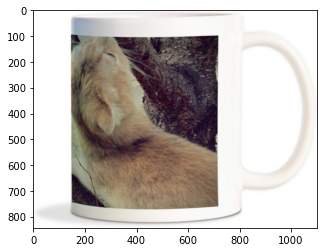

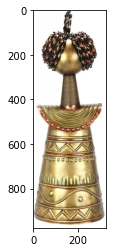

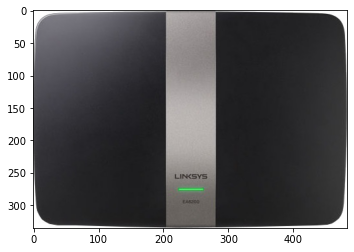

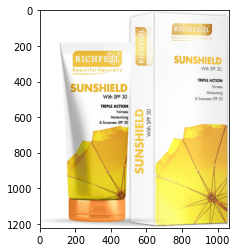

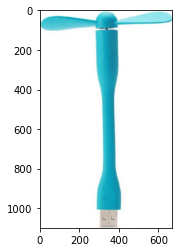

...

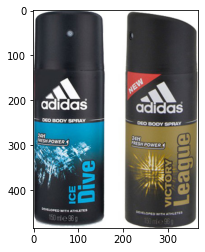

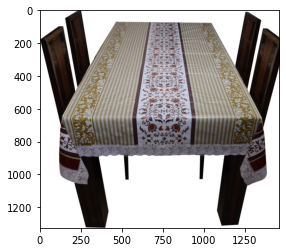

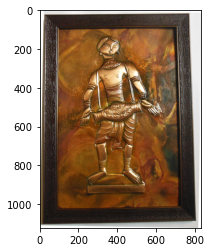

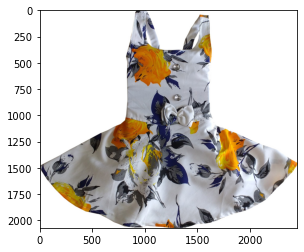

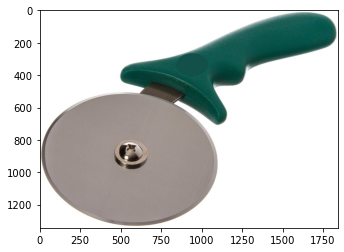

In [235]:
k = 0
for image in train_labelized[train_labelized['label_kmeans'] == 0]['image'].tolist():
    if k < 20:
        chemin = image
        plt.figure()
        plt.imshow(Image_PIL.open(chemin))
        plt.show()
        k += 1
    else:
        break

In [236]:
#Objets de ipython habituels
ipython_vars = ['In', 'Out', 'exit', 'quit', 'get_ipython', 'ipython_vars']

#Obtention d'une liste triée des objets et de leurs tailles
pd.DataFrame(sorted([(x, sys.getsizeof(globals().get(x))) for x in dir() if not x.startswith('_') and x not in sys.modules and x not in ipython_vars], key = lambda x: x[1], reverse = True))

,0,1
0,descripteurs_array,5195366520
1,X,40488120
2,train_array_cnn,38682776
3,test_array_cnn,12927128
4,array_image,11552392
...,...,...
324,min_x,28
325,min_y,28
326,nb_clusters,28
327,nb_clusters_optimal,28


In [237]:
%reset_selective train_array_cnn --y

Once deleted, variables cannot be recovered. Proceed (y/[n])?  y


In [238]:
%reset_selective -f [image_essai, im, im2, array_image, ech, data_visuelle]

In [241]:
ipython_vars = ['In', 'Out', 'exit', 'quit', 'get_ipython', 'ipython_vars']

pd.DataFrame(sorted([(x, sys.getsizeof(globals().get(x))) for x in dir() if not x.startswith('_') and x not in sys.modules and x not in ipython_vars], key=lambda x: x[1], reverse=True))

,0,1
0,X,40488120
1,kp,4040
2,NMF,2008
3,TfidfVectorizer,2008
4,GridSearchCV,1472
...,...,...
183,tf,72
184,f,48
185,stopwords,48
186,j,28


In [242]:
df = pd.read_csv('./datasets/data_saved_data_categories.csv')

In [243]:
df.head(5)

,Unnamed: 0,uniq_id,crawl_timestamp,product_url,product_name,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,cat_lvl_1,cat_lvl_2,cat_lvl_3
0,0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Furnishing,Curtains & Accessories,Curtains
1,1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa...",Baby Care,Baby Bath & Skin,Baby Bath Towels
2,2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",...",Baby Care,Baby Bath & Skin,Baby Bath Towels
3,3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Furnishing,Bed Linen,Bedsheets
4,4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa...",Home Furnishing,Bed Linen,Bedsheets


In [244]:
train = pd.read_csv('./datasets/data_saved_train.csv')
test = pd.read_csv('./datasets/data_saved_test.csv')

In [245]:
train.head(5)

,Unnamed: 0,uniq_id,crawl_timestamp,product_url,product_name,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,cat_lvl_1,cat_lvl_2,cat_lvl_3
0,165,785b4383b12106dd172306d427d8f7b2,2015-12-01 12:40:44 +0000,http://www.flipkart.com/rockmantra-cute-two-ca...,Rockmantra Cute Two Cats Ceramic Mug,MUGEAGGKFBTYPN4Z,499.0,349.0,785b4383b12106dd172306d427d8f7b2.jpg,False,Rockmantra Cute Two Cats Ceramic Mug (5.5 l)\r...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Type"", ""va...",Kitchen & Dining,Coffee Mugs,Rockmantra Coffee Mugs
1,248,45d0af2c709de47268c80c35a117de44,2015-12-01 12:40:44 +0000,http://www.flipkart.com/malhar-niko-male-doll-...,Malhar Niko Male Doll Showpiece - 25 cm,SHIEY382SR75SXEY,6395.0,5436.0,45d0af2c709de47268c80c35a117de44.jpg,True,Buy Malhar Niko Male Doll Showpiece - 25 cm ...,No rating available,No rating available,Malhar,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Decor & Festive Needs,Showpieces,Malhar Showpieces
2,310,64b463dc0b75ae40a848498c657041e6,2015-12-01 06:13:00 +0000,http://www.flipkart.com/linksys-smart-wi-fi-ro...,Linksys Smart Wi-Fi Router,RTRDZTF9DBT4CW8U,14999.0,13500.0,64b463dc0b75ae40a848498c657041e6.jpg,True,Buy Linksys Smart Wi-Fi Router only for Rs. 0....,No rating available,No rating available,Linksys,"{""product_specification""=>[{""key""=>""Encryption...",Computers,Network Components,Routers
3,685,6b5cdfe68595fbcab0e05dc625d3d66a,2015-12-31 09:19:31 +0000,http://www.flipkart.com/richfeel-sunshield-spf...,Richfeel Sunshield - SPF 30 PA++,SNRE4F2GBWVF6UKR,299.0,224.0,6b5cdfe68595fbcab0e05dc625d3d66a.jpg,False,Flipkart.com: Buy Richfeel Sunshield - SPF 30 ...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Quantity"",...",Beauty and Personal Care,Body and Skin Care,Face Care
4,843,e86daf9ebcdfc5c5dd088cdb7f8f8db6,2015-12-29 05:07:38 +0000,http://www.flipkart.com/epresent-mfan-1-fan-us...,Epresent Mfan 1 Fan USB USB Fan,USGEB3HTYWCYT2HY,269.0,219.0,e86daf9ebcdfc5c5dd088cdb7f8f8db6.jpg,False,Buy Epresent Mfan 1 Fan USB USB Fan for Rs.219...,No rating available,No rating available,Epresent,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Computers,Laptop Accessories,USB Gadgets


In [246]:
test.head(5)

,Unnamed: 0,uniq_id,crawl_timestamp,product_url,product_name,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,cat_lvl_1,cat_lvl_2,cat_lvl_3
0,352,833a87b0af3b84fe246d2ebf271af177,2015-12-01 06:13:00 +0000,http://www.flipkart.com/zyxel-pla-4205/p/itmdy...,Zyxel PLA-4205,RTRDYZYDXGHXXJNZ,10999.0,8100.0,833a87b0af3b84fe246d2ebf271af177.jpg,False,Buy Zyxel PLA-4205 only for Rs. 8100 from Flip...,No rating available,No rating available,Zyxel,"{""product_specification""=>[{""key""=>""In The Box...",Computers,Network Components,Routers
1,689,55195de3873fffaa9e37b041533d7305,2015-12-31 09:19:31 +0000,http://www.flipkart.com/philips-9-5-w-led-b22-...,Philips 9.5 W LED B22 3000K A55 IND Bulb,BLBEF3HEKYURWHKG,699.0,419.0,55195de3873fffaa9e37b041533d7305.jpg,False,Buy Philips 9.5 W LED B22 3000K A55 IND Bulb f...,No rating available,No rating available,Philips,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Kitchen & Dining,Lighting,Bulbs
2,485,44b963eb856b4831dfdd21b666593c95,2016-01-07 05:50:25 +0000,http://www.flipkart.com/lapguard-lenovo-ideapa...,Lapguard Lenovo IdeaPad V470 6 Cell Laptop Bat...,ACCDVPGKY3GBDB5P,3999.0,1799.0,44b963eb856b4831dfdd21b666593c95.jpg,False,Lapguard Lenovo IdeaPad V470 6 Cell Laptop Bat...,2,2,Lapguard,"{""product_specification""=>[{""key""=>""In The Box...",Computers,Laptop Accessories,Batteries
3,388,98ad5b99ad96695568d8f143b11ab740,2015-12-01 06:13:00 +0000,http://www.flipkart.com/anna-andre-paris-set-d...,Anna Andre Paris Set of Dark Fire & Numero 1 D...,CAGEYUXVZSFVZRHE,355.0,310.0,98ad5b99ad96695568d8f143b11ab740.jpg,False,Flipkart.com: Buy Anna Andre Paris Set of Dark...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Number of ...",Beauty and Personal Care,Fragrances,Deodorants
4,31,29b1ca231e10d5269516b80bf9d0dffc,2015-12-04 07:25:36 +0000,http://www.flipkart.com/lenco-bdblue-tango-ana...,"Lenco Bdblue Tango Analog Watch - For Men, Boys",WATEB2FZUMQU4W7R,1499.0,599.0,29b1ca231e10d5269516b80bf9d0dffc.jpg,False,"Lenco Bdblue Tango Analog Watch - For Men, Bo...",No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Chronograp...",Watches,Wrist Watches,Lenco Wrist Watches


In [247]:
def get_files(path_list):
    '''Renvoie la liste des matrices d'images à partir d'une liste de chemins'''
    liste_image = []
    compteur = 0
    for image_path in path_list:
        #im = cv2.imread(image_path, 0)
        im = np.array(Image_PIL.open(image_path))
        liste_image.append(im)
        compteur +=1
    
    del compteur
    del im
    
    return liste_image

In [248]:
def redim(array_im, width, height):
    '''Redimensionne l'image correspondant à array_im dans la largeur et la hauteur définie'''
    min_x = 100000
    max_x = 0
    min_y = 100000
    max_y = 0
    shape = array_im.shape
    if shape[0] < min_x:
        min_x = shape[0]
    elif shape[0] > max_x:
        max_x = shape[0]
    if shape[1] < min_y:
        min_y = shape[1]
    elif shape[1] > max_y:
        max_y = shape[1]
    im = cv2.resize(array_im, dsize=(width,height))
    
    del shape
    
    return im

In [249]:
train['image'] = train['image'].apply(lambda x:"./datasets/Images_P6/" + str(x))
test['image'] = test['image'].apply(lambda x:"./datasets/Images_P6/" + str(x))

In [250]:
train_cnn = get_files(train.copy()['image'].tolist())

In [251]:
test_cnn = get_files(test.copy()['image'].tolist())

C:\Users\archi\anaconda3\lib\site-packages\PIL\Image.py:2918: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


In [252]:
train_array_cnn = np.vstack([redim(img, 224, 224).reshape(1,224,224,3) for img in train_cnn])
test_array_cnn = np.vstack([redim(img, 224, 224).reshape(1,224,224,3) for img in test_cnn])

In [1]:
#np.save('./datsets/data_saved_train_images_array', train_array_cnn)
#np.save('./datasets/data_saved_test_images_array', test_array_cnn)

In [254]:
if False:
    train['image'] = train['image'].apply(lambda x:"./datasets/Images_P6/" + str(x))
    test['image'] = test['image'].apply(lambda x:"./datasets/Images_P6/" + str(x))

    train_cnn = get_files(train.copy()['image'].tolist())
    test_cnn = get_files(test.copy()['image'].tolist())

    train_array_cnn = np.vstack([redim(img, 224, 224).reshape(1,224,224,3) for img in train_cnn])
    test_array_cnn = np.vstack([redim(img, 224, 224).reshape(1,224,224,3) for img in test_cnn])
    del train_cnn,test_cnn
    #sauvegarde de train_array_ccn / test_array_cnn
    np.save('data_saved_train_images_array', train_array_cnn)
    np.save('data_saved_test_images_array', test_array_cnn)
else :
    train_array_cnn = np.load('data_saved_train_images_array.npy')
    test_array_cnn = np.load('data_saved_test_images_array.npy')

In [255]:
ohe = OneHotEncoder(handle_unknown = 'ignore')
array_cats = ohe.fit_transform(np.array(train['cat_lvl_2']).reshape(-1,1))

In [256]:
array_cats.todense().shape

(787, 57)

In [257]:
train_array_cats = ohe.transform(train[['cat_lvl_2']]).todense()
test_array_cats = ohe.transform(test[['cat_lvl_2']]).todense()

C:\Users\archi\anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but OneHotEncoder was fitted without feature names
  warnings.warn(
C:\Users\archi\anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but OneHotEncoder was fitted without feature names
  warnings.warn(


In [258]:
train_array_cats.shape

(787, 57)

In [259]:
test_array_cats.shape

(263, 57)

In [260]:
ohe.categories_[0].shape[0]

57

### VIII.4.Transfer learning 

In [261]:
vgg = VGG16()
vgg.layers.pop()
vgg.layers.pop()

vgg_transfer = Sequential()
vgg_transfer.add(vgg)
vgg_transfer.trainable = False
vgg_transfer.add(Dense(ohe.categories_[0].shape[0], activation = 'softmax'))
vgg_transfer.compile(loss = 'mean_squared_error', optimizer = 'sgd')

In [262]:
train_array_cnn = np.vstack([redim(img, 224, 224).reshape(1,224,224,3) for img in train_cnn])
test_array_cnn = np.vstack([redim(img, 224, 224).reshape(1,224,224,3) for img in test_cnn])

print('train array shape : ', train_array_cnn.shape)
print('train array cats : ', train_array_cats.shape)

train array shape :  (787, 224, 224, 3)
train array cats :  (787, 57)


In [263]:
vgg_transfer.fit(train_array_cnn, train_array_cats, epochs = 3, batch_size = 20, verbose = 1)

Epoch 1/3
40/40 [==============================] - 126s 3s/step - loss: 0.0172
Epoch 2/3
40/40 [==============================] - 131s 3s/step - loss: 0.0172
Epoch 3/3
40/40 [==============================] - 132s 3s/step - loss: 0.0172


In [264]:
vgg_transfer.save_weights('models/weighs_vgg_transfer.weights')

In [265]:
vgg_transfer.load_weights('models/weighs_vgg_transfer.weights')

In [266]:
train.iloc[36]

Unnamed: 0                                                                82
uniq_id                                     601817defaff9d0e30e1b72f96d3975f
crawl_timestamp                                    2016-03-10 07:45:58 +0000
product_url                http://www.flipkart.com/chinmay-kids-printed-c...
product_name                 CHINMAY KIDS Printed Cotton Padded Mosquito Net
pid                                                         MNTEGKSZD2ZWUBZK
retail_price                                                          1490.0
discounted_price                                                       540.0
image                      ./datasets/Images_P6/601817defaff9d0e30e1b72f9...
is_FK_Advantage_product                                                False
description                Specifications of CHINMAY KIDS Printed Cotton ...
product_rating                                           No rating available
overall_rating                                           No rating available

1/1 [==============================] - 0s 339ms/step


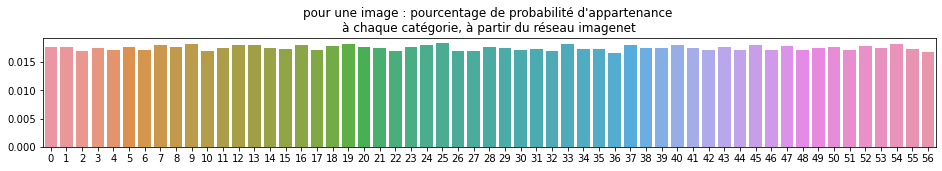

1/1 [==============================] - 0s 183ms/step


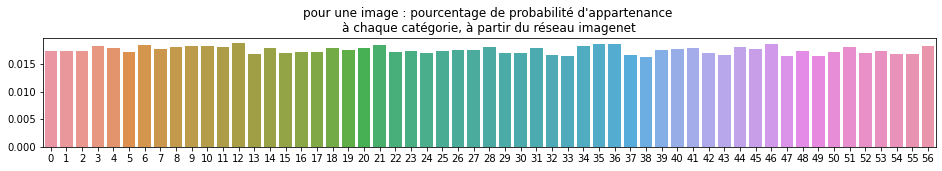

1/1 [==============================] - 0s 175ms/step


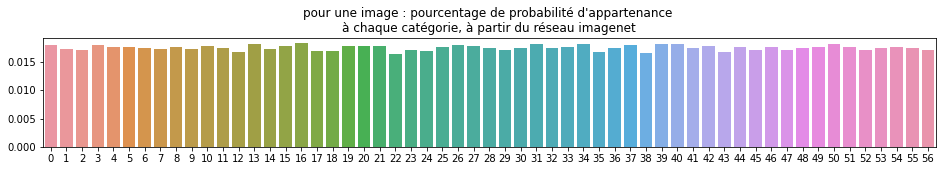

In [267]:
ex_prediction_vgg = vgg_transfer.predict(redim(test_array_cnn[24], 224, 224).reshape(1,224,224,3))
plt.figure(figsize = (16, 2))
plt.title("pour une image : pourcentage de probabilité d'appartenance \nà chaque catégorie, à partir du réseau imagenet")
sns.barplot(x = list(range(ex_prediction_vgg.shape[1])), y = ex_prediction_vgg[0])
plt.show()

ex_prediction_vgg = vgg_transfer.predict(redim(test_array_cnn[28], 224, 224).reshape(1,224,224,3))
plt.figure(figsize = (16, 2))
plt.title("pour une image : pourcentage de probabilité d'appartenance \nà chaque catégorie, à partir du réseau imagenet")
sns.barplot(x = list(range(ex_prediction_vgg.shape[1])), y = ex_prediction_vgg[0])
plt.show()

ex_prediction_vgg = vgg_transfer.predict(redim(test_array_cnn[36], 224, 224).reshape(1,224,224,3))
plt.figure(figsize = (16, 2))
plt.title("pour une image : pourcentage de probabilité d'appartenance \nà chaque catégorie, à partir du réseau imagenet")
sns.barplot(x = list(range(ex_prediction_vgg.shape[1])), y = ex_prediction_vgg[0])
plt.show()

In [268]:
vgg_train_output = vgg_transfer.predict(train_array_cnn)
vgg_test_output = vgg_transfer.predict(test_array_cnn)

9/9 [==============================] - 44s 5s/step


In [269]:
vgg_train_output.shape

(787, 57)

In [270]:
vgg_test_output.shape

(263, 57)

In [271]:
vgg_output = np.vstack([vgg_train_output, vgg_test_output])

In [272]:
vgg_output.shape

(1050, 57)

In [273]:
np.save('./datasets/data_saved_transfer_learning_output', vgg_output)

### IX.Approches combinées 

In [274]:
X_NLP = np.load('./data_saved_X_reduce_NLP.csv.npy')
X_descripteurs = np.load('./datasets/data_saved_array_features_descripteurs.npy')
X_CNN = np.load('./datasets/data_saved_transfer_learning_output.npy')

In [275]:
X_NLP.shape

(1050, 340)

In [276]:
np.vstack([np.array(train['discounted_price']).reshape(-1,1), np.array(test['discounted_price']).reshape(-1,1)])

array([[  349.],
       [ 5436.],
       [13500.],
       ...,
       [  356.],
       [  550.],
       [  950.]])

In [280]:
np.array(df_P6['discounted_price']).reshape(-1,1).shape[1]

1

### IX.1.Homogénisation des dimensions 

In [281]:
print('NLP : ', X_NLP.shape)
print('Descripteurs : ', X_descripteurs.T.shape)
print('CNN : ', X_CNN.shape)

NLP :  (1050, 340)
Descripteurs :  (1050, 6)
CNN :  (1050, 57)


### IX.2.Assemblage des données 

In [282]:
X_combined = np.hstack([np.array(df_P6['discounted_price']).reshape(-1,1), X_NLP, X_CNN, X_descripteurs.T])

In [283]:
X_combined.shape

(1050, 404)

In [284]:
np.nan_to_num(X_combined, 0)

array([[ 8.99000000e+02, -9.29207686e-01, -4.08960531e-01, ...,
         1.58241858e+03,  1.44827453e+05,  1.91629040e+07],
       [ 4.49000000e+02, -1.99557548e+00, -7.97962524e-01, ...,
         1.46699658e+03,  1.06946195e+05,  1.23989070e+07],
       [ 0.00000000e+00, -2.00294510e+00, -7.56956153e-01, ...,
         1.68426917e+03,  1.78754250e+05,  2.50908980e+07],
       ...,
       [ 1.44900000e+03, -1.52960145e+00, -5.13532247e-01, ...,
         1.32768518e+03,  8.26010703e+04,  8.97550500e+06],
       [ 1.33300000e+03, -2.03952771e+00, -6.93763840e-01, ...,
         1.48562341e+03,  1.15319438e+05,  1.39128000e+07],
       [ 5.95000000e+02, -2.06888935e+00, -7.55835654e-01, ...,
         1.44794800e+03,  1.09942172e+05,  1.30892620e+07]])

In [285]:
np.save('./datasets/data_saved_X_combined', X_combined)

In [286]:
X_combined = np.load('./datasets/data_saved_X_combined.npy')

### IX.3.Catégorisation 

In [288]:
dict_kmeans = {}
inertia = {}
max_clusters = 80

f = IntProgress(min = 0, max = max_clusters) #initialisation
g = Text(value = '')
display(f) #affichage
display(g)

for k in range(1,max_clusters + 1):
    kmeans = KMeans(n_clusters = k, verbose = 0, random_state = 0).fit(X_combined)
    inertia[k] = kmeans.inertia_
    dict_kmeans[k] = kmeans
    f.value = k #incrémentation
    g.value =str(k) + '/' + str(max_clusters)

IntProgress(value=0, max=80)

Text(value='')

C:\Users\archi\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1332: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
C:\Users\archi\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1332: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
C:\Users\archi\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1332: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
C:\Users\archi\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1332: UserWarning: KMeans is known to have a memory leak on Window

C:\Users\archi\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:title={'center':'K-means: Comparaison de la somme des inerties en fonction du nombre de groupes (clusters)'}>

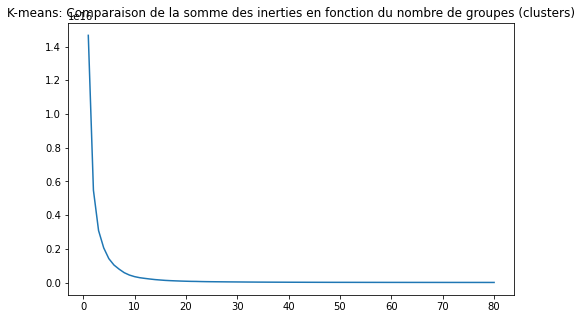

In [289]:
plt.figure(figsize = (8,5))
plt.title('K-means: Comparaison de la somme des inerties en fonction du nombre de groupes (clusters)')
sns.lineplot(list(inertia.keys()), list(inertia.values()))

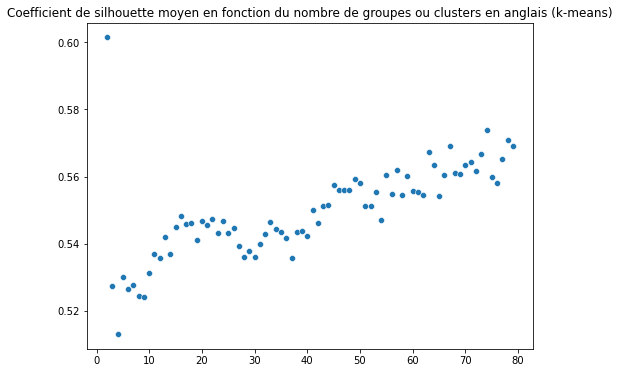

In [290]:
silhouettes_kmeans = {}
for i in range(2, max_clusters):
    silhouettes_kmeans[i] = silhouette_score(X = X_combined, labels = list(dict_kmeans[i].labels_))

plt.figure(figsize=(8,6)),
plt.title('Coefficient de silhouette moyen en fonction du nombre de groupes ou clusters en anglais (k-means)')
sns.scatterplot(x = list(silhouettes_kmeans.keys()), y = list(silhouettes_kmeans.values()))
plt.show()

In [291]:
for key, value in silhouettes_kmeans.items():
    if value == max(silhouettes_kmeans.values()):
        print('Le coefficient de silhouette est maximal pour {} groupes (clusters) (score = {})'.format(key, value))
        nb_clusters = key

Le coefficient de silhouette est maximal pour 2 groupes (clusters) (score = 0.6014171986319143)


C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


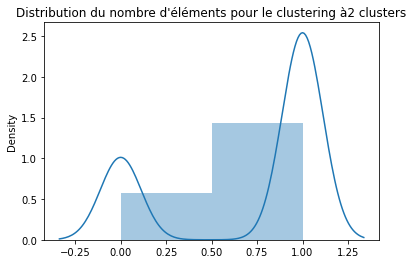

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


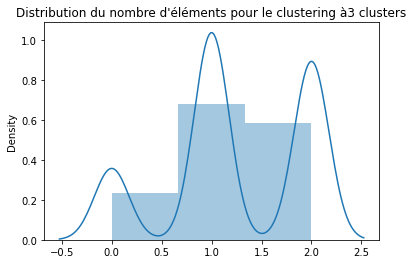

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


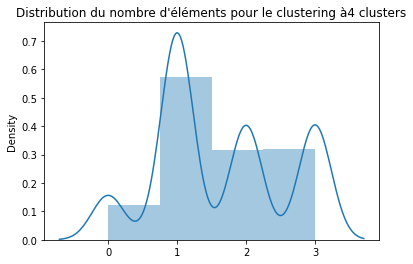

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


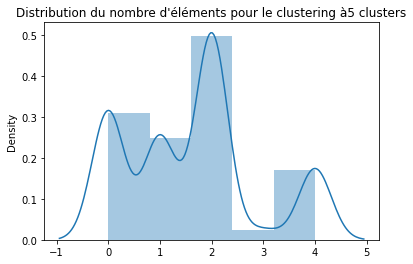

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


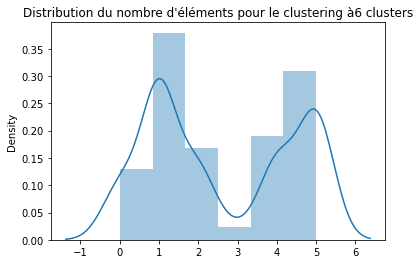

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


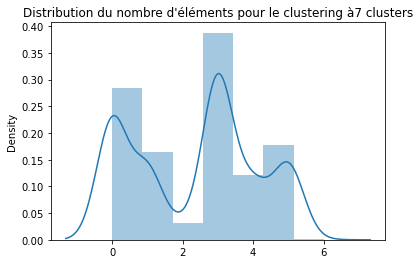

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


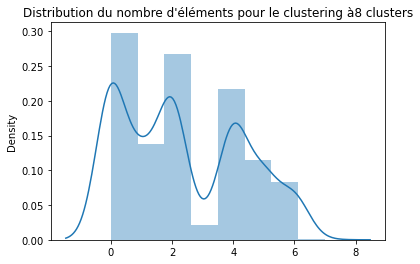

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


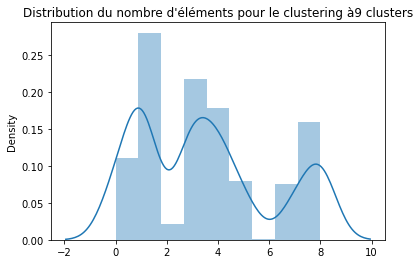

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


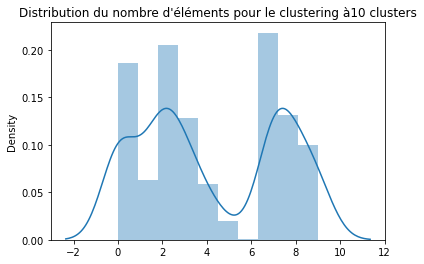

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


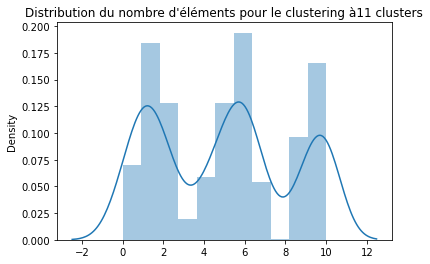

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


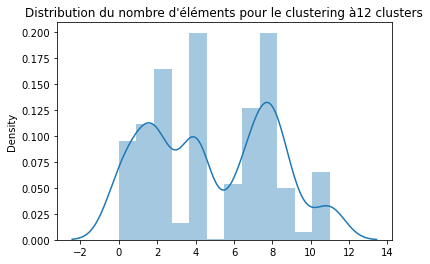

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


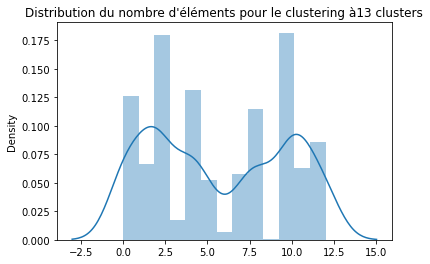

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


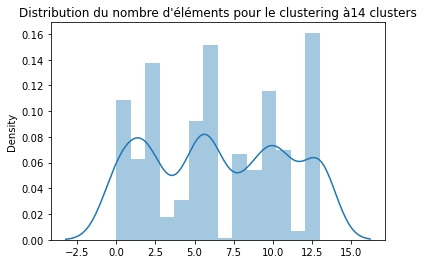

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


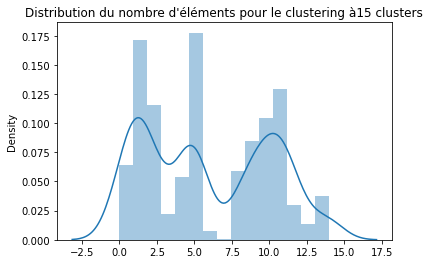

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


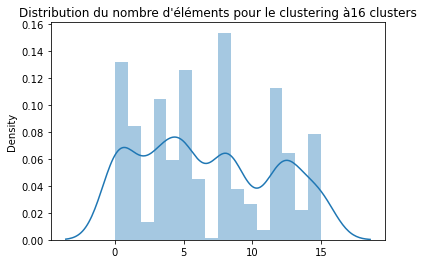

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


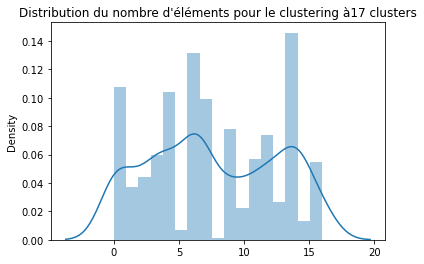

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


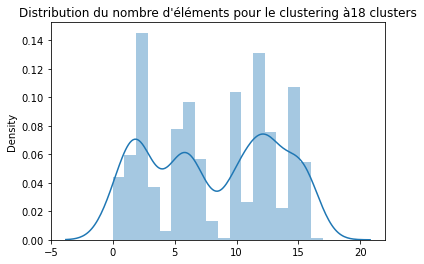

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


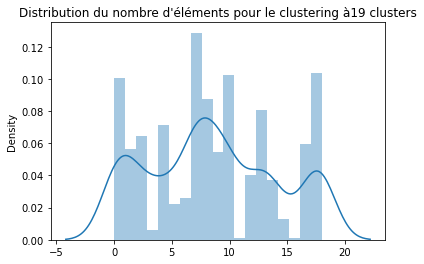

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


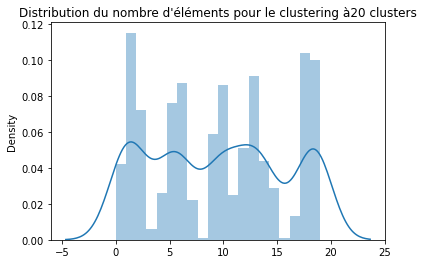

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


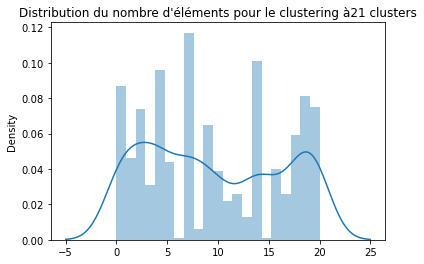

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


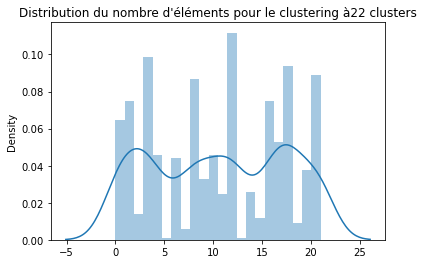

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


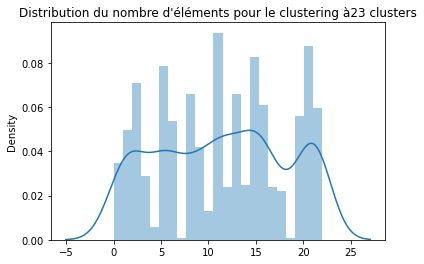

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


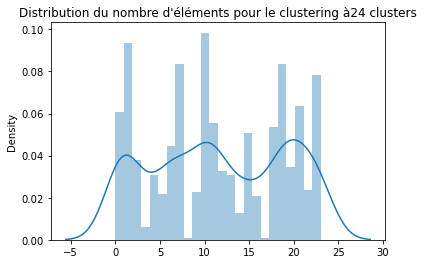

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


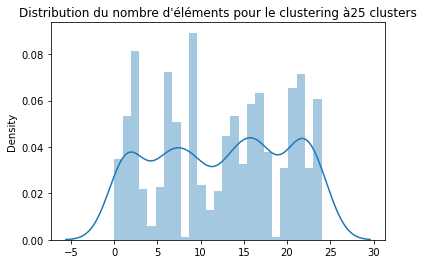

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


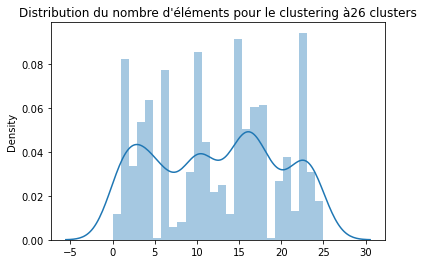

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


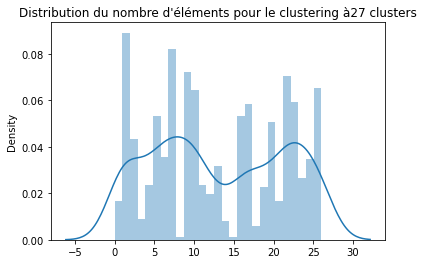

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


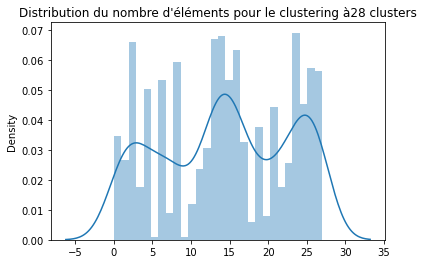

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


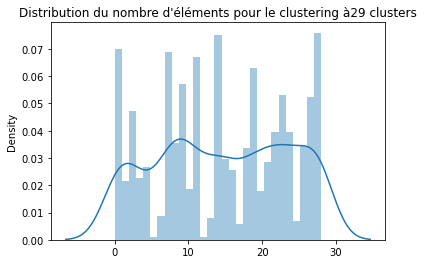

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


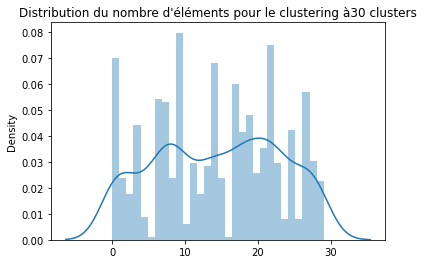

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


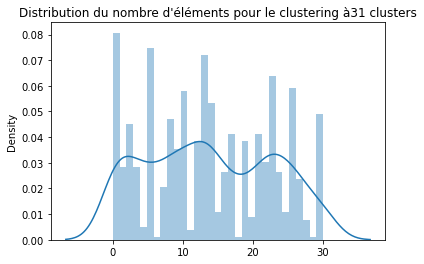

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


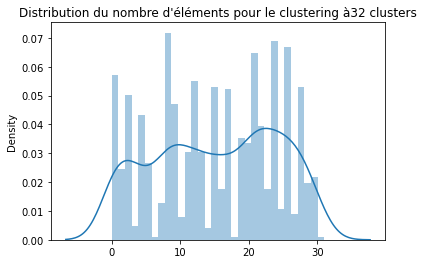

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


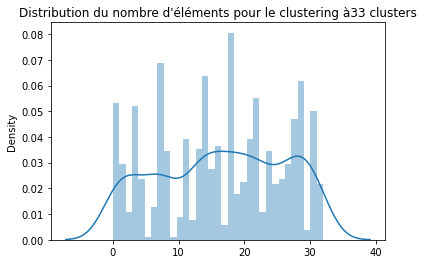

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


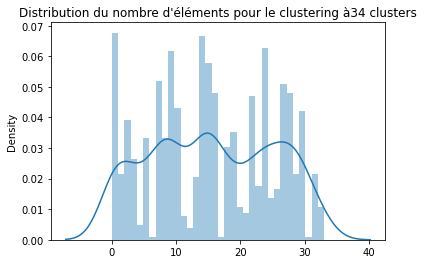

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


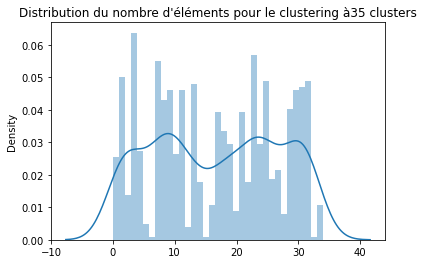

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


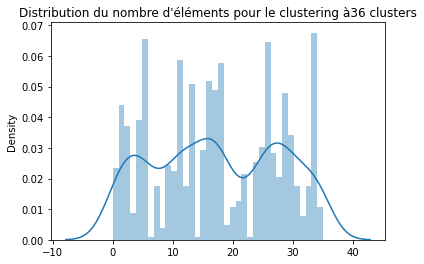

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


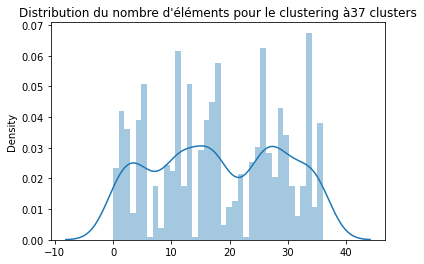

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


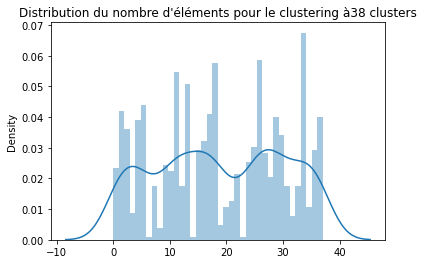

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


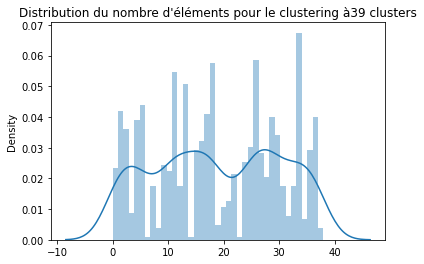

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


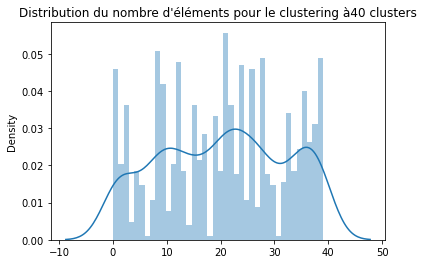

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


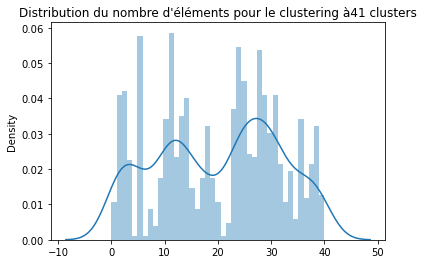

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


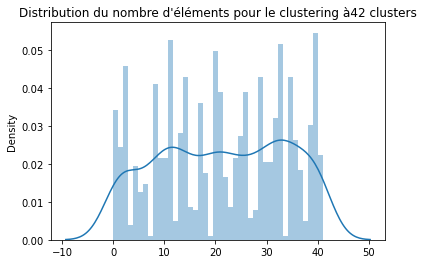

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


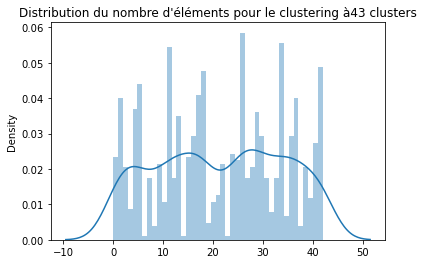

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


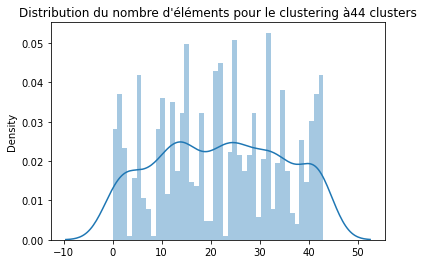

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


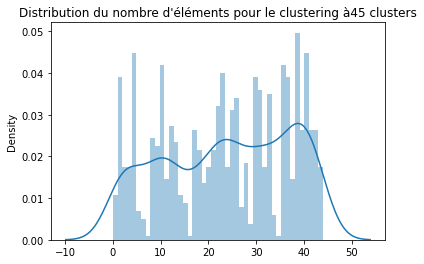

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


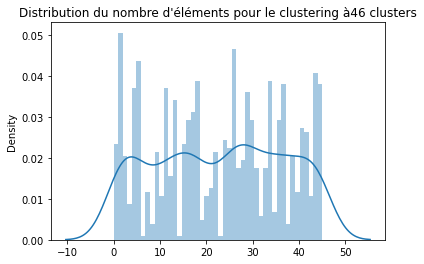

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


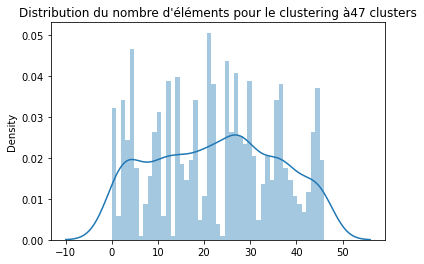

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


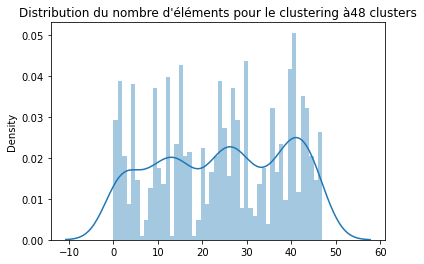

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


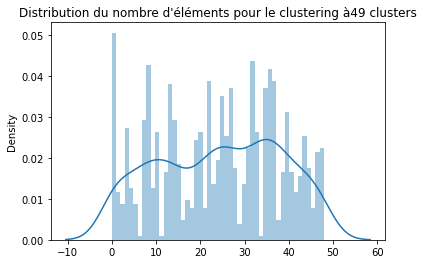

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


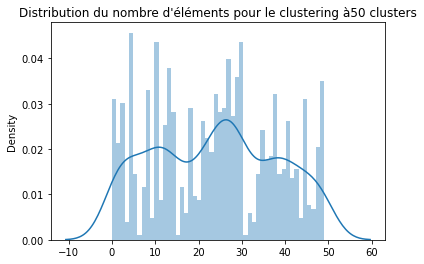

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


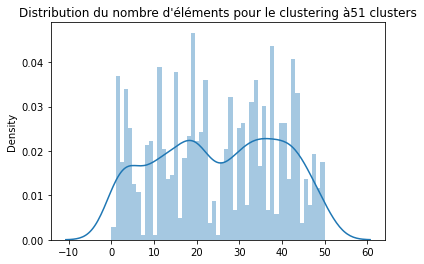

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


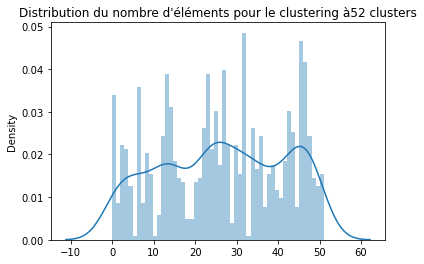

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


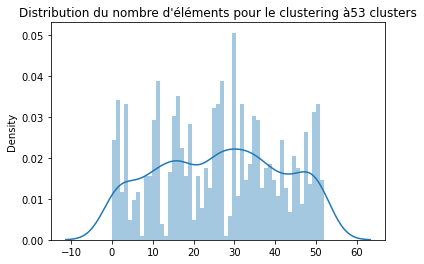

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


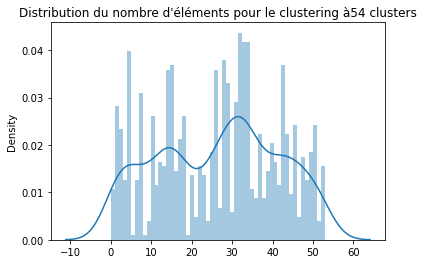

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


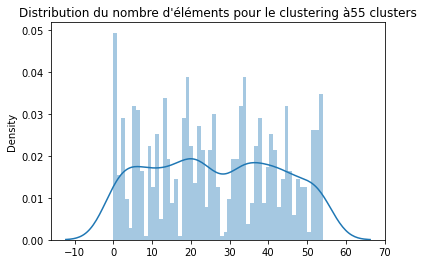

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


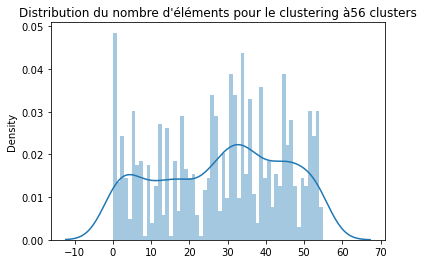

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


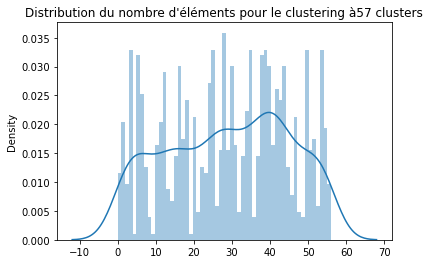

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


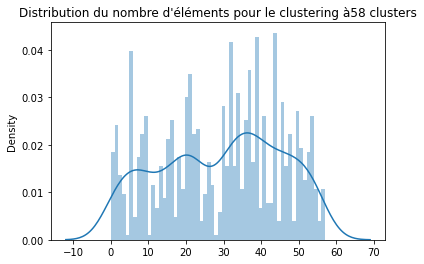

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


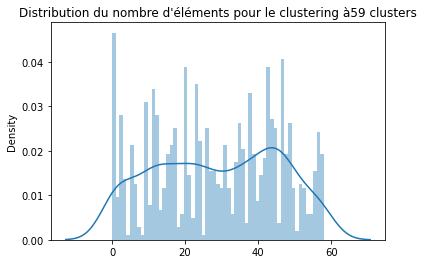

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


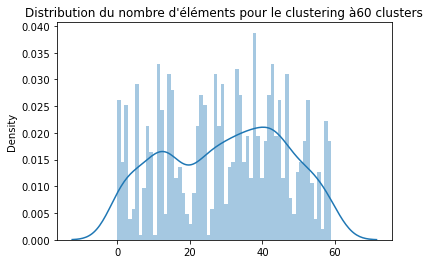

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


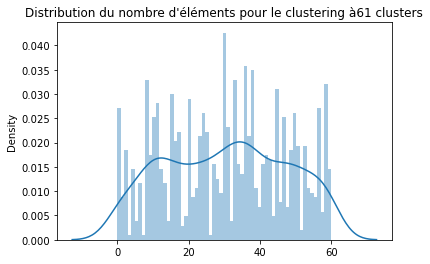

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


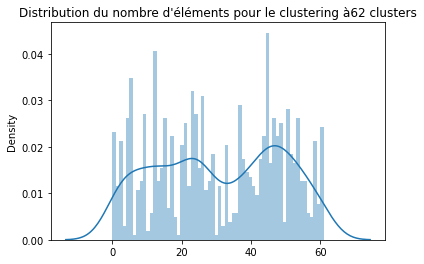

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


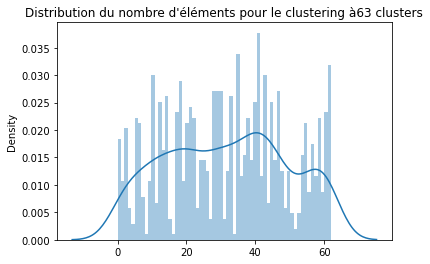

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


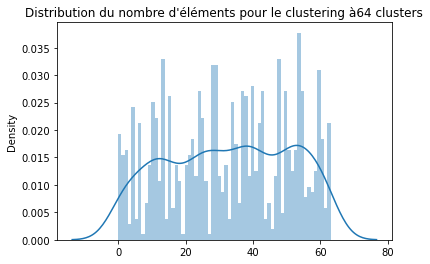

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


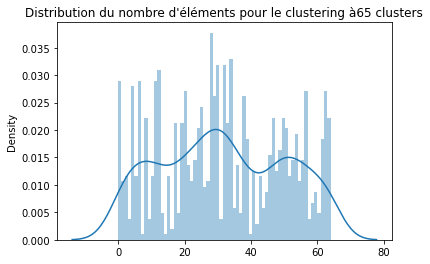

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


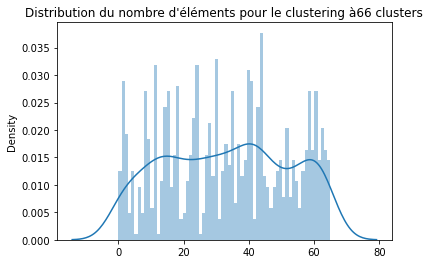

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


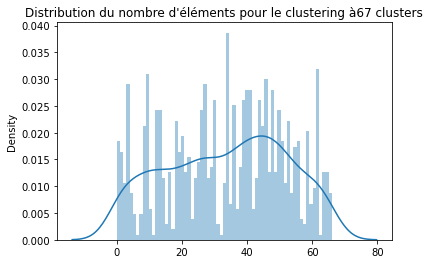

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


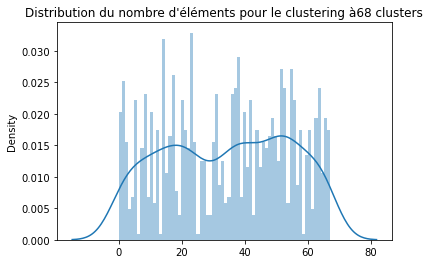

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


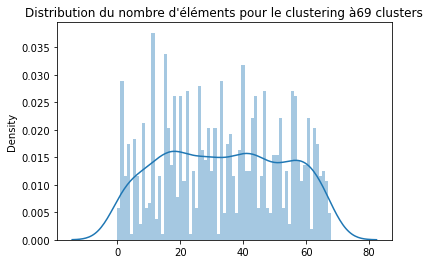

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


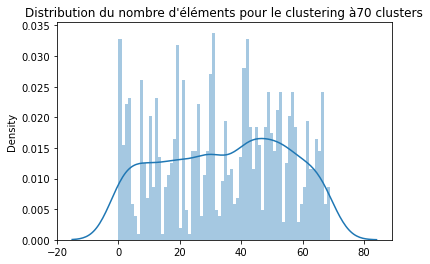

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


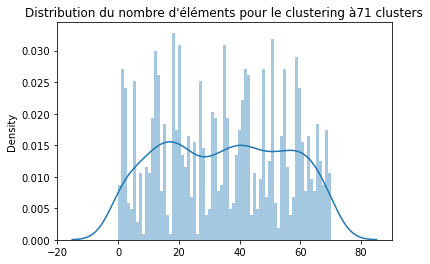

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


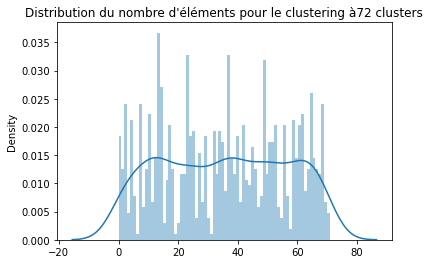

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


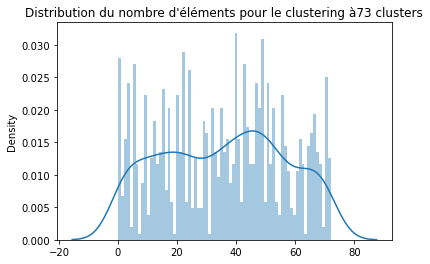

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


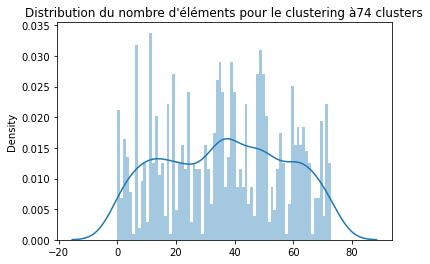

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


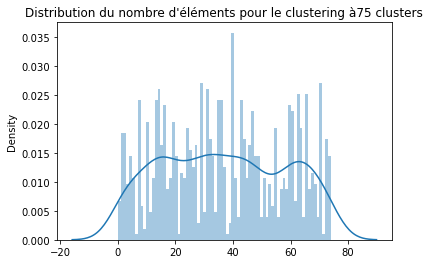

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


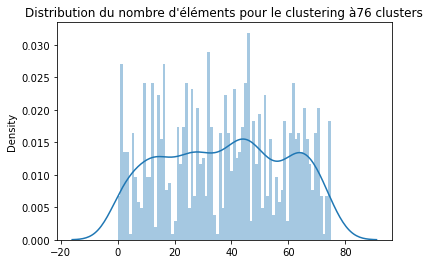

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


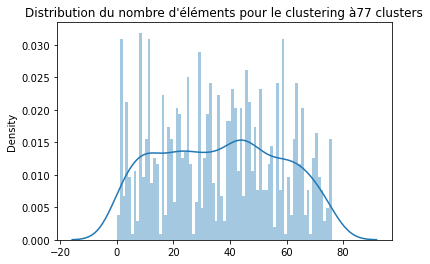

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


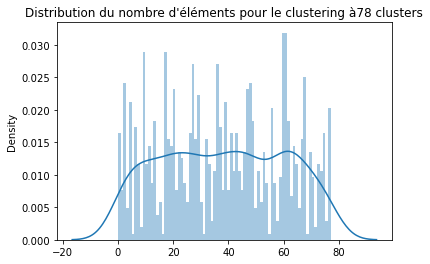

C:\Users\archi\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


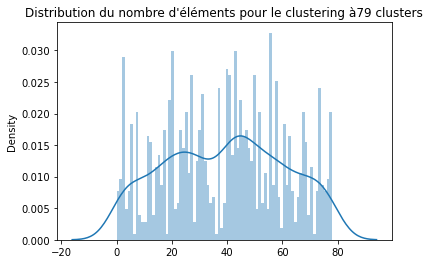

In [292]:
for i in range(2,max_clusters):
    plt.figure()
    titre = "Distribution du nombre d'éléments pour le clustering à" + str(i) + ' clusters'
    plt.title(titre)
    sns.distplot(dict_kmeans[i].labels_, bins = i)
    plt.show()

In [293]:
jeu_categoriel = pd.DataFrame(X_NLP)
jeu_categoriel['label'] = dict_kmeans[10].labels_

In [294]:
jeu_categoriel.to_csv('./datasets/data_saved_jeu_complet_kmeans.csv')

In [295]:
jeu_categoriel.shape

(1050, 341)

### IX.4.Représenataion des données 

In [297]:
tsne = TSNE(n_components = 2)
T = tsne.fit_transform(X_combined.copy())

C:\Users\archi\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\archi\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


<AxesSubplot:title={'center':'Représentation du jeu de données via T-SNE'}>

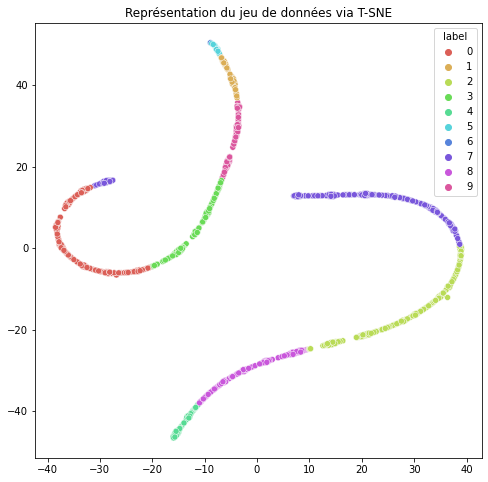

In [298]:
plt.figure(figsize = (8,8))
plt.title('Représentation du jeu de données via T-SNE')
palette_sns = sns.color_palette("hls", jeu_categoriel['label'].nunique())
sns.scatterplot(x= T[:,0], y = T[:,1], hue = jeu_categoriel['label'], palette = palette_sns)

In [299]:
T.shape

(1050, 2)

In [300]:
X_combined.shape

(1050, 404)

In [301]:
df_final = pd.concat([train, test])
df_final['X_TSNE'] = T[:,0]
df_final['Y_TSNE'] = T[:,1]

In [302]:
df_final.set_index('Unnamed: 0', inplace = True)

In [303]:
df_final['label'] = jeu_categoriel['label'].tolist()

In [304]:
df_final.shape

(1050, 20)

In [305]:
df_final.to_csv('./datasets/data_saved_df_final.csv')

In [306]:
df_final.head(5)

,uniq_id,crawl_timestamp,product_url,product_name,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,cat_lvl_1,cat_lvl_2,cat_lvl_3,X_TSNE,Y_TSNE,label
Unnamed: 0,,,,,,,,,,,,,,,,,,,,
165,785b4383b12106dd172306d427d8f7b2,2015-12-01 12:40:44 +0000,http://www.flipkart.com/rockmantra-cute-two-ca...,Rockmantra Cute Two Cats Ceramic Mug,MUGEAGGKFBTYPN4Z,499.0,349.0,./datasets/Images_P6/785b4383b12106dd172306d42...,False,Rockmantra Cute Two Cats Ceramic Mug (5.5 l)\r...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Type"", ""va...",Kitchen & Dining,Coffee Mugs,Rockmantra Coffee Mugs,-4.304342,39.924644,1
248,45d0af2c709de47268c80c35a117de44,2015-12-01 12:40:44 +0000,http://www.flipkart.com/malhar-niko-male-doll-...,Malhar Niko Male Doll Showpiece - 25 cm,SHIEY382SR75SXEY,6395.0,5436.0,./datasets/Images_P6/45d0af2c709de47268c80c35a...,True,Buy Malhar Niko Male Doll Showpiece - 25 cm ...,No rating available,No rating available,Malhar,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Decor & Festive Needs,Showpieces,Malhar Showpieces,-32.620308,14.176295,0
310,64b463dc0b75ae40a848498c657041e6,2015-12-01 06:13:00 +0000,http://www.flipkart.com/linksys-smart-wi-fi-ro...,Linksys Smart Wi-Fi Router,RTRDZTF9DBT4CW8U,14999.0,13500.0,./datasets/Images_P6/64b463dc0b75ae40a848498c6...,True,Buy Linksys Smart Wi-Fi Router only for Rs. 0....,No rating available,No rating available,Linksys,"{""product_specification""=>[{""key""=>""Encryption...",Computers,Network Components,Routers,-8.042645,49.642323,5
685,6b5cdfe68595fbcab0e05dc625d3d66a,2015-12-31 09:19:31 +0000,http://www.flipkart.com/richfeel-sunshield-spf...,Richfeel Sunshield - SPF 30 PA++,SNRE4F2GBWVF6UKR,299.0,224.0,./datasets/Images_P6/6b5cdfe68595fbcab0e05dc62...,False,Flipkart.com: Buy Richfeel Sunshield - SPF 30 ...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Quantity"",...",Beauty and Personal Care,Body and Skin Care,Face Care,17.082041,13.097118,7
843,e86daf9ebcdfc5c5dd088cdb7f8f8db6,2015-12-29 05:07:38 +0000,http://www.flipkart.com/epresent-mfan-1-fan-us...,Epresent Mfan 1 Fan USB USB Fan,USGEB3HTYWCYT2HY,269.0,219.0,./datasets/Images_P6/e86daf9ebcdfc5c5dd088cdb7...,False,Buy Epresent Mfan 1 Fan USB USB Fan for Rs.219...,No rating available,No rating available,Epresent,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Computers,Laptop Accessories,USB Gadgets,-6.637654,46.355080,1


In [307]:
#glob.glob('./datasets/data_saved/*')

[]

In [308]:
#data = pd.read_csv('./datasets/data_saved_df_final.csv')

In [309]:
#data.head(5)

,Unnamed: 0,uniq_id,crawl_timestamp,product_url,product_name,pid,retail_price,discounted_price,image,is_FK_Advantage_product,...,product_rating,overall_rating,brand,product_specifications,cat_lvl_1,cat_lvl_2,cat_lvl_3,X_TSNE,Y_TSNE,label
0,165,785b4383b12106dd172306d427d8f7b2,2015-12-01 12:40:44 +0000,http://www.flipkart.com/rockmantra-cute-two-ca...,Rockmantra Cute Two Cats Ceramic Mug,MUGEAGGKFBTYPN4Z,499.0,349.0,./datasets/Images_P6/785b4383b12106dd172306d42...,False,...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Type"", ""va...",Kitchen & Dining,Coffee Mugs,Rockmantra Coffee Mugs,-4.304342,39.924644,1
1,248,45d0af2c709de47268c80c35a117de44,2015-12-01 12:40:44 +0000,http://www.flipkart.com/malhar-niko-male-doll-...,Malhar Niko Male Doll Showpiece - 25 cm,SHIEY382SR75SXEY,6395.0,5436.0,./datasets/Images_P6/45d0af2c709de47268c80c35a...,True,...,No rating available,No rating available,Malhar,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Decor & Festive Needs,Showpieces,Malhar Showpieces,-32.620308,14.176295,0
2,310,64b463dc0b75ae40a848498c657041e6,2015-12-01 06:13:00 +0000,http://www.flipkart.com/linksys-smart-wi-fi-ro...,Linksys Smart Wi-Fi Router,RTRDZTF9DBT4CW8U,14999.0,13500.0,./datasets/Images_P6/64b463dc0b75ae40a848498c6...,True,...,No rating available,No rating available,Linksys,"{""product_specification""=>[{""key""=>""Encryption...",Computers,Network Components,Routers,-8.042645,49.642323,5
3,685,6b5cdfe68595fbcab0e05dc625d3d66a,2015-12-31 09:19:31 +0000,http://www.flipkart.com/richfeel-sunshield-spf...,Richfeel Sunshield - SPF 30 PA++,SNRE4F2GBWVF6UKR,299.0,224.0,./datasets/Images_P6/6b5cdfe68595fbcab0e05dc62...,False,...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Quantity"",...",Beauty and Personal Care,Body and Skin Care,Face Care,17.082040,13.097118,7
4,843,e86daf9ebcdfc5c5dd088cdb7f8f8db6,2015-12-29 05:07:38 +0000,http://www.flipkart.com/epresent-mfan-1-fan-us...,Epresent Mfan 1 Fan USB USB Fan,USGEB3HTYWCYT2HY,269.0,219.0,./datasets/Images_P6/e86daf9ebcdfc5c5dd088cdb7...,False,...,No rating available,No rating available,Epresent,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Computers,Laptop Accessories,USB Gadgets,-6.637654,46.355080,1


### X.Taille des images  

In [310]:
def resize(img_filename, height):
    original_path = './datasets/Images_P6/'
    final_path = './datasets/Resized_Images/'
    if 'Images_P6/' in img_filename:
        img_filename = img_filename.split("Images_P6/")[1]
    
    #Chargement image
    img = cv2.imread(original_path + str(img_filename), cv2.IMREAD_UNCHANGED)
    
    #Proportions de l'image
    ratio = img.shape[0]/img.shape[1]
    width = int(height / ratio)
    
    #Recadrer image
    resized = cv2.resize(img, (width, height), interpolation = cv2.INTER_AREA)
    
    #Sauvegarder image
    cv2.imwrite(str(final_path) + str(img_filename), resized)
    del width, img, ratio 
    return True

In [311]:
if False:
    from ipywidgets import IntProgress

    f = IntProgress(min = 0, max = len(data['image'].tolist())) #initialisation
    display(f) #affichage
    k = 0
    for image in data['image'].tolist():
        resize(image, height = 150)
        k += 1
        f.value = k #incrémentation

### XI.Visualisation  

In [312]:
df_final.head(5)

,Unnamed: 0,uniq_id,crawl_timestamp,product_url,product_name,pid,retail_price,discounted_price,image,is_FK_Advantage_product,...,product_rating,overall_rating,brand,product_specifications,cat_lvl_1,cat_lvl_2,cat_lvl_3,X_TSNE,Y_TSNE,label
0,165,785b4383b12106dd172306d427d8f7b2,2015-12-01 12:40:44 +0000,http://www.flipkart.com/rockmantra-cute-two-ca...,Rockmantra Cute Two Cats Ceramic Mug,MUGEAGGKFBTYPN4Z,499.0,349.0,./datasets/Images_P6/785b4383b12106dd172306d42...,False,...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Type"", ""va...",Kitchen & Dining,Coffee Mugs,Rockmantra Coffee Mugs,-4.304342,39.924644,1
1,248,45d0af2c709de47268c80c35a117de44,2015-12-01 12:40:44 +0000,http://www.flipkart.com/malhar-niko-male-doll-...,Malhar Niko Male Doll Showpiece - 25 cm,SHIEY382SR75SXEY,6395.0,5436.0,./datasets/Images_P6/45d0af2c709de47268c80c35a...,True,...,No rating available,No rating available,Malhar,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Decor & Festive Needs,Showpieces,Malhar Showpieces,-32.620308,14.176295,0
2,310,64b463dc0b75ae40a848498c657041e6,2015-12-01 06:13:00 +0000,http://www.flipkart.com/linksys-smart-wi-fi-ro...,Linksys Smart Wi-Fi Router,RTRDZTF9DBT4CW8U,14999.0,13500.0,./datasets/Images_P6/64b463dc0b75ae40a848498c6...,True,...,No rating available,No rating available,Linksys,"{""product_specification""=>[{""key""=>""Encryption...",Computers,Network Components,Routers,-8.042645,49.642323,5
3,685,6b5cdfe68595fbcab0e05dc625d3d66a,2015-12-31 09:19:31 +0000,http://www.flipkart.com/richfeel-sunshield-spf...,Richfeel Sunshield - SPF 30 PA++,SNRE4F2GBWVF6UKR,299.0,224.0,./datasets/Images_P6/6b5cdfe68595fbcab0e05dc62...,False,...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Quantity"",...",Beauty and Personal Care,Body and Skin Care,Face Care,17.082040,13.097118,7
4,843,e86daf9ebcdfc5c5dd088cdb7f8f8db6,2015-12-29 05:07:38 +0000,http://www.flipkart.com/epresent-mfan-1-fan-us...,Epresent Mfan 1 Fan USB USB Fan,USGEB3HTYWCYT2HY,269.0,219.0,./datasets/Images_P6/e86daf9ebcdfc5c5dd088cdb7...,False,...,No rating available,No rating available,Epresent,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Computers,Laptop Accessories,USB Gadgets,-6.637654,46.355080,1


In [313]:
df_final['retail_price'].describe()

count      1049.000000
mean       2186.197331
std        7639.229411
min          35.000000
25%         555.000000
50%         999.000000
75%        1999.000000
max      201000.000000
Name: retail_price, dtype: float64

In [314]:
df_final['price_as_size'] = pd.qcut(df_final['retail_price'], 8, labels = [3,4,5,6,7,8,9,10])

In [315]:
df_final['image'] = df_final['image'].apply([lambda x : str(x).split('/Images_P6/')[1]])

In [317]:
df_final['label_string'] = df_final['label'].apply(lambda x : 'cat_'+ str(x))
liste_categories = tuple([str(x) for x in df_final['label_string'].unique().tolist()])
palette_sns = sns.color_palette("hls", len(liste_categories))

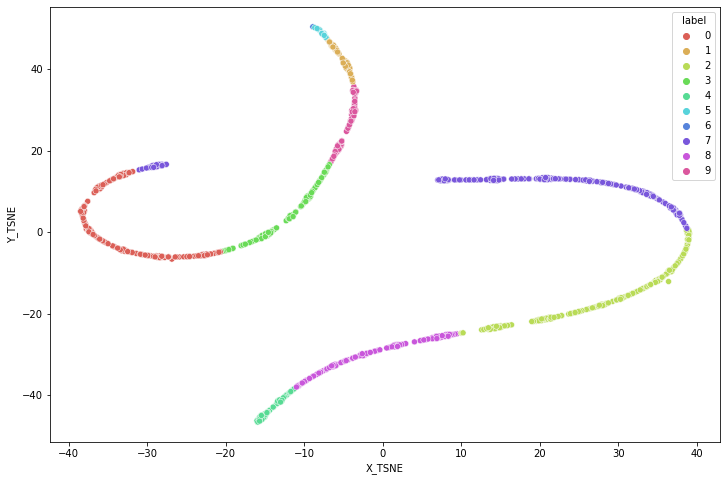

In [318]:
plt.figure(figsize = (12 ,8))
plt.title('')
sns.scatterplot(x = df_final['X_TSNE'], y = df_final['Y_TSNE'], hue = df_final['label'], palette = palette_sns, legend ='full')
plt.show()

### XI.1.Graphe intéractif 

In [ ]:
palette[len(liste_categories)]

In [319]:
#create ColumnDataSource from dataframe
source = ColumnDataSource(df_final)
# allows visualisation in notebook
output_notebook(INLINE)




# add plot
p = figure(
    title='Représentation de la catégorisation du jeu de données après traitement',
    #tools='',
    x_axis_label = 'TSNE X axis',
    y_axis_label = 'TSNE Y axis',
    plot_width=1400, 
    plot_height=800
)


colors = {}
for label, color in zip(df_final['label_string'].unique().tolist(), palette[len(liste_categories)]):
    colors[label] = color
    
color_map = CategoricalColorMapper(factors = list(colors.keys()),palette=palette[len(liste_categories)])

# render glyph
p.scatter(x='X_TSNE',
          y='Y_TSNE',
          legend_label='label_string',
          line_color = None,
          #fill_color= colors,
          #fill_color = colors,
          color = {'field': 'label_string', 'transform': color_map},
          source=source,
          size='price_as_size',
          line_width = 2,
)
        

# add text
if False:
    labels = LabelSet(x='X_TSNE', y='Y_TSNE', text='label', level='glyph',text_font_size='7pt',
                      x_offset=5, y_offset=5, source=source, render_mode='canvas')
    p.add_layout(labels)

#add tooltips
hover = HoverTool()
hover.tooltips = """
    <div>
        <div><b>@product_name</b></div>
        <div><b>@cat_lvl_2</b></div>
        </div>Kmeans Category : @label_string</div> 
        <div><img src="data/Resized_Images/@image", alt='categorie' /></div>
    </div>"""
p.add_tools(hover)
show(p)

Loading BokehJS ...

In [320]:
show(p)